# Mission 1 : Etudier la faisabilité d'un moteur de classification d'articles

# Etape 1 : Étude de faisabilité NLP basique

- Réalisez au préalable un prétraitement de vos textes : nettoyage, stemming, lemmatization etc. 
- Utilisez des méthodes basiques d’encodage de texte (Bag of Words, TfIdf etc.)
- Utilisez des méthodes de réduction de dimension sur le texte encodé et comparer les résultats avec les catégories réelles

Objectif : Tester si les descriptions textuelles suffisent à regrouper les articles de même catégorie.

In [1]:
import scipy
print(scipy.__version__)

1.9.3


In [2]:
conda install scipy=1.9.3

Channels:
 - defaults
Platform: osx-arm64
Solving environment: done

# All requested packages already installed.


Note: you may need to restart the kernel to use updated packages.


In [3]:
import scipy
print(scipy.__version__)

1.9.3


In [4]:
# === Data Handling ===
import pandas as pd
import numpy as np
import pickle
import os
import time
import math

# === Visualization ===
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
from wordcloud import WordCloud, STOPWORDS
from PIL import Image

# === Image Processing ===
import cv2
import glob

# === Text Preprocessing ===
import re
import string
from string import punctuation
from collections import Counter

# === NLP - NLTK ===
import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

from nltk.tokenize import sent_tokenize, word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk import FreqDist

# === Feature Extraction ===
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, ENGLISH_STOP_WORDS
from sklearn.preprocessing import LabelEncoder

# === Clustering & Dimensionality Reduction ===
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score, confusion_matrix

# === Deep Learning & Embeddings ===
import torch
import tensorflow as tf
import tensorflow_hub as hub
from gensim.models import Word2Vec
from transformers import AutoTokenizer, AutoModel, BertTokenizer, BertModel

# === Notebook Utilities ===
import nbimporter

# === Pipelines CNN : comparaison de plusieurs prétraitements ===

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
# ...existing code...
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
# ...existing code...from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.preprocessing import LabelEncoder

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

import cv2
import numpy as np
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array
from PIL import Image
from sklearn.cluster import MiniBatchKMeans
import gc

import time
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array, array_to_img
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.preprocessing import LabelEncoder


[nltk_data] Downloading package punkt to
[nltk_data]     /Users/jadesuchaud/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/jadesuchaud/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/jadesuchaud/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


# 1. Découverte du jeu de données
1. Chargement des données : Importer les données (CSV, Excel, base de données, etc.).
2. Inspection initiale : Afficher les premières lignes (head()), vérifier les types de colonnes, la taille, etc.
3. Gestion des valeurs manquantes : Identifier et traiter les valeurs nulles (suppression, imputation, etc.).
4. Détection des doublons : Repérer et supprimer les lignes dupliquées.
5. Analyse statistique : Décrire les variables (moyenne, médiane, écart-type, etc.).
6. Visualisation : Utiliser des graphiques pour comprendre la distribution et les relations entre variables.

In [5]:
data = pd.read_csv('flipkart_com-ecommerce_sample_1050.csv')

In [6]:
data.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [7]:
data.shape

(1050, 15)

In [8]:
data.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

# 2. Nettoyage et Exploration des données

In [10]:
data.describe()

,retail_price,discounted_price
count,1049.000000,1049.000000
mean,2186.197331,1584.527169
std,7639.229411,7475.099680
min,35.000000,35.000000
25%,555.000000,340.000000
50%,999.000000,600.000000
75%,1999.000000,1199.000000
max,201000.000000,201000.000000


In [11]:
def analyze_missing_data(df):
    """
    Affiche un graphique barres de missingno et un tableau des colonnes avec données manquantes.
    
    Paramètres :
        df (pd.DataFrame) : le DataFrame à analyser.
        
    Affiche :
        - Le graphe barres des données manquantes.
        - Un tableau trié des colonnes avec :
            - Nombre de valeurs manquantes
            - Pourcentage de données manquantes
    """
    # Affiche le graphe de missingno
    print("Affichage du graphique des données manquantes :")
    msno.bar(df)
    plt.show()

    # Calcul des données manquantes
    total_missing = df.isnull().sum()
    percent_missing = (total_missing / len(df)) * 100

    missing_data = pd.DataFrame({
        'Colonnes': total_missing.index,
        'Valeurs Manquantes': total_missing.values,
        'Pourcentage (%)': percent_missing.values
    })

    # On garde seulement les colonnes avec au moins une valeur manquante
    missing_data = missing_data[missing_data['Valeurs Manquantes'] > 0]

    # Tri décroissant par % de valeurs manquantes
    missing_data = missing_data.sort_values(by='Pourcentage (%)', ascending=False)

    # Affichage du tableau
    print("\nRésumé des données manquantes :")
    print(missing_data.to_string(index=False))

Affichage du graphique des données manquantes :


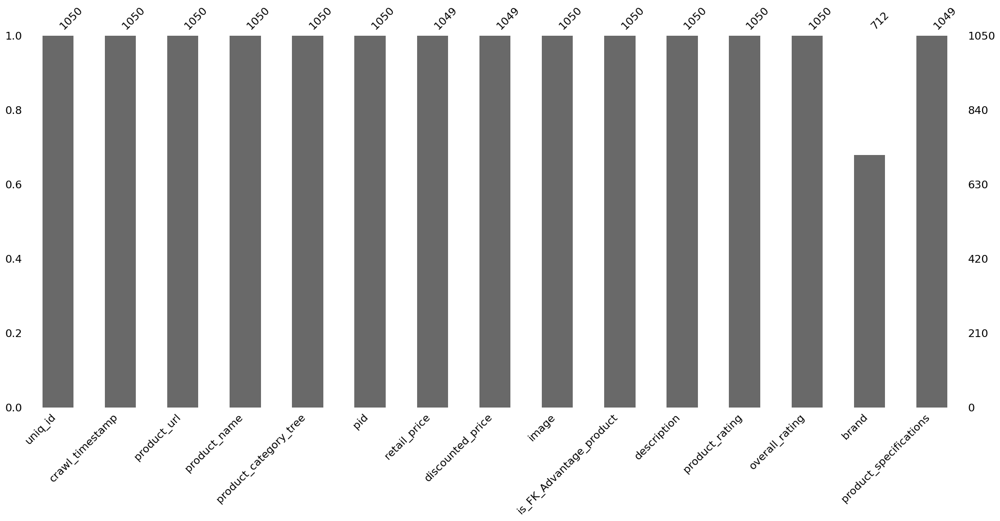


Résumé des données manquantes :
              Colonnes  Valeurs Manquantes  Pourcentage (%)
                 brand                 338        32.190476
          retail_price                   1         0.095238
      discounted_price                   1         0.095238
product_specifications                   1         0.095238


In [12]:
analyze_missing_data(data)

La plupart des valeurs manquantes se situent dans la variable 'brand'. Il y en a également 1 dans chacune des variables suivantes : 'retail_price', 'discounted_price', et 'product_specifications'.

Nous allons vérifier si nous avons des lignes dupliquées : 

In [13]:
print("Nombre de commandes dupliquées : ", data[data.duplicated()].shape[0])
data[data.duplicated(keep=False)]

Nombre de commandes dupliquées :  0


,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications


In [14]:
data.sample(1).T  # Affiche 1 ligne transposée pour lisibilité

,15
uniq_id,1120bc768623572513df956172ffefeb
crawl_timestamp,2015-12-04 07:25:36 +0000
product_url,http://www.flipkart.com/escort-e-1700-906-blk-...
product_name,"Escort E-1700-906_Blk Analog Watch - For Men,..."
product_category_tree,"[""Watches >> Wrist Watches >> Escort Wrist Wat..."
pid,WATECDDDQ7SFDD6K
retail_price,1925.0
discounted_price,1829.0
image,1120bc768623572513df956172ffefeb.jpg
is_FK_Advantage_product,False


In [15]:
# Y a-t-il des doublons ?
print("Nombre de doublons (uniq_id) :", data.duplicated(subset="uniq_id").sum())

Nombre de doublons (uniq_id) : 0


In [16]:
data[['product_category_tree']]

,product_category_tree
0,"[""Home Furnishing >> Curtains & Accessories >>..."
1,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T..."
2,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T..."
3,"[""Home Furnishing >> Bed Linen >> Bedsheets >>..."
4,"[""Home Furnishing >> Bed Linen >> Bedsheets >>..."
...,...
1045,"[""Baby Care >> Baby & Kids Gifts >> Stickers >..."
1046,"[""Baby Care >> Baby & Kids Gifts >> Stickers >..."
1047,"[""Baby Care >> Baby & Kids Gifts >> Stickers >..."
1048,"[""Baby Care >> Baby & Kids Gifts >> Stickers >..."


In [17]:
# Source, volume, structure
print("Source : flipkart_com-ecommerce_sample_1050.csv")
data = pd.read_csv('flipkart_com-ecommerce_sample_1050.csv')
print(f"Nombre de lignes : {data.shape[0]}")
print(f"Nombre de colonnes : {data.shape[1]}")
print("Colonnes principales :", list(data.columns))

Source : flipkart_com-ecommerce_sample_1050.csv
Nombre de lignes : 1050
Nombre de colonnes : 15
Colonnes principales : ['uniq_id', 'crawl_timestamp', 'product_url', 'product_name', 'product_category_tree', 'pid', 'retail_price', 'discounted_price', 'image', 'is_FK_Advantage_product', 'description', 'product_rating', 'overall_rating', 'brand', 'product_specifications']


## 2.1 Nettoyage léger des colonnes clés

Transformer product_category_tree en une colonne exploitable (extraction du label principal).

### 2.1.1 Extraire la catégorie principale

On a remarqué que product_category_tree contient ce genre de chaîne :

`["Home Decor & Festive Needs >> Table Decor & Handicrafts >> Showpieces"]` 

On va :

Nettoyer la chaîne (enlever [", "])

Ne garder que la première sous-catégorie (niveau 0), ici : "Home Decor & Festive Needs"

In [18]:
# Nettoyage de la catégorie principale
data["main_category"] = data["product_category_tree"].str.extract(r'\["([^>]+)')

# Aperçu des catégories principales
data["main_category"].value_counts().head(10)

main_category
Home Furnishing                150
Baby Care                      150
Watches                        150
Home Decor & Festive Needs     150
Kitchen & Dining               150
Beauty and Personal Care       150
Computers                      150
Name: count, dtype: int64

### 2.1.2 Les descriptions 

Voir si certaines catégories ont des descriptions plus longues (→ info sur richesse sémantique)

In [19]:
# Longueur de la description
data["desc_length"] = data["description"].apply(lambda x: len(str(x).split()))

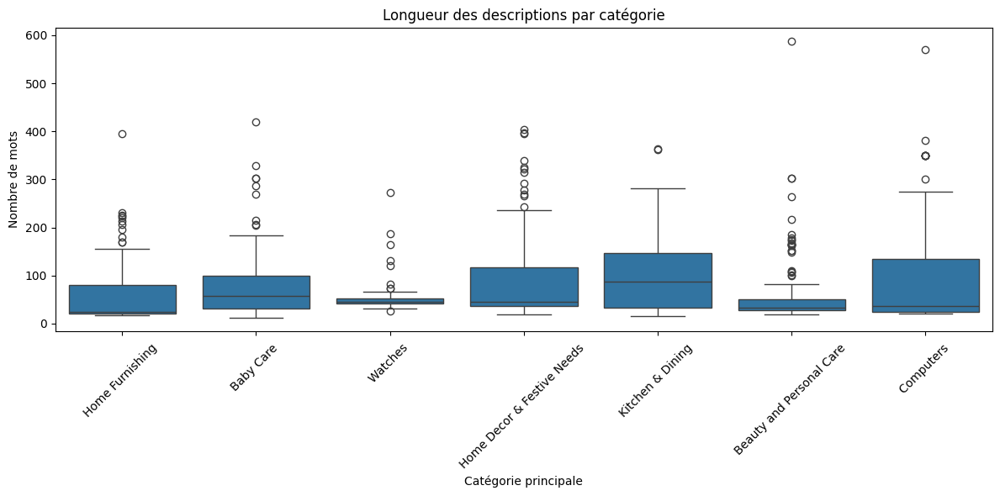

In [20]:
# Boxplot par catégorie
plt.figure(figsize=(12, 6))
sns.boxplot(data=data, x="main_category", y="desc_length")
plt.xticks(rotation=45)
plt.title("Longueur des descriptions par catégorie")
plt.ylabel("Nombre de mots")
plt.xlabel("Catégorie principale")
plt.tight_layout()
plt.show()

### 2.1.3 Nuages de mots par catégorie

Voir les mots les plus fréquents dans les descriptions, par catégorie.

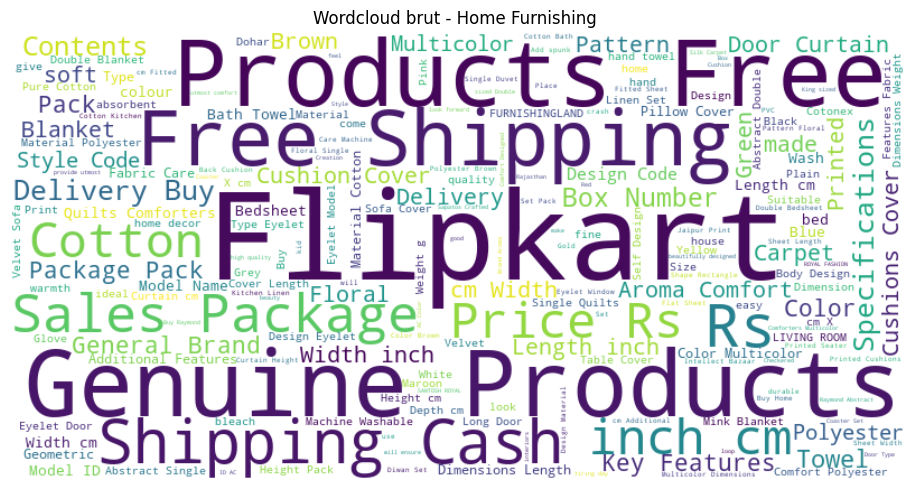

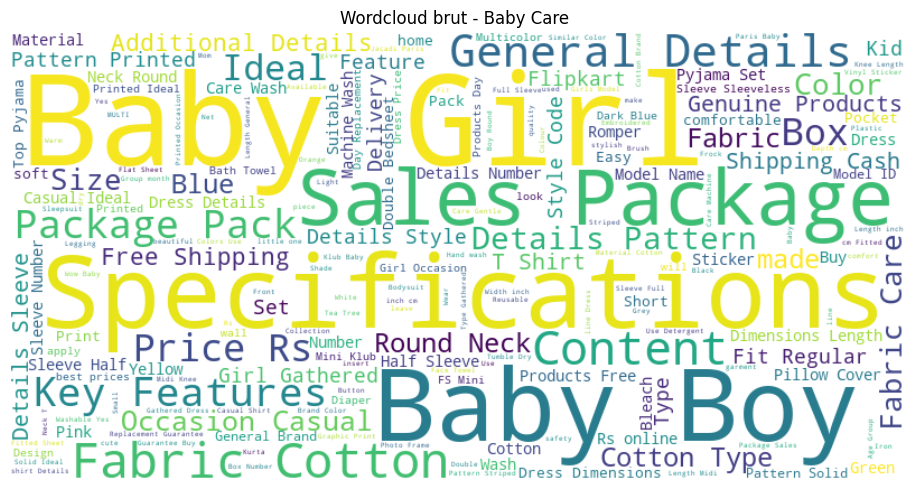

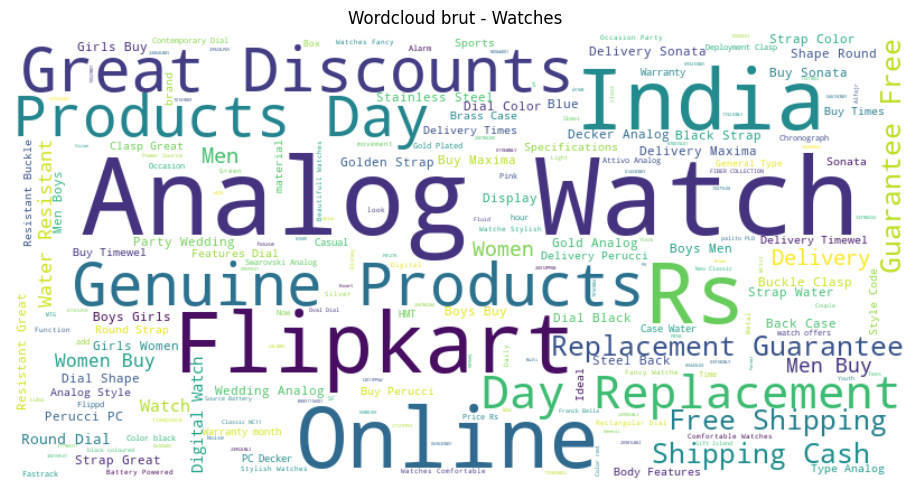

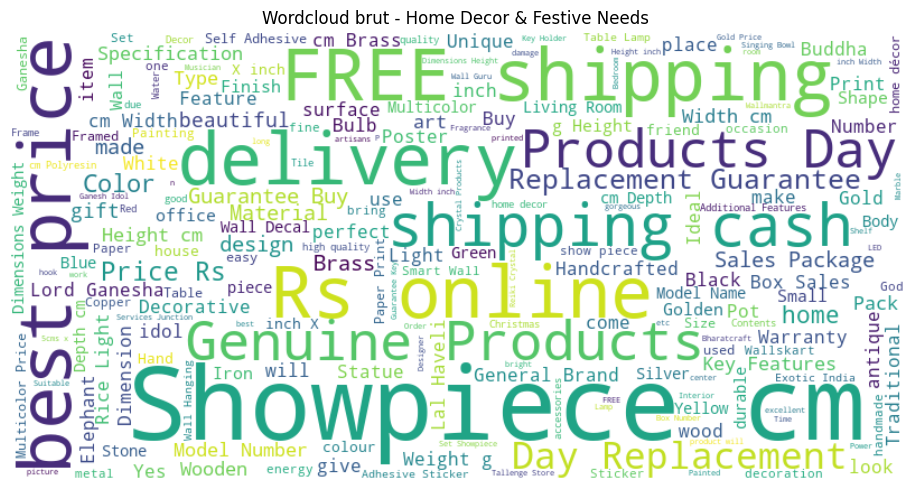

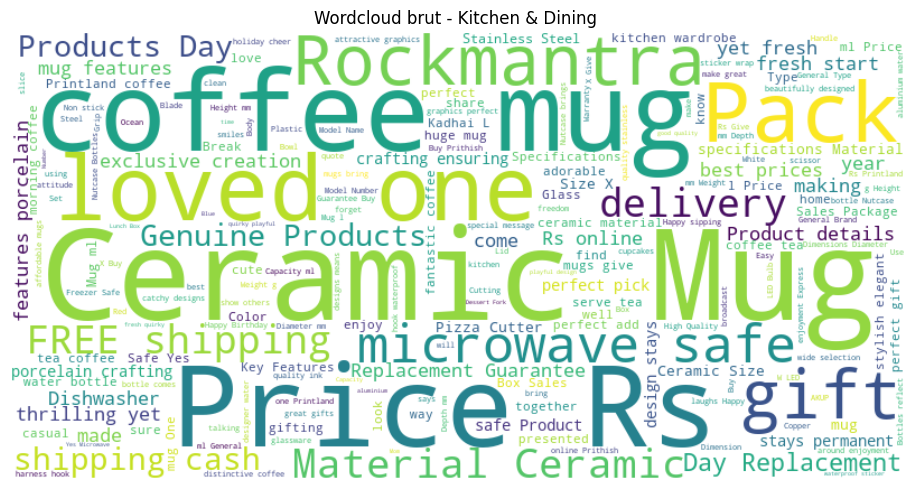

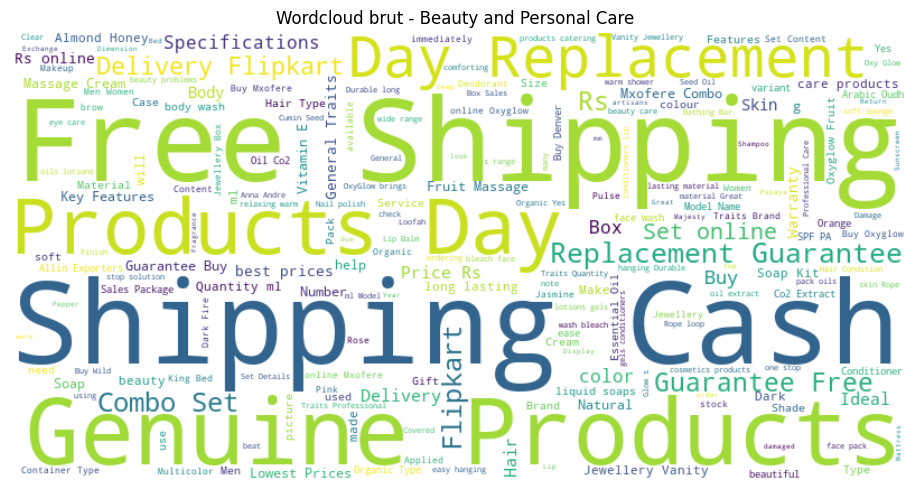

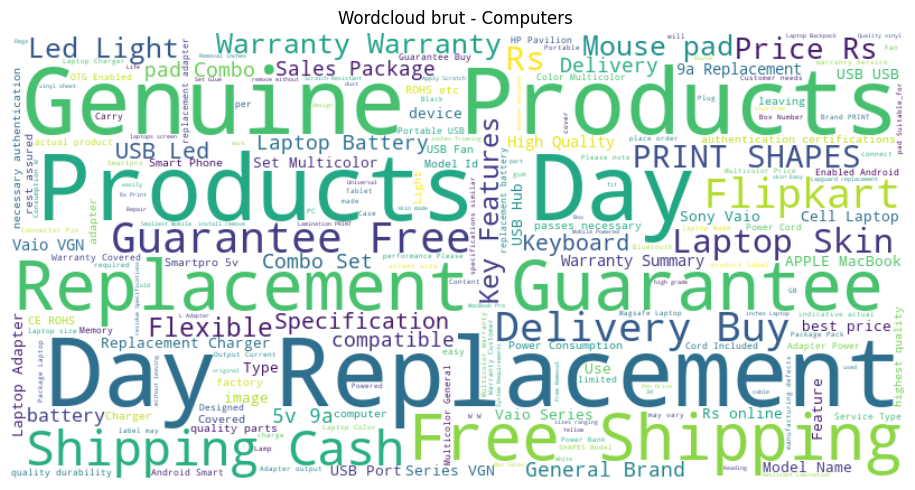

In [21]:
# S'assurer qu'il n'y a pas de NaN dans la colonne "description"
data = data.dropna(subset=["description"])

# Lister les catégories uniques
categories = data["main_category"].unique()

# Boucle sur chaque catégorie
for cat in categories:
    # Filtrer les descriptions de la catégorie, convertir en texte brut
    descriptions = data[data["main_category"] == cat]["description"].astype(str)
    text_cat = " ".join(descriptions)
    
    if not text_cat.strip():  # Skip si aucun texte à afficher
        print(f"Aucune description pour la catégorie : {cat}")
        continue

    # Générer le nuage de mots brut (sans suppression des stopwords)
    wordcloud = WordCloud(
        width=800,
        height=400,
        background_color='white'
    ).generate(text_cat)

    # Affichage du nuage
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Wordcloud brut - {cat}")
    plt.tight_layout()
    plt.show()

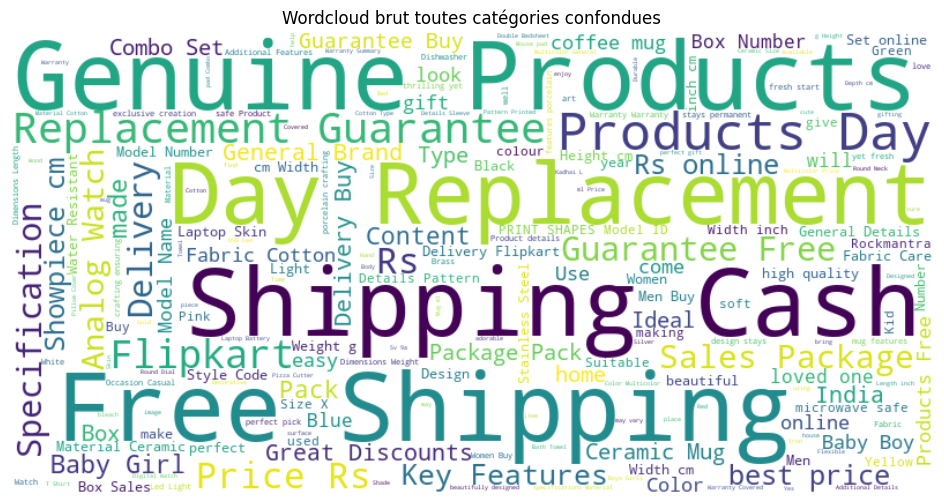

In [22]:
# Concaténer toutes les descriptions, toutes catégories confondues
text_all = " ".join(data["description"].dropna().astype(str))

# Générer le WordCloud brut
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text_all)

# Afficher
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.title("Wordcloud brut toutes catégories confondues")
plt.show()

### 2.1.4 Marques et produits par catégorie

In [23]:
# Top marques par catégorie
top_brands = data.groupby("main_category")["brand"].value_counts().groupby(level=0).head(3)

print(top_brands)

main_category                brand          
Baby Care                    FS Mini Klub        5
                             Offspring           4
                             Wallmantra          4
Beauty and Personal Care     AntiqueShop         3
                             RYTHMX              3
                             Allin Exporters     2
Computers                    Lapguard           11
                             PRINT SHAPES       11
                             Smartpro            7
Home Decor & Festive Needs   Lal Haveli         10
                             Exotic India        5
                             Digilight           3
Home Furnishing              Aroma Comfort       8
                             Raymond             8
                             Home Originals      6
Kitchen & Dining             AKUP                5
                             Metallino           3
                             Kalash              2
Watches                      palito  

Résultats : 

- Certaines marques sont clairement spécifiques à une catégorie.
- Dans Baby Care, les marques sont plus variées et en plus petit nombre d’occurrences → catégories plus larges ou moins dominées par une marque.

In [24]:
# Ex de noms de produit par catégorie
for cat in categories:
    print(f"\n{cat} :")
    print(data[data["main_category"] == cat]["product_name"].dropna().sample(5, random_state=42).to_list())


Home Furnishing  :
['Buy Clues Abstract Single Quilts & Comforters Gold', 'Quilt India Floral Cushions Cover', 'Nagar Handloom Floral Double Quilts & Comforters Multicolor', 'Raymond Abstract Double Blanket Grey', 'Rajrang Animal Cushions Cover']

Baby Care  :
["Seals Baby Girl's A-line Dress", "Earth Conscious Graphic Print Baby Boy's Jumpsuit", "612 League Baby Boy's Checkered Casual Shirt", 'Wood Beauty Wood Photo Frame', 'Marvel Cotton Bath Towel']

Watches  :
['Maxima 01784BMLY Gold Analog Watch  - For Women', 'Skmei DG0939-Red Sports Digital Watch  - For Men, Boys', 'Flippd FD040149 Casual Analog Watch  - For Women, Girls', 'Maxima 01741LPLN Analog Watch  - For Women', 'Times 109B0109 Sports Analog Watch  - For Boys']

Home Decor & Festive Needs  :
['Brahmz Glass Mossiac Table Lamp', 'Exotic India Lord Ganesha (Carved in Hematite) Showpiece  -  5.08 cm', 'Bourne Supermacy Canvas Art', 'Pg handicrafts Beaded two drawers sofa set showpiece Showpiece  -  10.5 cm', 'NEHP NEH0012 Sho

**Extraire les mots fréquents par catégorie avec CountVectorizer**

In [25]:
# Sélectionner les catégories 
categories = data['main_category'].unique()

# Initialiser CountVectorizer avec nettoyage minimal
vectorizer = CountVectorizer(stop_words='english', max_features=1000)  # max_features limite le vocabulaire

# Créer un dataframe pour stocker les mots fréquents par catégorie
freq_words_cat = pd.DataFrame()

for cat in categories:
    # Extraire descriptions pour cette catégorie
    texts = data.loc[data['main_category'] == cat, 'description'].dropna().values

    # Appliquer CountVectorizer (fit_transform attend une liste de documents)
    X = vectorizer.fit_transform(texts)
    
    # Somme des occurrences des mots dans cette catégorie
    word_counts = X.sum(axis=0).A1
    words = vectorizer.get_feature_names_out()
    
    # Mettre dans un DataFrame
    df = pd.DataFrame({'word': words, 'count': word_counts})
    df = df.sort_values(by='count', ascending=False).head(10)  # Top 10 mots
    
    df['category'] = cat
    
    freq_words_cat = pd.concat([freq_words_cat, df], axis=0)

print(freq_words_cat)

        word  count          category
298       cm    188  Home Furnishing 
791       rs    128  Home Furnishing 
327   cotton    103  Home Furnishing 
689     pack     88  Home Furnishing 
329    cover     84  Home Furnishing 
..       ...    ...               ...
162  adapter    116        Computers 
415     free    112        Computers 
208  battery    106        Computers 
680    power    101        Computers 
339      day     96        Computers 

[70 rows x 3 columns]


/var/folders/f1/6tjqbrdd3vz74bz9bkl_0bjh0000gn/T/ipykernel_27924/3107392779.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='word', y='count', data=df_top, palette="viridis")


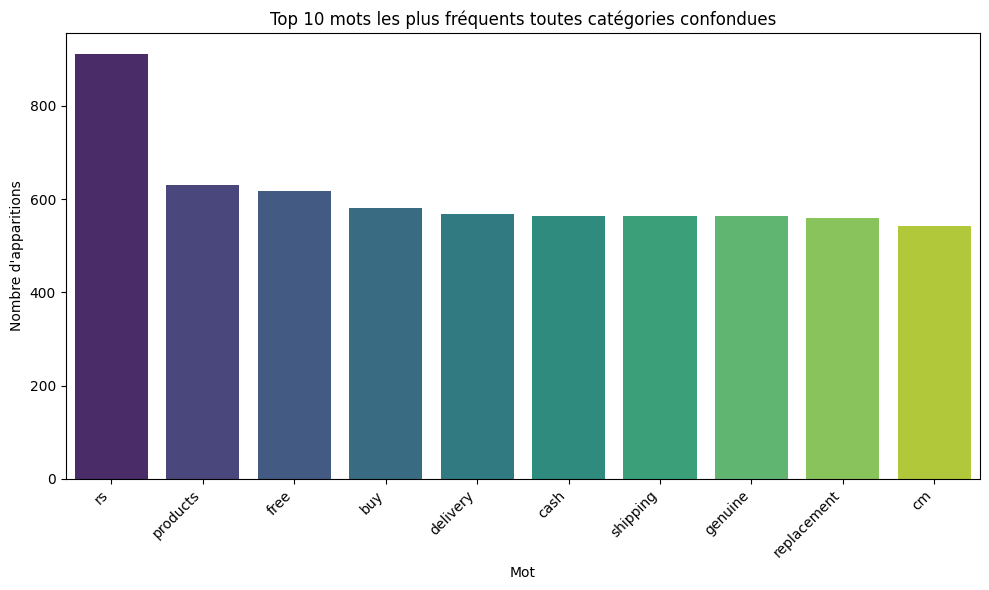

In [26]:
top_n = 10

# Rassembler toutes les descriptions en un seul corpus
texts = data["description"].dropna().astype(str).values

# Vectoriser avec suppression des stopwords anglais
vectorizer = CountVectorizer(stop_words='english', max_features=1000)
X = vectorizer.fit_transform(texts)

# Compter les mots
word_counts = X.sum(axis=0).A1
words = vectorizer.get_feature_names_out()

# Créer un DataFrame pour les fréquences
df_counts = pd.DataFrame({'word': words, 'count': word_counts})
df_top = df_counts.sort_values(by='count', ascending=False).head(top_n)

# Tracer un barplot
plt.figure(figsize=(10, 6))
sns.barplot(x='word', y='count', data=df_top, palette="viridis")

plt.title(f"Top {top_n} mots les plus fréquents toutes catégories confondues")
plt.ylabel("Nombre d'apparitions")
plt.xlabel("Mot")
plt.xticks(rotation=45, ha='right')

plt.tight_layout()
plt.show()


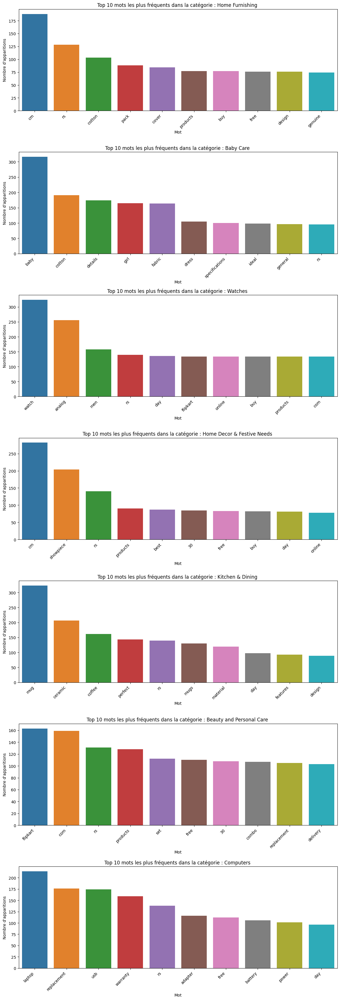

In [27]:
top_n = 10
fig, axes = plt.subplots(len(categories), 1, figsize=(12, 5 * len(categories)))

vectorizer = CountVectorizer(stop_words='english', max_features=1000)

for i, cat in enumerate(categories):
    ax = axes[i]
    texts = data.loc[data['main_category'] == cat, 'description'].dropna().values
    X = vectorizer.fit_transform(texts)
    word_counts = X.sum(axis=0).A1
    words = vectorizer.get_feature_names_out()
    
    df_counts = pd.DataFrame({'word': words, 'count': word_counts})
    df_top = df_counts.sort_values(by='count', ascending=False).head(top_n)
    
    # Ici on enlève 'palette' ou on assigne 'hue' à 'word' pour éviter warning
    sns.barplot(x='word', y='count', data=df_top, ax=ax, hue='word', dodge=False, legend=False)
    
    ax.set_title(f"Top {top_n} mots les plus fréquents dans la catégorie : {cat}")
    ax.set_ylabel("Nombre d'apparitions")
    ax.set_xlabel("Mot")
    
    # Rotation des labels : utilise set_xticks avant set_xticklabels
    ax.set_xticks(range(len(df_top)))
    ax.set_xticklabels(df_top['word'], rotation=45, ha='right')

plt.tight_layout()
plt.show()

**Interprétation rapide des mots fréquents** : 

Pour Home Furnishing, des mots comme cm, cotton, pack montrent bien qu’on parle d’articles textiles ou dimensions (cm = centimètres).

Pour Computers, adapter, battery, power sont très cohérents avec la catégorie (électronique).

Le mot rs (probablement la monnaie indienne "Rupees") apparaît aussi souvent — cela peut biaiser les résultats car ce n’est pas un mot “sémantique” produit.

**Pistes d'amélioration :**

- Filtrer les mots non-informatifs comme cm, rs, day, free avec une liste de stopwords personnalisée.
- Regarder les mots clés uniques ou très discriminants par catégorie, par ex. en calculant la fréquence relative dans une catégorie par rapport à l’ensemble.

**Analyse d’occurrence d’un mot spécifique par catégorie**

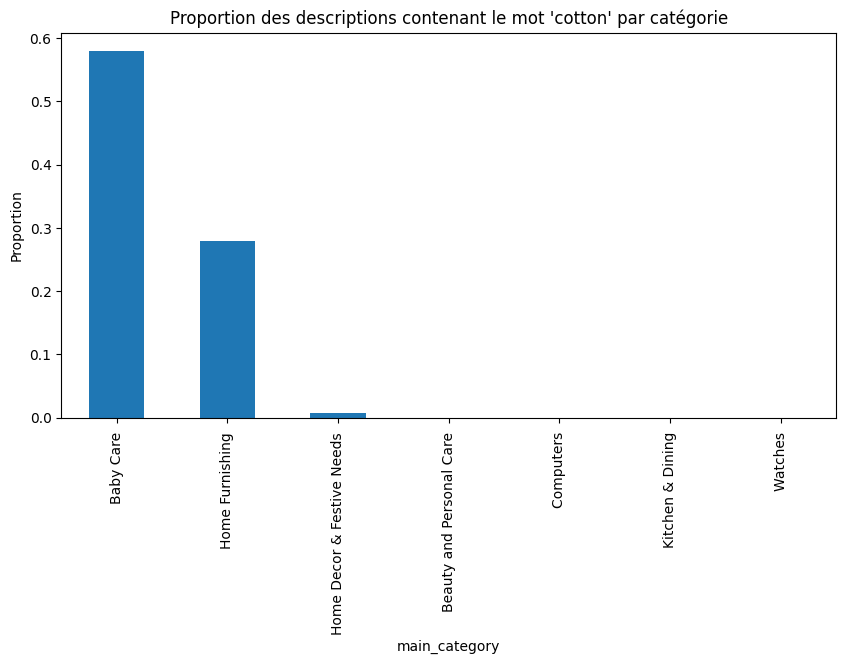

In [28]:
data['contains_cotton'] = data['description'].str.contains('cotton', case=False, na=False)

freq_cotton = data.groupby('main_category')['contains_cotton'].mean().sort_values(ascending=False)

freq_cotton.plot(kind='bar', figsize=(10,5))
plt.title("Proportion des descriptions contenant le mot 'cotton' par catégorie")
plt.ylabel('Proportion')
plt.show()

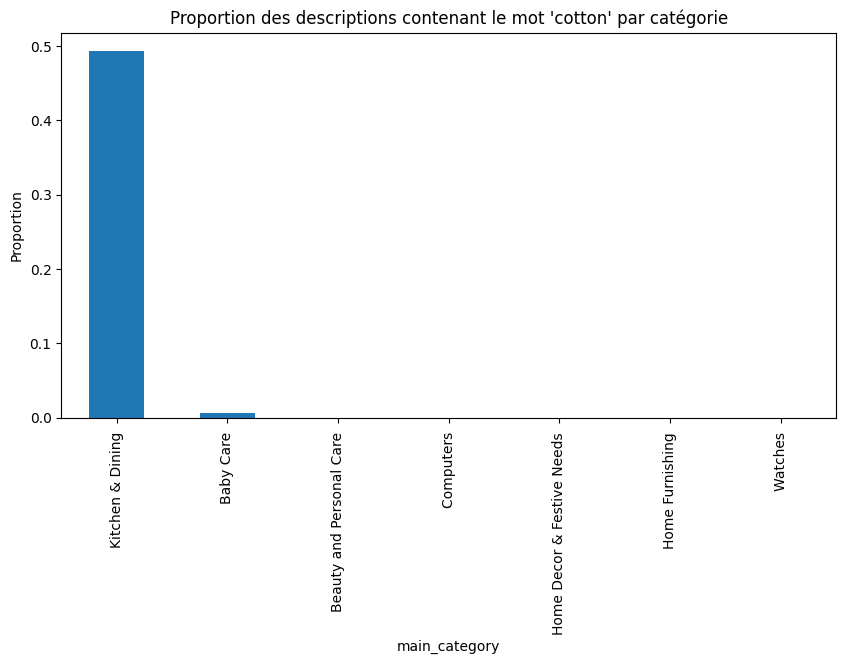

In [29]:
data['contains_cotton'] = data['description'].str.contains('mug', case=False, na=False)

freq_cotton = data.groupby('main_category')['contains_cotton'].mean().sort_values(ascending=False)

freq_cotton.plot(kind='bar', figsize=(10,5))
plt.title("Proportion des descriptions contenant le mot 'cotton' par catégorie")
plt.ylabel('Proportion')
plt.show()

**Visualiser la répartition par catégorie des mots les plus utilisés au total : (sans stopwords)**

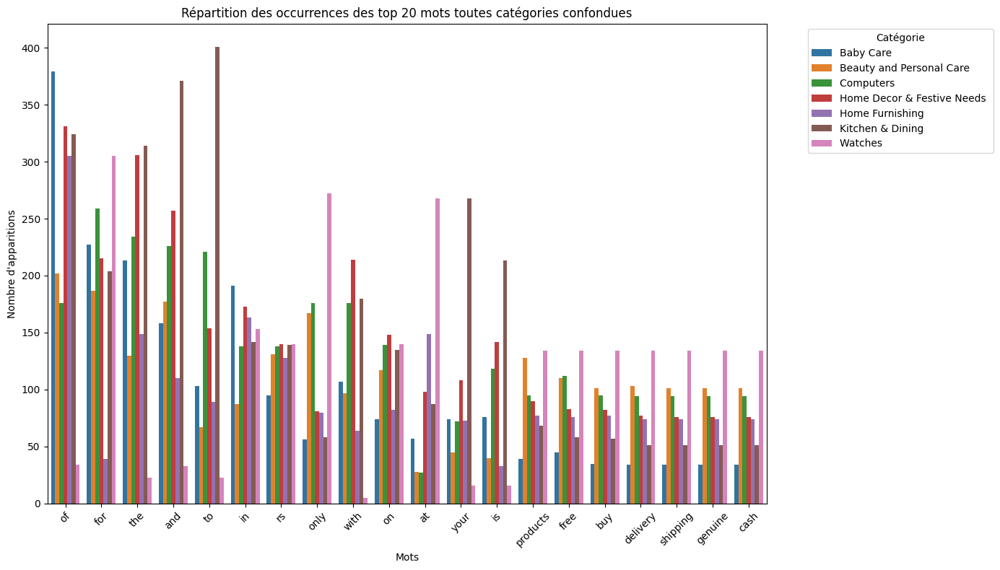

In [30]:
texts = data['description'].fillna('').values
categories = data['main_category'].values

vectorizer = CountVectorizer(max_features=1000)
X = vectorizer.fit_transform(texts)
words = vectorizer.get_feature_names_out()

df_counts = pd.DataFrame(X.toarray(), columns=words)
df_counts['category'] = categories

# Somme totale des occurrences par mot (toutes catégories confondues)
total_word_counts = df_counts.drop(columns=['category']).sum().sort_values(ascending=False)

# Prendre les top N mots globaux (par exemple 10)
top_n = 20
top_words = total_word_counts.head(top_n).index.tolist()

# Extraire les occurrences par catégorie uniquement pour ces mots
word_category_counts = df_counts.groupby('category')[top_words].sum().reset_index()

# Transformer en format "long" pour seaborn
df_plot = word_category_counts.melt(id_vars='category', var_name='word', value_name='count')

plt.figure(figsize=(14, 8))
sns.barplot(data=df_plot, x='word', y='count', hue='category')

plt.title(f"Répartition des occurrences des top {top_n} mots toutes catégories confondues")
plt.ylabel("Nombre d'apparitions")
plt.xlabel("Mots")
plt.legend(title='Catégorie', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

**Visualiser la répartition par catégorie des mots les plus utilisés au total : (avec stopwords)**

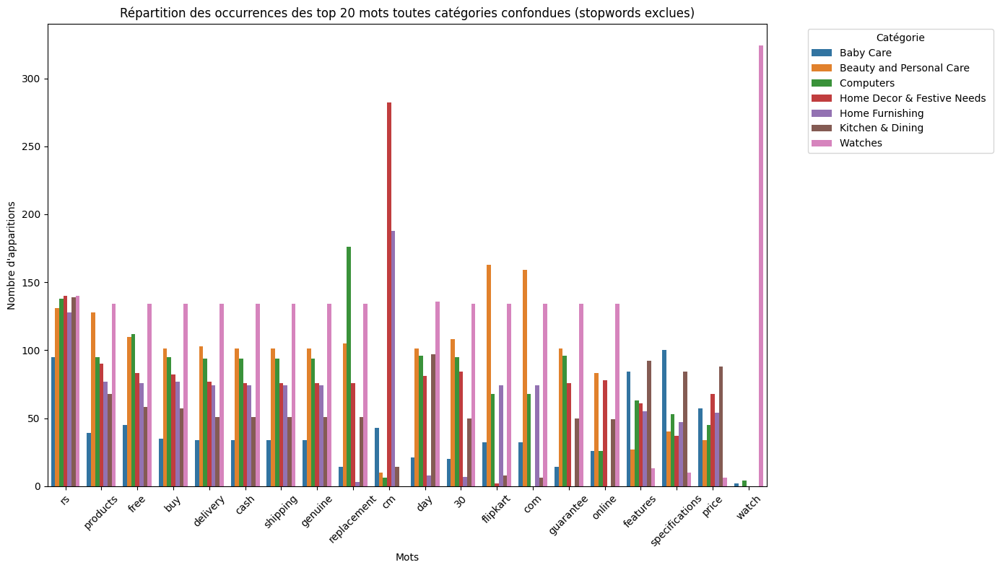

In [31]:
texts = data['description'].fillna('').values
categories = data['main_category'].values

vectorizer = CountVectorizer(max_features=1000, stop_words='english')  # <-- stop_words ici
X = vectorizer.fit_transform(texts)
words = vectorizer.get_feature_names_out()

df_counts = pd.DataFrame(X.toarray(), columns=words)
df_counts['category'] = categories

# Somme totale des occurrences par mot (toutes catégories confondues)
total_word_counts = df_counts.drop(columns=['category']).sum().sort_values(ascending=False)

# Prendre les top N mots globaux (par exemple 20)
top_n = 20
top_words = total_word_counts.head(top_n).index.tolist()

# Extraire les occurrences par catégorie uniquement pour ces mots
word_category_counts = df_counts.groupby('category')[top_words].sum().reset_index()

# Transformer en format "long" pour seaborn
df_plot = word_category_counts.melt(id_vars='category', var_name='word', value_name='count')

plt.figure(figsize=(14, 8))
sns.barplot(data=df_plot, x='word', y='count', hue='category')

plt.title(f"Répartition des occurrences des top {top_n} mots toutes catégories confondues (stopwords exclues)")
plt.ylabel("Nombre d'apparitions")
plt.xlabel("Mots")
plt.legend(title='Catégorie', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [32]:
# Nb apparition mot dans description = vérifier cb de fois (cb mot apparait la catégorie OU dans cb de produits le mot apparait)
# checker = pas la même info

In [33]:
print(data['main_category'].unique())

['Home Furnishing ' 'Baby Care ' 'Watches ' 'Home Decor & Festive Needs '
 'Kitchen & Dining ' 'Beauty and Personal Care ' 'Computers ']


On va supprimer les espaces dans nos catégories : 

In [34]:
data['main_category'] = data['main_category'].str.strip()


Nombre de catégories : 7
Liste des catégories : ['Home Furnishing' 'Baby Care' 'Watches' 'Home Decor & Festive Needs'
 'Kitchen & Dining' 'Beauty and Personal Care' 'Computers']

Distribution des catégories :
main_category
Home Furnishing               150
Baby Care                     150
Watches                       150
Home Decor & Festive Needs    150
Kitchen & Dining              150
Beauty and Personal Care      150
Computers                     150
Name: count, dtype: int64


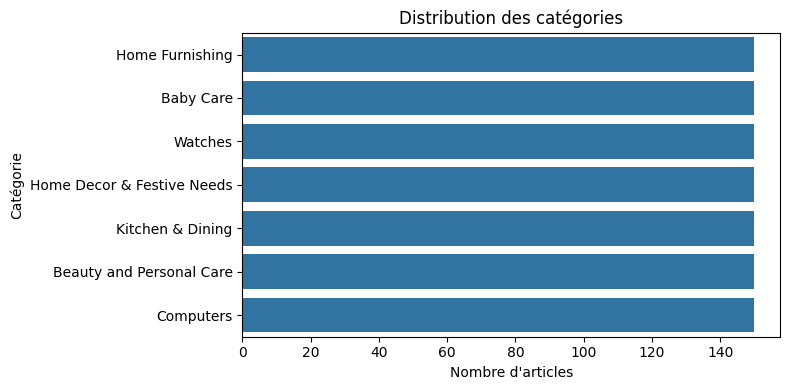

In [35]:
# Statistiques descriptives
print("\nNombre de catégories :", data['main_category'].nunique())
print("Liste des catégories :", data['main_category'].unique())
print("\nDistribution des catégories :")
print(data['main_category'].value_counts())

plt.figure(figsize=(8,4))
sns.countplot(data=data, y='main_category', order=data['main_category'].value_counts().index)
plt.title("Distribution des catégories")
plt.xlabel("Nombre d'articles")
plt.ylabel("Catégorie")
plt.tight_layout()
plt.show()

### 2.1.5 Liste de stopwords personnalisée

In [36]:
# Définir les stopwords anglais et ponctuation
stopwords_nltk = set(stopwords.words('english'))   # Liste des stopwords anglais de NLTK
stopwords_punct = set(punctuation)                 # Liste des signes de ponctuation

stop_words = set.union(stopwords_nltk, stopwords_punct)  # Union des deux sets

# Ajouter les stopwords personnalisés
custom_stopwords = {
    'cm', 'rs', 'pack', 'set', 'piece', 'pieces', 'free', 'offer', 'combo', 'day', 'inch', 'inches', 'size', 'mrp'
}
stop_words = stop_words.union(custom_stopwords)

# 3. Faisabilité classification – NLP basique

## 3.1 Prétraitement des textes

In [37]:
data[['description']]

,description
0,Key Features of Elegance Polyester Multicolor ...
1,Specifications of Sathiyas Cotton Bath Towel (...
2,Key Features of Eurospa Cotton Terry Face Towe...
3,Key Features of SANTOSH ROYAL FASHION Cotton P...
4,Key Features of Jaipur Print Cotton Floral Kin...
...,...
1045,Oren Empower Extra Large Self Adhesive Sticker...
1046,Wallmantra Large Vinyl Sticker Sticker (Pack o...
1047,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...
1048,Buy Wallmantra Medium Vinyl Sticker Sticker fo...


In [38]:
data['description'].iloc[0]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

Nous créons une liste de stopwords à supprimer

Les stopwords sont des mots très fréquents dans une langue, qui n'apportent que peu ou pas d’information sémantique pour la plupart des tâches de traitement automatique du langage naturel (TAL/NLP).

- Exemples en anglais : the, is, at, which, on, and, a...
- Exemples en français : le, la, les, un, une, et, mais...

In [39]:
stopwords_nltk = set(stopwords.words('english'))   # Liste des stopwords anglais de NLTK
stopwords_punct = set(punctuation)                 # Liste des signes de ponctuation

stop_words = set.union(stopwords_nltk, stopwords_punct)  # Union des deux sets

In [40]:
data.shape

(1050, 18)

##### Pipeline de Prétraitement de Texte – Objectif NLP

Pour tirer un maximum d'information à partir des textes bruts, nous appliquons différentes transformations successives sur notre variable textuelle `description` 

Ces étapes permettent de nettoyer, normaliser et préparer les textes selon le type d’analyse à réaliser :

- **Mise en minuscule (lowercasing)** :
Tout le texte est converti en minuscules pour éviter que des mots comme "Soap" et "soap" soient considérés comme différents. C’est une étape standard pour homogénéiser les données textuelles.
- **Suppression des stopwords et de la ponctuation** :
Les stopwords sont des mots très fréquents qui n’apportent que peu de valeur sémantique (ex. "the", "is", "and"). Leur suppression :
    - réduit le bruit dans les données,
    - améliore la performance des modèles de NLP traditionnels (BoW, TF-IDF),
    - diminue la dimensionnalité des vecteurs.
- **Tokenisation** :
C’est le processus de découpage du texte en unités de base appelées tokens. Un token peut être un mot, un nombre ou un symbole. Cela permet de traiter chaque mot comme une entité distincte dans les étapes suivantes.
- **Lemmatisation** :
La lemmatisation réduit chaque mot à sa forme canonique (appelée lemme), en s’appuyant sur un dictionnaire linguistique.
Par exemple :
    - "running" → "run"
    - "children" → "child"
- **Stemming (racinisation)** :
Le stemming consiste à retirer les suffixes et préfixes pour ne garder que la racine du mot, sans chercher à respecter une forme grammaticale correcte.
Par exemple :
    - "connections", "connected",
    - "connecting" → "connect"

##### Variables ajoutées dans le DataFrame

Nous créons plusieurs versions prétraitées de la variable `description` afin de répondre à différents besoins selon le type de modèle utilisé.

| Colonne               | Description                                                                                   | Usage prévu |
|------------------------|-----------------------------------------------------------------------------------------------|-------------|
| `text_clean_bow`       | Texte nettoyé (minuscules, tokenisation, stopwords et ponctuation supprimés)                 | Pour BoW / TF-IDF |
| `text_clean_lem`       | `text_clean_bow` + lemmatisation (forme canonique des mots)                                   | Pour modèles classiques avec sémantique améliorée |
| `text_clean_stem`      | `text_clean_bow` + stemming (racines tronquées)                                               | Alternative rapide à la lemmatisation |
| `text_dl_ready`        | Texte simplement nettoyé (minuscules + tokenisation, stopwords conservés)                     | Pour Deep Learning (USE, BERT, etc.) |

In [41]:
# --- Fonctions de prétraitement texte ---

def tokenizer_fct(sentence):
    return word_tokenize(sentence)

def stop_word_filter_fct(list_words, stop_w):
    return [w for w in list_words if w.lower() not in stop_w and len(w) > 2 and w.isalpha()]

def lower_start_fct(list_words):
    return [w.lower() for w in list_words]

def lemma_fct(list_words):
    lemmatizer = WordNetLemmatizer()
    return [lemmatizer.lemmatize(w) for w in list_words]

def stem_fct(list_words):
    stemmer = PorterStemmer()
    return [stemmer.stem(w) for w in list_words]

def transform_text_bow(text, stop_w):
    tokens = tokenizer_fct(text)
    tokens = stop_word_filter_fct(tokens, stop_w)
    tokens = lower_start_fct(tokens)
    return ' '.join(tokens)

def transform_text_lem(text, stop_w):
    tokens = tokenizer_fct(text)
    tokens = stop_word_filter_fct(tokens, stop_w)
    tokens = lower_start_fct(tokens)
    tokens = lemma_fct(tokens)
    return ' '.join(tokens)

def transform_text_stem(text, stop_w):
    tokens = tokenizer_fct(text)
    tokens = stop_word_filter_fct(tokens, stop_w)
    tokens = lower_start_fct(tokens)
    tokens = stem_fct(tokens)
    return ' '.join(tokens)

def transform_text_dl(text):
    tokens = tokenizer_fct(text)
    tokens = lower_start_fct(tokens)
    return ' '.join(tokens)

In [42]:
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer

# À placer avant tout prétraitement texte
custom_stopwords = [
    'cm', 'rs', 'pack', 'set', 'piece', 'pieces', 'free', 'offer', 'combo', 'day', 'inch', 'inches', 'size', 'mrp'
]
stop_words = list(set(stopwords.words('english')).union(custom_stopwords))

# BOW
data['text_clean_bow'] = data['description'].apply(lambda x: transform_text_bow(x, stop_words))
data['len_clean_bow'] = data['text_clean_bow'].apply(lambda x: len(word_tokenize(x)))
print("Max length (BoW):", data['len_clean_bow'].max())

# BOW + LEMMATIZATION
data['text_clean_lem'] = data['description'].apply(lambda x: transform_text_lem(x, stop_words))
data['len_clean_lem'] = data['text_clean_lem'].apply(lambda x: len(word_tokenize(x)))
print("Max length (BoW + Lemma):", data['len_clean_lem'].max())

# BOW + STEMMING
data['text_clean_stem'] = data['description'].apply(lambda x: transform_text_stem(x, stop_words))
data['len_clean_stem'] = data['text_clean_stem'].apply(lambda x: len(word_tokenize(x)))
print("Max length (BoW + Stem):", data['len_clean_stem'].max())

# DEEP LEARNING READY (no stopword filtering)
data['text_dl_ready'] = data['description'].apply(lambda x: transform_text_dl(x))
data['len_dl_ready'] = data['text_dl_ready'].apply(lambda x: len(word_tokenize(x)))
print("Max length (DL):", data['len_dl_ready'].max())

Max length (BoW): 343
Max length (BoW + Lemma): 343
Max length (BoW + Stem): 343
Max length (DL): 640


In [43]:
data['text_clean_bow'].iloc[0]

'key features elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain height price curtain enhances look curtain made high quality polyester features eyelet style stitch metal makes room environment romantic curtain wrinkle anti shrinkage elegant home bright modernistic appeal designs surreal attention sure steal hearts contemporary eyelet valance curtains slide smoothly draw apart first thing morning welcome bright sun rays want wish good morning whole world draw close evening create special moments joyous beauty given soothing prints bring home elegant curtain softly filters light room get right amount specifications elegance polyester multicolor abstract eyelet door curtain height general brand elegance designed door type eyelet model name abstract polyester door curtain model color multicolor dimensions length box number contents sales package sales package curtains body design material polyester'

In [44]:
data['text_clean_lem'].iloc[0]

'key feature elegance polyester multicolor abstract eyelet door curtain floral curtain elegance polyester multicolor abstract eyelet door curtain height price curtain enhances look curtain made high quality polyester feature eyelet style stitch metal make room environment romantic curtain wrinkle anti shrinkage elegant home bright modernistic appeal design surreal attention sure steal heart contemporary eyelet valance curtain slide smoothly draw apart first thing morning welcome bright sun ray want wish good morning whole world draw close evening create special moment joyous beauty given soothing print bring home elegant curtain softly filter light room get right amount specification elegance polyester multicolor abstract eyelet door curtain height general brand elegance designed door type eyelet model name abstract polyester door curtain model color multicolor dimension length box number content sale package sale package curtain body design material polyester'

In [45]:
data['text_clean_stem'].iloc[0]

'key featur eleg polyest multicolor abstract eyelet door curtain floral curtain eleg polyest multicolor abstract eyelet door curtain height price curtain enhanc look curtain made high qualiti polyest featur eyelet style stitch metal make room environ romant curtain wrinkl anti shrinkag eleg home bright modernist appeal design surreal attent sure steal heart contemporari eyelet valanc curtain slide smoothli draw apart first thing morn welcom bright sun ray want wish good morn whole world draw close even creat special moment joyou beauti given sooth print bring home eleg curtain softli filter light room get right amount specif eleg polyest multicolor abstract eyelet door curtain height gener brand eleg design door type eyelet model name abstract polyest door curtain model color multicolor dimens length box number content sale packag sale packag curtain bodi design materi polyest'

In [46]:
data['text_dl_ready'].iloc[0]

'key features of elegance polyester multicolor abstract eyelet door curtain floral curtain , elegance polyester multicolor abstract eyelet door curtain ( 213 cm in height , pack of 2 ) price : rs . 899 this curtain enhances the look of the interiors.this curtain is made from 100 % high quality polyester fabric.it features an eyelet style stitch with metal ring.it makes the room environment romantic and loving.this curtain is ant- wrinkle and anti shrinkage and have elegant apparance.give your home a bright and modernistic appeal with these designs . the surreal attention is sure to steal hearts . these contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening , you create the most special moments of joyous beauty given by the soothing prints . bring home the elegant curtain that softly filters light in your room

In [47]:
data.shape

(1050, 26)

In [48]:
data.to_csv("data_text_clean.csv")

## 3.2 Analyse de cooccurrences & fréquences

### 3.2.1 Analyse des cooccurrences
- Objectif : étudier les associations entre mots consécutifs (ex : "watch", "bracelet")

In [49]:
import nltk
from nltk.tokenize import word_tokenize
from nltk.util import bigrams

# Exemple simple sur la première ligne de la colonne 'text_dl_ready' de ton dataframe 'data'
tokens = word_tokenize(data['text_dl_ready'].iloc[0])
bigrams_list = list(bigrams(tokens))

In [50]:
tokens = word_tokenize(data['text_clean_bow'].iloc[0])
list(bigrams(tokens))

[('key', 'features'),
 ('features', 'elegance'),
 ('elegance', 'polyester'),
 ('polyester', 'multicolor'),
 ('multicolor', 'abstract'),
 ('abstract', 'eyelet'),
 ('eyelet', 'door'),
 ('door', 'curtain'),
 ('curtain', 'floral'),
 ('floral', 'curtain'),
 ('curtain', 'elegance'),
 ('elegance', 'polyester'),
 ('polyester', 'multicolor'),
 ('multicolor', 'abstract'),
 ('abstract', 'eyelet'),
 ('eyelet', 'door'),
 ('door', 'curtain'),
 ('curtain', 'height'),
 ('height', 'price'),
 ('price', 'curtain'),
 ('curtain', 'enhances'),
 ('enhances', 'look'),
 ('look', 'curtain'),
 ('curtain', 'made'),
 ('made', 'high'),
 ('high', 'quality'),
 ('quality', 'polyester'),
 ('polyester', 'features'),
 ('features', 'eyelet'),
 ('eyelet', 'style'),
 ('style', 'stitch'),
 ('stitch', 'metal'),
 ('metal', 'makes'),
 ('makes', 'room'),
 ('room', 'environment'),
 ('environment', 'romantic'),
 ('romantic', 'curtain'),
 ('curtain', 'wrinkle'),
 ('wrinkle', 'anti'),
 ('anti', 'shrinkage'),
 ('shrinkage', 'elegant'

### 3.2.2 Affichage des mots les plus fréquents (global)

Text(0.5, 1.0, 'Les 20 mots les plus fréquents des descriptions')

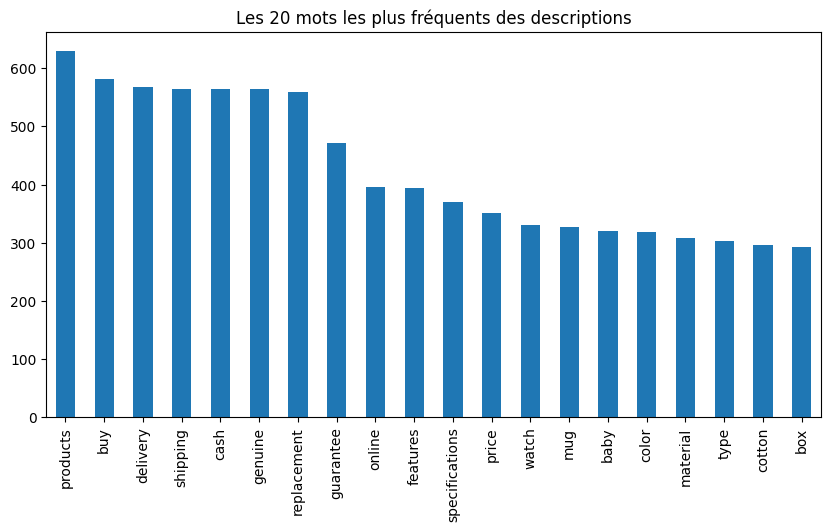

In [51]:
tokens = word_tokenize(' '.join(data['text_clean_bow'].values))
# on compte la fréquence de chaque mot 
freq_desc = pd.Series(FreqDist(tokens))

fig = plt.figure(figsize=(10,5))
freq_desc.sort_values(ascending=False)[0:20].plot.bar()
plt.title('Les 20 mots les plus fréquents des descriptions')

/var/folders/f1/6tjqbrdd3vz74bz9bkl_0bjh0000gn/T/ipykernel_27924/1065854710.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  tokens = word_tokenize(df[i])
/var/folders/f1/6tjqbrdd3vz74bz9bkl_0bjh0000gn/T/ipykernel_27924/1065854710.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  tokens = word_tokenize(df[i])
/var/folders/f1/6tjqbrdd3vz74bz9bkl_0bjh0000gn/T/ipykernel_27924/1065854710.py:4: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[

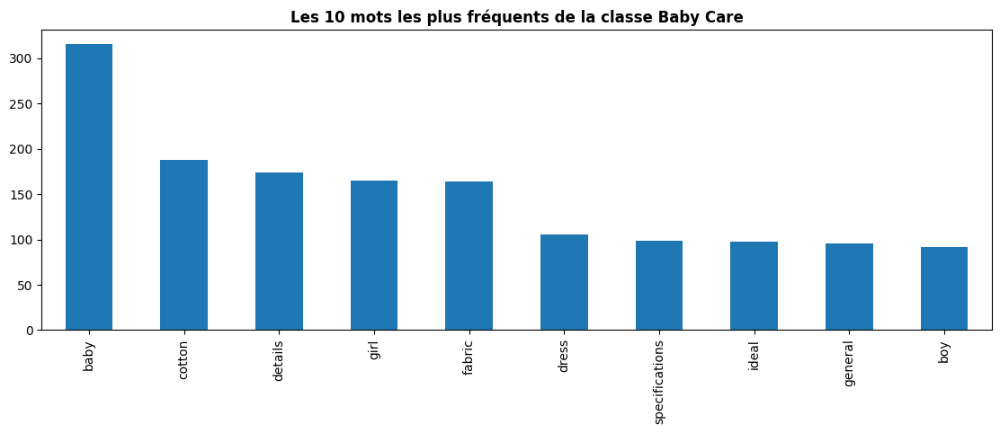

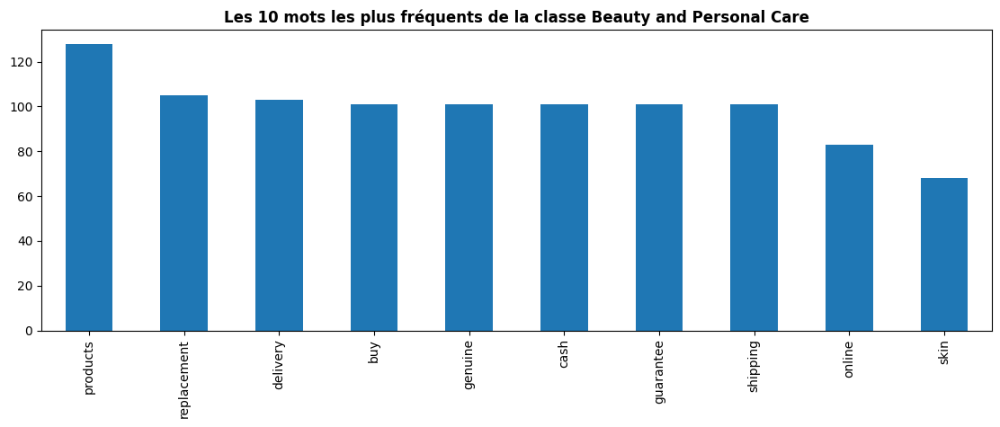

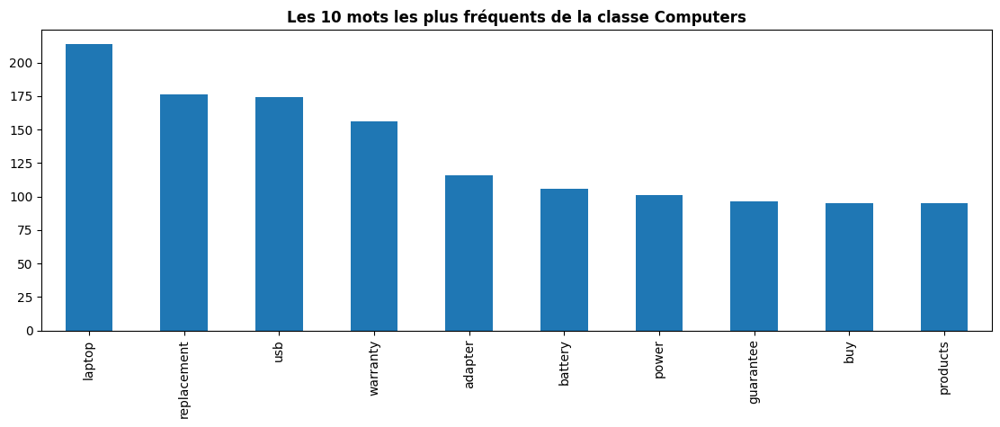

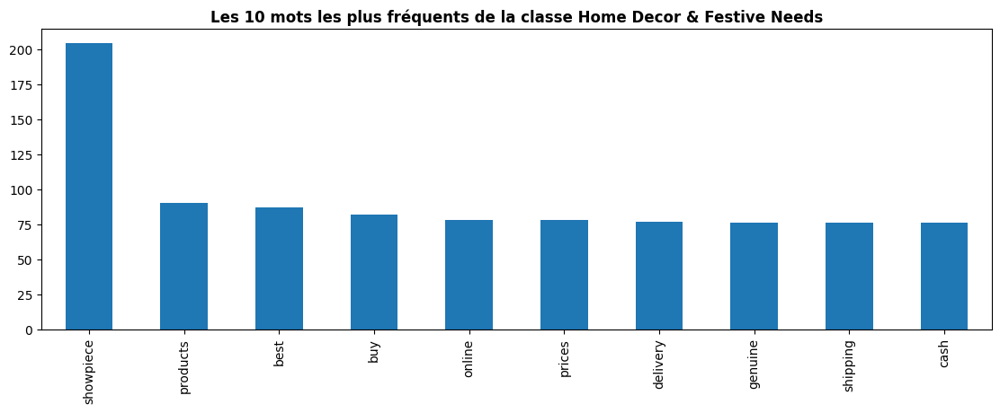

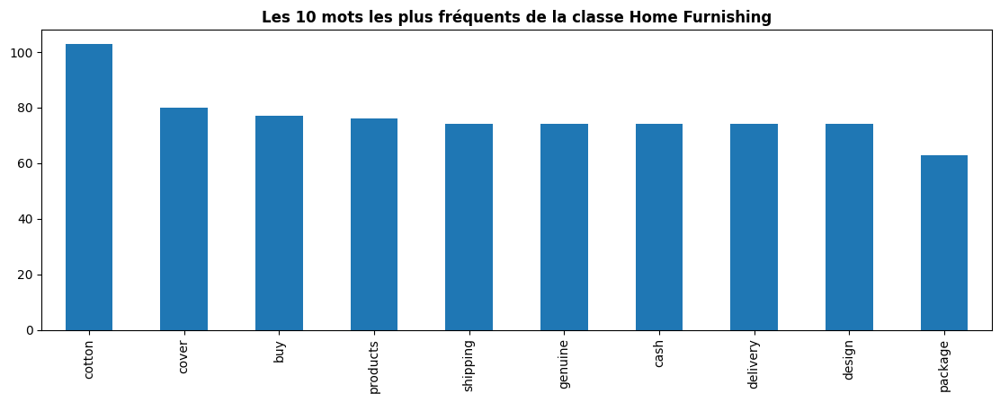

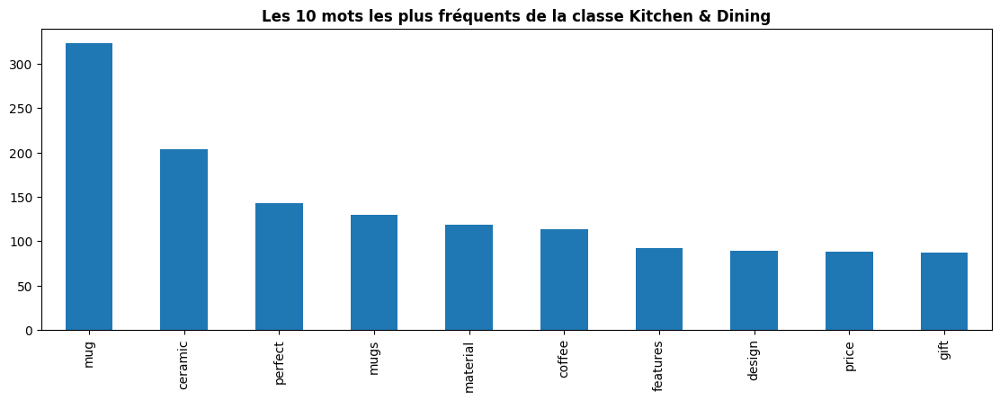

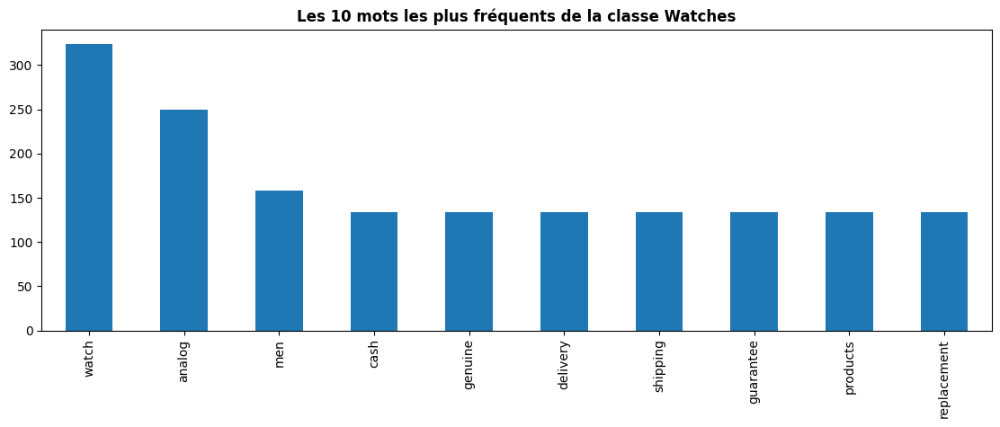

In [52]:
df = data.groupby(['main_category'])['text_clean_bow'].agg(lambda x : ' '.join(x))

for i in range(df.shape[0]):
    tokens = word_tokenize(df[i])
    # on compte la fréquence de chaque mot 
    freq_desc = pd.Series(FreqDist(tokens))

    fig = plt.figure(figsize=(30,20))
    ax = fig.add_subplot(4,2,i+1)
    freq_desc.sort_values(ascending=False)[0:10].plot.bar(ax=ax)
    ax.set_title("Les 10 mots les plus fréquents de la classe {}".format(df.index[i]), fontweight='bold')
    
plt.show()

## 3.3 Bag of Words (BoW) – Comptage simple des mots

In [53]:
data['main_category'].unique()

array(['Home Furnishing', 'Baby Care', 'Watches',
       'Home Decor & Festive Needs', 'Kitchen & Dining',
       'Beauty and Personal Care', 'Computers'], dtype=object)

In [54]:
# Définir les catégories cibles
categories = ['Baby Care', 'Beauty and Personal Care', 'Computers',
              'Home Decor & Festive Needs', 'Home Furnishing',
              'Kitchen & Dining', 'Watches']

# Colonne à vectoriser
text_col = 'text_clean_bow'

Nous utilisons les descriptions qui ont été mise en minuscule, tokenisée, dont les stopwords ont été retirés et lemmatisées. 

### 3.3.1 CountVectorizer

In [55]:
# Créer dossier pour artefacts
os.makedirs('models', exist_ok=True)

##### Entraînement du modèle CountVectorizer

In [56]:
# Stopwords anglais + personnalisés (sans ponctuation)
from nltk.corpus import stopwords

custom_stopwords = [
    'cm', 'rs', 'pack', 'set', 'piece', 'pieces', 'free', 'offer', 'combo', 'day', 'inch', 'inches', 'size', 'mrp'
]
stop_words = list(set(stopwords.words('english')).union(custom_stopwords))

In [57]:
start_bow = time.time()
vectorizer_bow = CountVectorizer(
    stop_words=stop_words,
    max_df=0.85,  # testé plus restrictif
    min_df=2      # testé pour ignorer les mots très rares
)
X_bow = vectorizer_bow.fit_transform(data['text_clean_bow'])
with open('models/vectorizer_bow.pkl', 'wb') as f:
    pickle.dump(vectorizer_bow, f)
print("Shape BoW :", X_bow.shape)

Shape BoW : (1050, 2142)


In [58]:
X_bow = vectorizer_bow.fit_transform(data['text_clean_bow'])
print("Shape BoW :", X_bow.shape)

Shape BoW : (1050, 2142)


##### Réduction de dimension et clustering

In [59]:
# PCA
pca_bow = PCA(n_components=0.99, random_state=42)
X_bow_pca = pca_bow.fit_transform(X_bow.toarray())
with open('models/pca_bow.pkl', 'wb') as f:
    pickle.dump(pca_bow, f)
print("Shape après PCA (BoW) :", X_bow_pca.shape)

Shape après PCA (BoW) : (1050, 457)


##### Clustering + t-SNE + ARI

In [60]:
def clustering_tsne(X_pca, categories, true_labels):
    le = LabelEncoder()
    y_true = le.fit_transform(true_labels)
    n_clusters = len(categories)
    tsne = TSNE(n_components=2, perplexity=30, n_iter=2000, random_state=42)
    X_tsne = tsne.fit_transform(X_pca)
    kmeans = KMeans(n_clusters=n_clusters, n_init=100, random_state=42)
    cluster_labels = kmeans.fit_predict(X_tsne)
    ari = adjusted_rand_score(y_true, cluster_labels)
    return ari, X_tsne, cluster_labels

def plot_tsne(X_tsne, true_labels, cluster_labels, categories, ari):
    plt.figure(figsize=(12,5))
    plt.subplot(1,2,1)
    sns.scatterplot(x=X_tsne[:,0], y=X_tsne[:,1], hue=true_labels, palette='tab10', legend='full')
    plt.title('t-SNE - Catégories réelles')
    plt.subplot(1,2,2)
    sns.scatterplot(x=X_tsne[:,0], y=X_tsne[:,1], hue=cluster_labels, palette='tab10', legend='full')
    plt.title(f't-SNE - Clusters KMeans (ARI={ari:.2f})')
    plt.tight_layout()
    plt.show()

In [61]:
# Définition explicite de true_labels
true_labels = data['main_category'].values

/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


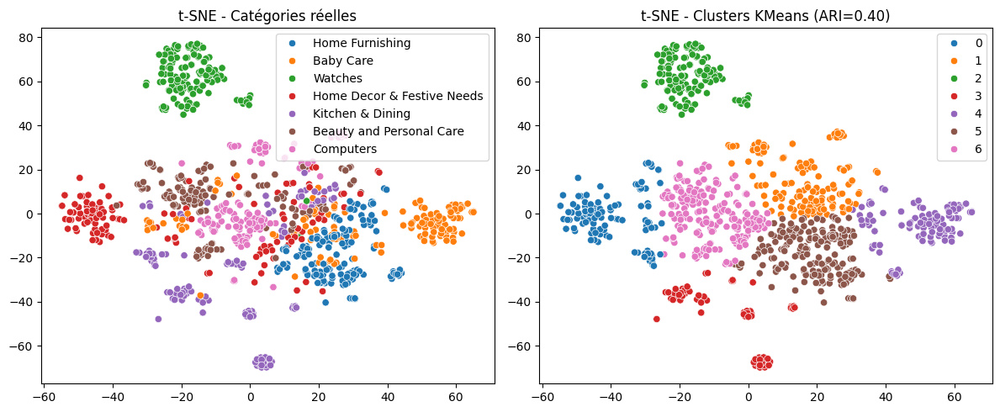

ARI BoW : 0.4003461590006957 | Temps : 12.29 sec


In [62]:
ari_bow, X_tsne_bow, cluster_labels_bow = clustering_tsne(X_bow_pca, categories, data['main_category'])
plot_tsne(X_tsne_bow, true_labels, cluster_labels_bow, categories, ari_bow)
elapsed_bow = round(time.time() - start_bow, 2)
print(f"ARI BoW : {ari_bow} | Temps : {elapsed_bow} sec")
np.save('models/X_bow_pca.npy', X_bow_pca)

### 3.3.2 Vectorisation TF-IDF

##### Entraînement du modèle CountVectorizer

In [63]:
start_tfidf = time.time()
vectorizer_tfidf = TfidfVectorizer(
    stop_words=stop_words,
    max_df=0.85,
    min_df=2
)
X_tfidf = vectorizer_tfidf.fit_transform(data['text_clean_bow'])
with open('models/vectorizer_tfidf.pkl', 'wb') as f:
    pickle.dump(vectorizer_tfidf, f)
print("Shape TF-IDF :", X_tfidf.shape)

Shape TF-IDF : (1050, 2142)


##### Réduction de dimension et clustering

In [64]:
pca_tfidf = PCA(n_components=0.99, random_state=42)
X_tfidf_pca = pca_tfidf.fit_transform(X_tfidf.toarray())
with open('models/pca_tfidf.pkl', 'wb') as f:
    pickle.dump(pca_tfidf, f)
print("Shape après PCA (TF-IDF) :", X_tfidf_pca.shape)

Shape après PCA (TF-IDF) : (1050, 647)


##### Clustering + t-SNE + ARI

/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


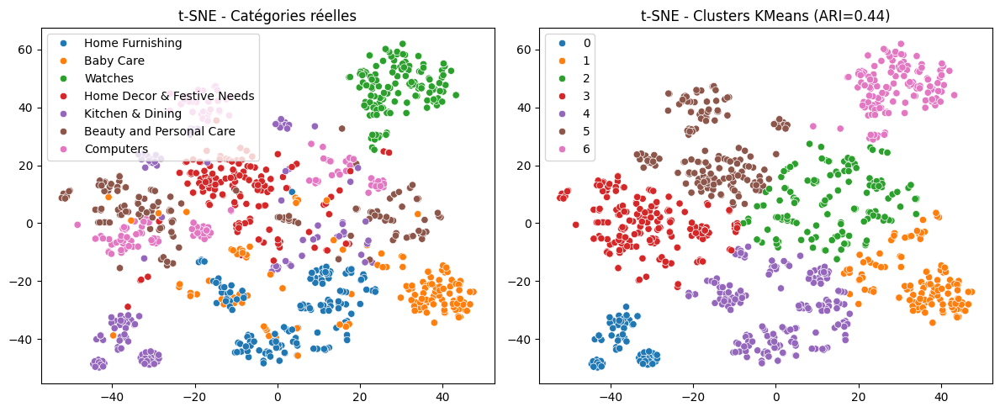

ARI TF-IDF : 0.4418831219461979 | Temps : 11.09 sec


In [65]:
ari_tfidf, X_tsne_tfidf, cluster_labels_tfidf = clustering_tsne(X_tfidf_pca, categories, data['main_category'])
plot_tsne(X_tsne_tfidf, true_labels, cluster_labels_tfidf, categories, ari_tfidf)
elapsed_tfidf = round(time.time() - start_tfidf, 2)
print(f"ARI TF-IDF : {ari_tfidf} | Temps : {elapsed_tfidf} sec")
np.save('models/X_tfidf_pca.npy', X_tfidf_pca)

,ARI,Temps (s),Dim. initiale,Dim. PCA
BoW,0.400346,12.29,2142.0,457.0
TF-IDF,0.441883,11.09,2142.0,647.0


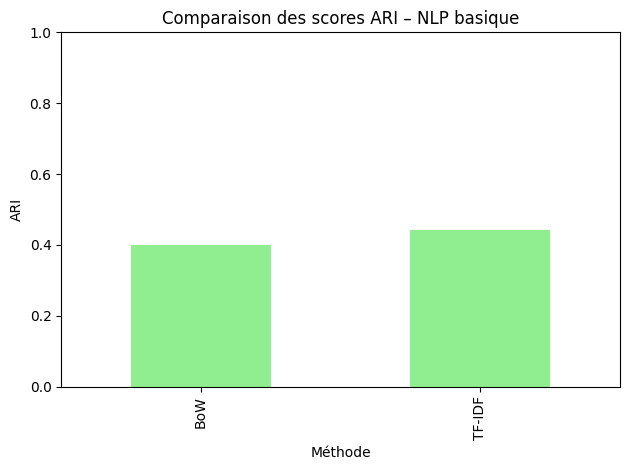

In [66]:
# Résumé dans un tableau
results_basics = {
    "BoW": {"ARI": ari_bow, "Temps (s)": elapsed_bow, "Dim. initiale": X_bow.shape[1], "Dim. PCA": X_bow_pca.shape[1]},
    "TF-IDF": {"ARI": ari_tfidf, "Temps (s)": elapsed_tfidf, "Dim. initiale": X_tfidf.shape[1], "Dim. PCA": X_tfidf_pca.shape[1]},
}
results_basics_df = pd.DataFrame(results_basics).T
results_basics_df.to_csv('results_nlp_basics.csv')
display(results_basics_df)

# Visualisation comparative
import matplotlib.pyplot as plt
results_basics_df['ARI'].plot(kind='bar', color='lightgreen')
plt.title("Comparaison des scores ARI – NLP basique")
plt.ylabel("ARI")
plt.xlabel("Méthode")
plt.ylim(0, 1)
plt.tight_layout()
plt.show()

# Etape 2 : Faisabilité classification – NLP avancé 

## 4.1 Word2Vec (Gensim)

In [67]:
import os
import time
from gensim.models import Word2Vec

# Fixer les seeds pour la reproductibilité
import random
random.seed(42)
np.random.seed(42)

##### Préparation des données

In [68]:
# Préparation des textes tokenisés
sentences = data['text_clean_lem'].apply(lambda x: x.split()).tolist()

##### Entraînement du modèle Word2Vec

In [69]:
# Entraînement du modèle Word2Vec
start_w2v = time.time()
w2v_model = Word2Vec(sentences, vector_size=100, window=5, min_count=2, workers=4, seed=42)
os.makedirs('models', exist_ok=True)
w2v_model.save('models/word2vec.model')

In [70]:
# Fonction pour obtenir le vecteur moyen d'une phrase
def get_sentence_vector(tokens, model):
    vectors = [model.wv[w] for w in tokens if w in model.wv]
    if vectors:
        return np.mean(vectors, axis=0)
    else:
        return np.zeros(model.vector_size)

X_w2v = np.vstack([get_sentence_vector(s, w2v_model) for s in sentences])
print("Shape Word2Vec embeddings:", X_w2v.shape)
np.save('models/X_w2v.npy', X_w2v)

Shape Word2Vec embeddings: (1050, 100)


##### Réduction de dimension et clustering

In [71]:
# PCA
pca_w2v = PCA(n_components=0.99, random_state=42)
X_w2v_pca = pca_w2v.fit_transform(X_w2v)
with open('models/pca_w2v.pkl', 'wb') as f:
    pickle.dump(pca_w2v, f)

##### Clustering + t-SNE + ARI

/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


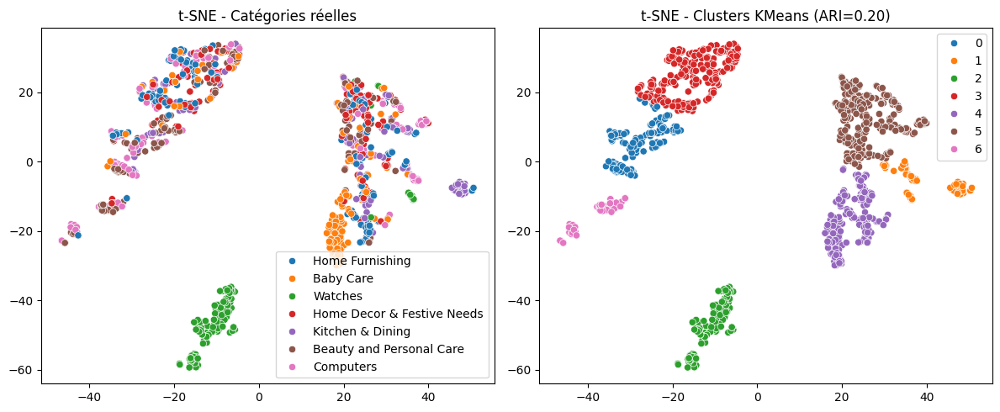

ARI Word2Vec : 0.2017252179351145 | Temps : 5.82 sec


In [72]:
# Clustering + t-SNE + ARI
ari_w2v, X_tsne_w2v, cluster_labels_w2v = clustering_tsne(X_w2v_pca, categories, data['main_category'])
plot_tsne(X_tsne_w2v, true_labels, cluster_labels_w2v, categories, ari_w2v)
elapsed_w2v = round(time.time() - start_w2v, 2)
print(f"ARI Word2Vec : {ari_w2v} | Temps : {elapsed_w2v} sec")

## 4.2 Embeddings BERT (Sentence Transformers)

Nous comparons l’impact du prétraitement linguistique (aucun, lemmatisation, stemmatisation) sur les performances de BERT.

Pour chaque version des textes, nous générons des embeddings, appliquons une réduction de dimension, puis évaluons le clustering (t-SNE, ARI) afin d’identifier la méthode la plus efficace.

Source du modèle BERT : https://huggingface.co/google-bert/bert-base-uncased

##### Préparation des données

In [73]:
import nltk
from nltk.corpus import stopwords

nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_w = set(stopwords.words('english'))

texts_raw = data['description'].fillna('').tolist()
texts_lemma = [transform_text_lem(text, stop_w) for text in texts_raw]
texts_stem = [transform_text_stem(text, stop_w) for text in texts_raw]

[nltk_data] Downloading package punkt to
[nltk_data]     /Users/jadesuchaud/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/jadesuchaud/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/jadesuchaud/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


##### Génération des embeddings BERT pour chaque version

In [74]:
from transformers import BertTokenizer, BertModel
import torch
import numpy as np
import time

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
model = BertModel.from_pretrained('bert-base-uncased')
model.eval()

def get_bert_embeddings(texts, batch_size=32):
    embeddings = []
    with torch.no_grad():
        for i in range(0, len(texts), batch_size):
            batch = texts[i:i+batch_size]
            encoded = tokenizer(batch, padding=True, truncation=True, return_tensors='pt', max_length=128)
            outputs = model(**encoded)
            cls_embeddings = outputs.last_hidden_state[:, 0, :].cpu().numpy()
            embeddings.append(cls_embeddings)
    return np.vstack(embeddings)

# BERT (brut)
start_raw = time.time()
X_bert_raw = get_bert_embeddings(texts_raw)
elapsed_raw = round(time.time() - start_raw, 2)

# BERT (lemmatisé)
start_lemma = time.time()
X_bert_lemma = get_bert_embeddings(texts_lemma)
elapsed_lemma = round(time.time() - start_lemma, 2)

# BERT (stemmisé)
start_stem = time.time()
X_bert_stem = get_bert_embeddings(texts_stem)
elapsed_stem = round(time.time() - start_stem, 2)

##### Réduction de dimension et clustering

In [75]:
from sklearn.decomposition import PCA
import pickle

# BERT (brut)
pca_raw = PCA(n_components=0.99, random_state=42)
X_bert_raw_pca = pca_raw.fit_transform(X_bert_raw)
with open('models/pca_bert_raw.pkl', 'wb') as f:
    pickle.dump(pca_raw, f)

# BERT (lemmatisé)
pca_lemma = PCA(n_components=0.99, random_state=42)
X_bert_lemma_pca = pca_lemma.fit_transform(X_bert_lemma)
with open('models/pca_bert_lemma.pkl', 'wb') as f:
    pickle.dump(pca_lemma, f)

# BERT (stemmisé)
pca_stem = PCA(n_components=0.99, random_state=42)
X_bert_stem_pca = pca_stem.fit_transform(X_bert_stem)
with open('models/pca_bert_stem.pkl', 'wb') as f:
    pickle.dump(pca_stem, f)

##### Clustering + t-SNE + ARI

In [76]:
# BERT (brut)
ari_raw, X_tsne_raw, cluster_labels_raw = clustering_tsne(X_bert_raw_pca, categories, data['main_category'])

# BERT (lemmatisé)
ari_lemma, X_tsne_lemma, cluster_labels_lemma = clustering_tsne(X_bert_lemma_pca, categories, data['main_category'])

# BERT (stemmisé)
ari_stem, X_tsne_stem, cluster_labels_stem = clustering_tsne(X_bert_stem_pca, categories, data['main_category'])

/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(
/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


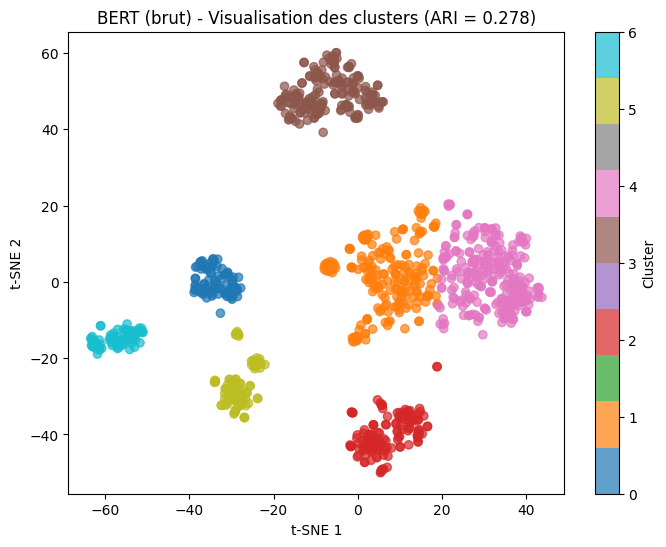

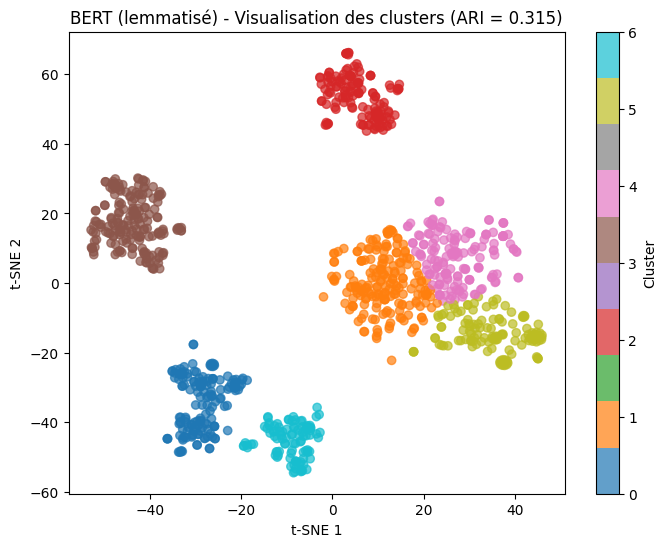

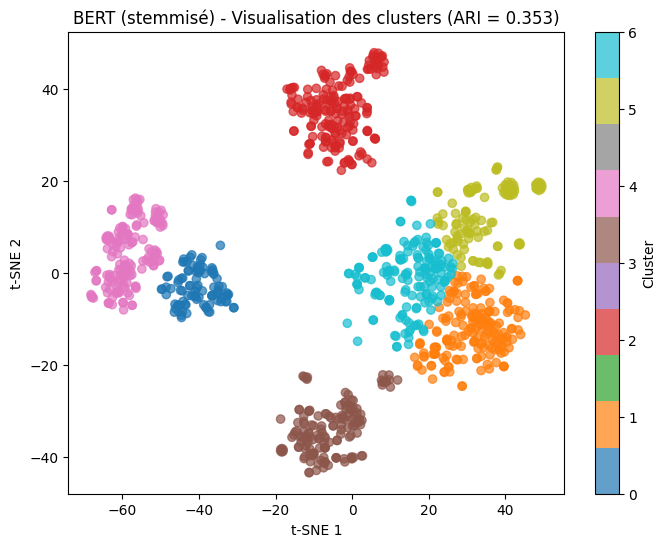

In [77]:
# Visualisation BERT (brut)
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_tsne_raw[:, 0], X_tsne_raw[:, 1], c=cluster_labels_raw, cmap='tab10', alpha=0.7)
plt.title(f"BERT (brut) - Visualisation des clusters (ARI = {ari_raw:.3f})")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.colorbar(scatter, label="Cluster")
plt.show()

# Visualisation BERT (lemmatisé)
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_tsne_lemma[:, 0], X_tsne_lemma[:, 1], c=cluster_labels_lemma, cmap='tab10', alpha=0.7)
plt.title(f"BERT (lemmatisé) - Visualisation des clusters (ARI = {ari_lemma:.3f})")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.colorbar(scatter, label="Cluster")
plt.show()

# Visualisation BERT (stemmisé)
plt.figure(figsize=(8, 6))
scatter = plt.scatter(X_tsne_stem[:, 0], X_tsne_stem[:, 1], c=cluster_labels_stem, cmap='tab10', alpha=0.7)
plt.title(f"BERT (stemmisé) - Visualisation des clusters (ARI = {ari_stem:.3f})")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.colorbar(scatter, label="Cluster")
plt.show()

## 4.3 Embeddings Universal Sentence Encoder (USE)

##### Entraînement du modèle USE

In [78]:
start_use = time.time()
use_model = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")
X_use = use_model(data['description'].fillna('').tolist()).numpy()
print("Shape USE embeddings:", X_use.shape)
np.save('models/X_use.npy', X_use)

Shape USE embeddings: (1050, 512)


##### Réduction de dimension et clustering

In [79]:
# PCA
pca_use = PCA(n_components=0.99, random_state=42)
X_use_pca = pca_use.fit_transform(X_use)
with open('models/pca_use.pkl', 'wb') as f:
    pickle.dump(pca_use, f)

##### Clustering + t-SNE + ARI

/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


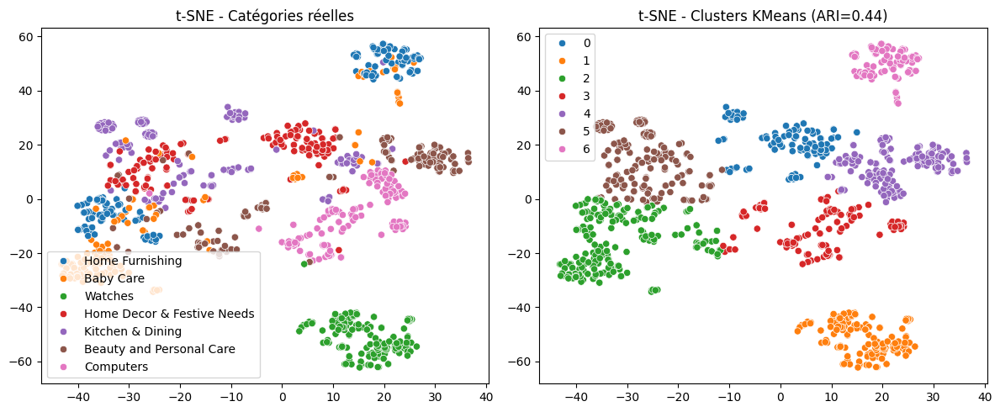

ARI USE : 0.44164852166704105 | Temps : 12.51 sec


In [80]:
# Clustering + t-SNE + ARI
ari_use, X_tsne_use, cluster_labels_use = clustering_tsne(X_use_pca, categories, data['main_category'])
plot_tsne(X_tsne_use, true_labels, cluster_labels_use, categories, ari_use)
elapsed_use = round(time.time() - start_use, 2)
print(f"ARI USE : {ari_use} | Temps : {elapsed_use} sec")

# 5. Comparaison et synthèse des classifications NPL

,ARI,Temps (s),Dim. initiale,Dim. PCA
BoW,0.400346,12.29,2142.0,457.0
TF-IDF,0.441883,11.09,2142.0,647.0
Word2Vec,0.201725,5.82,100.0,3.0
BERT (brut),0.277573,55.33,768.0,325.0
BERT (lemmatisé),0.315356,53.38,768.0,333.0
BERT (stemmisé),0.352998,42.50,768.0,326.0
USE,0.441649,12.51,512.0,308.0


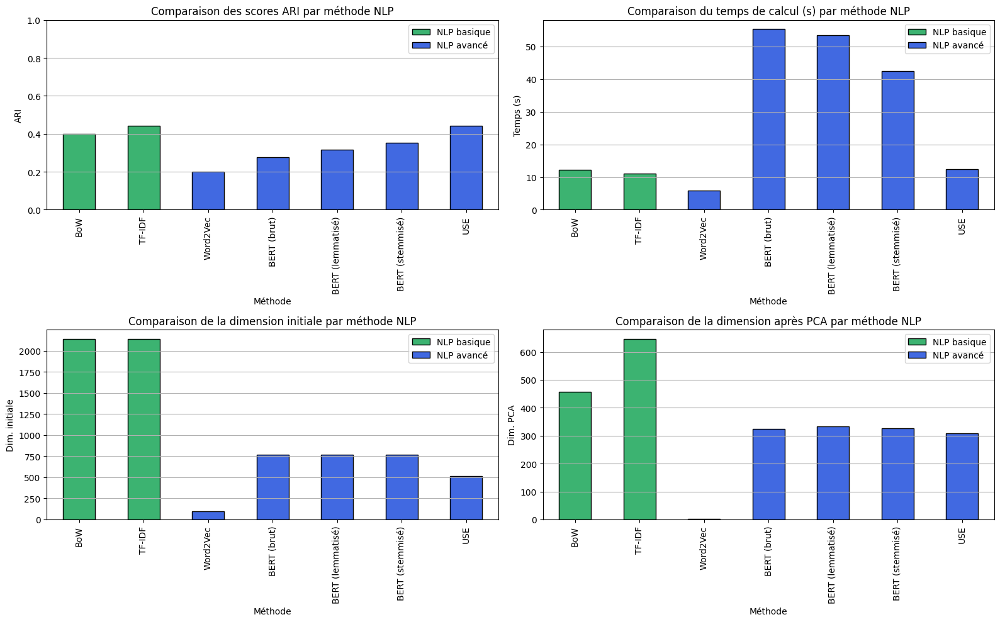

In [81]:
results = {
    "BoW": {"ARI": ari_bow, "Temps (s)": elapsed_bow, "Dim. initiale": X_bow.shape[1], "Dim. PCA": X_bow_pca.shape[1]},
    "TF-IDF": {"ARI": ari_tfidf, "Temps (s)": elapsed_tfidf, "Dim. initiale": X_tfidf.shape[1], "Dim. PCA": X_tfidf_pca.shape[1]},
    "Word2Vec": {"ARI": ari_w2v, "Temps (s)": elapsed_w2v, "Dim. initiale": X_w2v.shape[1], "Dim. PCA": X_w2v_pca.shape[1]},
    "BERT (brut)": {"ARI": ari_raw, "Temps (s)": elapsed_raw, "Dim. initiale": X_bert_raw.shape[1], "Dim. PCA": X_bert_raw_pca.shape[1]},
    "BERT (lemmatisé)": {"ARI": ari_lemma, "Temps (s)": elapsed_lemma, "Dim. initiale": X_bert_lemma.shape[1], "Dim. PCA": X_bert_lemma_pca.shape[1]},
    "BERT (stemmisé)": {"ARI": ari_stem, "Temps (s)": elapsed_stem, "Dim. initiale": X_bert_stem.shape[1], "Dim. PCA": X_bert_stem_pca.shape[1]},
    "USE": {"ARI": ari_use, "Temps (s)": elapsed_use, "Dim. initiale": X_use.shape[1], "Dim. PCA": X_use_pca.shape[1]},
}
results_df = pd.DataFrame(results).T
results_df.to_csv('results_nlp_comparatif.csv')
display(results_df)

# Visualisation comparative multi-métriques avec couleurs différenciées
import matplotlib.pyplot as plt

basic_methods = ['BoW', 'TF-IDF']
advanced_methods = ['Word2Vec', 'BERT (brut)', 'BERT (lemmatisé)', 'BERT (stemmisé)', 'USE']

method_colors = ['mediumseagreen' if m in basic_methods else 'royalblue' for m in results_df.index]

metrics = ['ARI', 'Temps (s)', 'Dim. initiale', 'Dim. PCA']
titles = [
    "Comparaison des scores ARI par méthode NLP",
    "Comparaison du temps de calcul (s) par méthode NLP",
    "Comparaison de la dimension initiale par méthode NLP",
    "Comparaison de la dimension après PCA par méthode NLP"
]

fig, axes = plt.subplots(2, 2, figsize=(16, 10))
axes = axes.flatten()

for i, metric in enumerate(metrics):
    results_df[metric].plot(
        kind='bar',
        color=method_colors,
        ax=axes[i],
        edgecolor='black'
    )
    axes[i].set_title(titles[i])
    axes[i].set_xlabel("Méthode")
    axes[i].set_ylabel(metric)
    if metric == 'ARI':
        axes[i].set_ylim(0, 1)
    axes[i].grid(axis='y')
    from matplotlib.patches import Patch
    legend_elements = [
        Patch(facecolor='mediumseagreen', edgecolor='black', label='NLP basique'),
        Patch(facecolor='royalblue', edgecolor='black', label='NLP avancé')
    ]
    axes[i].legend(handles=legend_elements, loc='best')

plt.tight_layout()
plt.show()

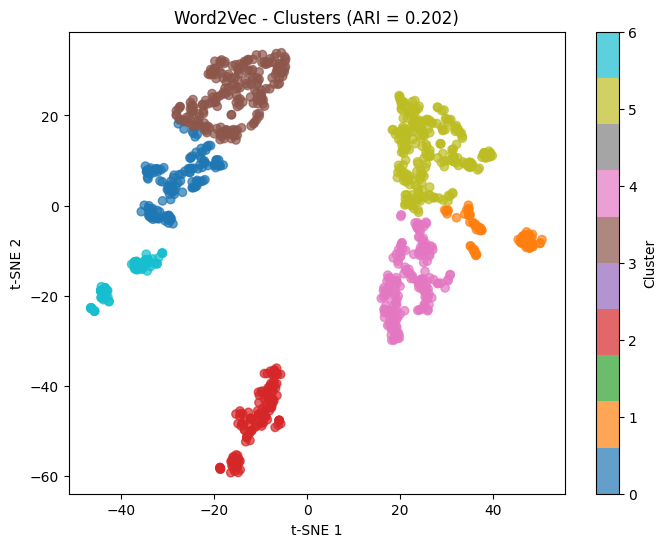

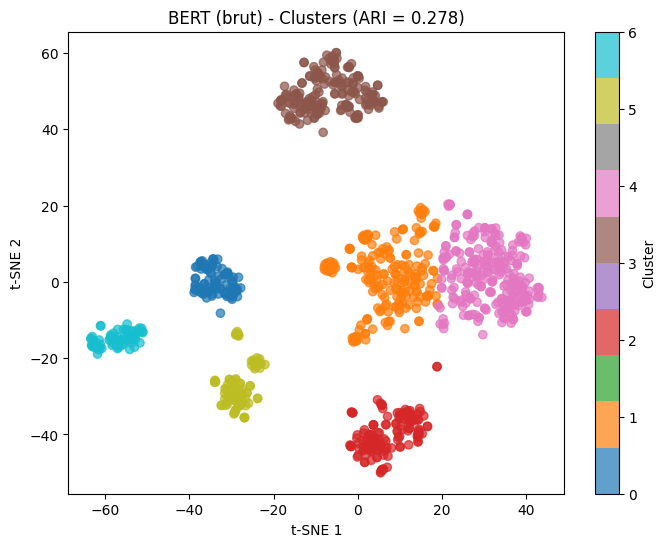

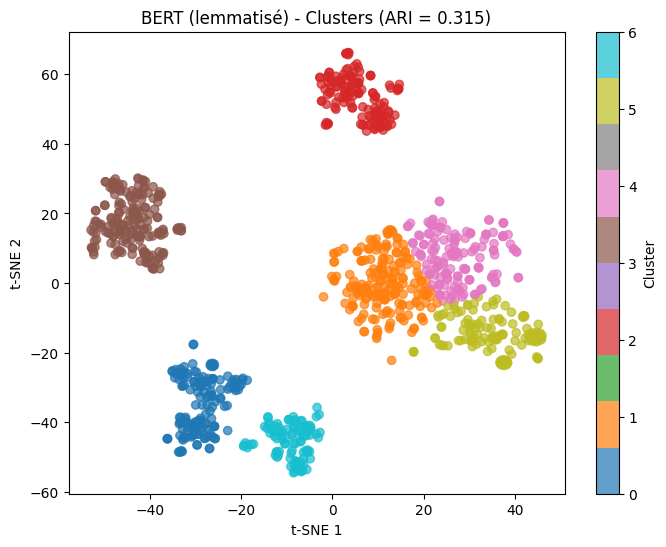

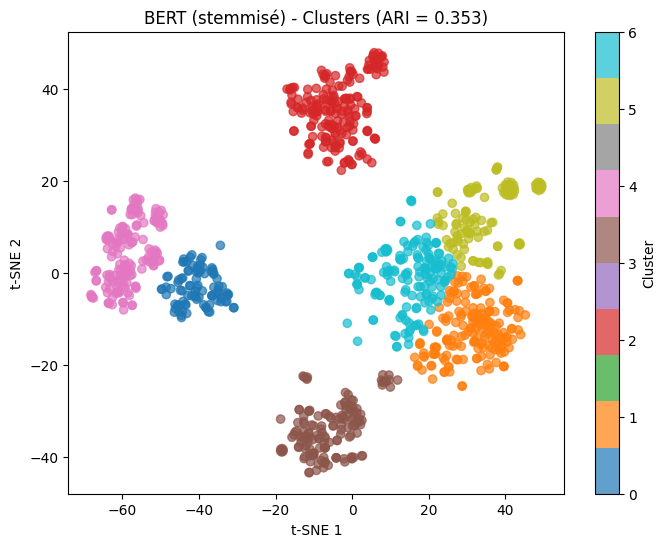

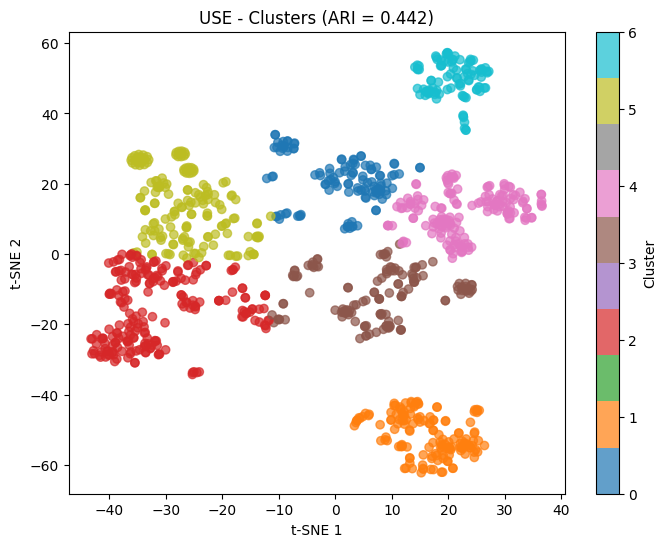

In [82]:
def plot_clusters(X_tsne, cluster_labels, ari, method_name):
    plt.figure(figsize=(8, 6))
    scatter = plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=cluster_labels, cmap='tab10', alpha=0.7)
    plt.title(f"{method_name} - Clusters (ARI = {ari:.3f})")
    plt.xlabel("t-SNE 1")
    plt.ylabel("t-SNE 2")
    plt.colorbar(scatter, label="Cluster")
    plt.show()

# Exemple d'appel pour chaque méthode avancée :
plot_clusters(X_tsne_w2v, cluster_labels_w2v, ari_w2v, "Word2Vec")
plot_clusters(X_tsne_raw, cluster_labels_raw, ari_raw, "BERT (brut)")
plot_clusters(X_tsne_lemma, cluster_labels_lemma, ari_lemma, "BERT (lemmatisé)")
plot_clusters(X_tsne_stem, cluster_labels_stem, ari_stem, "BERT (stemmisé)")
plot_clusters(X_tsne_use, cluster_labels_use, ari_use, "USE")

In [83]:
import numpy as np

def print_misclustered(data, true_labels, cluster_labels, method_name, n=5):
    errors = np.where(np.array(true_labels) != np.array(cluster_labels))[0]
    print(f"\n{method_name} - Exemples mal clusterisés :")
    for idx in errors[:n]:
        print(f"Texte : {data['description'].iloc[idx]}")
        print(f"Classe réelle : {true_labels[idx]}, Cluster prédit : {cluster_labels[idx]}\n")

# Exemple d'appel
print_misclustered(data, true_labels, cluster_labels_raw, "BERT (brut)")


BERT (brut) - Exemples mal clusterisés :
Texte : Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain t

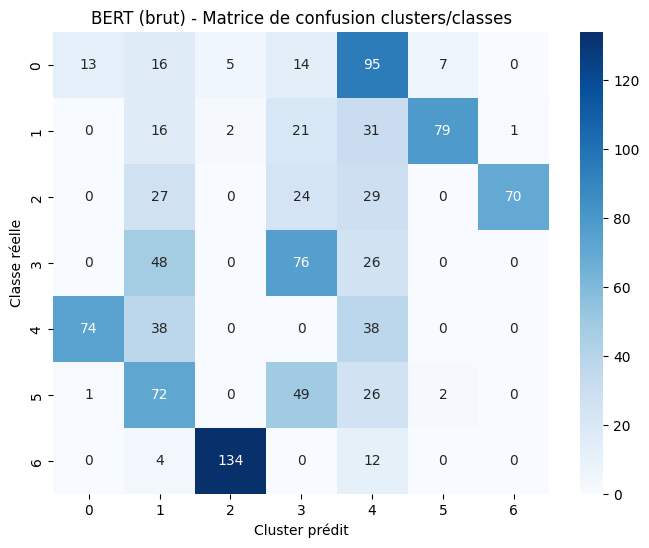

In [84]:
le = LabelEncoder()
true_labels_int = le.fit_transform(true_labels)
# cluster_labels est déjà un tableau d'entiers (clusters)

from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

def plot_confusion(true_labels, cluster_labels, method_name):
    cm = confusion_matrix(true_labels, cluster_labels)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f"{method_name} - Matrice de confusion clusters/classes")
    plt.xlabel("Cluster prédit")
    plt.ylabel("Classe réelle")
    plt.show()

plot_confusion(true_labels_int, cluster_labels_raw, "BERT (brut)")

Cela signifie que, dans ta matrice de confusion, 134 textes qui appartiennent à la classe réelle 6 ont été assignés au cluster 3 par ton algorithme de clustering.

Interprétation :

- Le modèle confond souvent la classe 6 avec le cluster 3.
- Cela peut indiquer que les textes de la classe 6 partagent des caractéristiques similaires avec ceux du cluster 3, ou que le modèle ne parvient pas à bien séparer ces deux groupes.

In [85]:
indices = np.where((true_labels_int == 6) & (cluster_labels_raw == 3))[0]
for idx in indices[:10]:  # Affiche les 10 premiers exemples
    print(f"Texte : {data['description'].iloc[idx]}")

Ce résultat montre que beaucoup de textes mal clusterisés dans ta classe réelle 6 (par exemple) sont des descriptions de montres ("Analog Watch", "Digital Watch", "For Boys", "For Men", etc.).

Comment interpréter ce résultat ?
- Homogénéité thématique : Tous ces textes parlent de montres, donc le modèle regroupe bien des objets similaires, même s’il ne respecte pas exactement la classe réelle.
- Possible confusion de catégories : Si la classe réelle 6 correspond à une catégorie fine (par exemple "Montres pour garçons") mais que le cluster 3 regroupe toutes les montres (garçons, hommes, femmes), cela explique la confusion.
- Limite du clustering : Les modèles de clustering ne connaissent pas les vraies classes : ils regroupent selon la similarité des textes. - Si les descriptions sont très proches, le modèle peut mélanger des sous-catégories.

In [86]:
indices = np.where((true_labels_int == 0) & (cluster_labels_raw == 1))[0]
for idx in indices[:10]:
    print(f"Texte : {data['description'].iloc[idx]}")

Texte : Key Features of Eurospa Cotton Terry Face Towel Set Size: small Height: 9 inch GSM: 360,Eurospa Cotton Terry Face Towel Set (20 PIECE FACE TOWEL SET, Assorted) Price: Rs. 299 Eurospa brings to you an exclusively designed, 100% soft cotton towels of export quality. All our products have soft texture that takes care of your skin and gives you that enriched feeling you deserve. Eurospa has been exporting its bath towels to lot of renowned brands for last 10 years and is famous for its fine prints, absorbency, softness and durability. NOTE: Our product is 100% cotton, so it is susceptible to shrinkage. Product color may vary from the picture. Size may vary by ±3% WASH CARE: Wash in cold Water, Do not Iron, Do not Bleach, Flat dry, Wash before first use. SIZE- FACE TOWEL - 23 cms X 23 cms.,Specifications of Eurospa Cotton Terry Face Towel Set (20 PIECE FACE TOWEL SET, Assorted) Bath Towel Features Material Cotton Terry Design SHUVAM General Brand Eurospa GSM 360 Type Face Towel Set 

Tous ces textes concernent des produits pour enfants ou la maison : serviettes, pyjamas, sacs, matelas, shorts, bonnets, moustiquaires, etc.

Similarité textuelle :
- Les descriptions partagent beaucoup de mots-clés (coton, pack, baby, girl, shorts, etc.), ce qui peut conduire le modèle à les regrouper ensemble, même si les catégories réelles sont différentes.
- Le modèle regroupe logiquement des produits similaires, mais il ne distingue pas forcément toutes les sous-catégories attendues. 

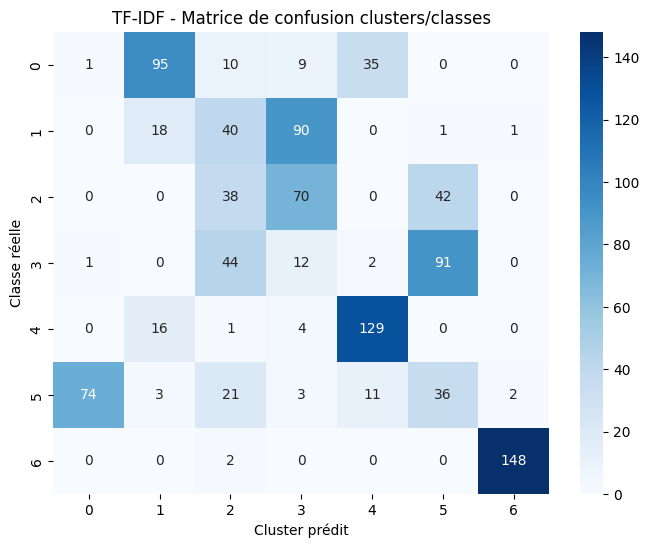

In [87]:
# Clustering sur t-SNE déjà fait, cluster_labels_tfidf
le = LabelEncoder()
true_labels_int = le.fit_transform(data['main_category'])

def plot_confusion(true_labels, cluster_labels, method_name):
    cm = confusion_matrix(true_labels, cluster_labels)
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f"{method_name} - Matrice de confusion clusters/classes")
    plt.xlabel("Cluster prédit")
    plt.ylabel("Classe réelle")
    plt.show()

plot_confusion(true_labels_int, cluster_labels_tfidf, "TF-IDF")

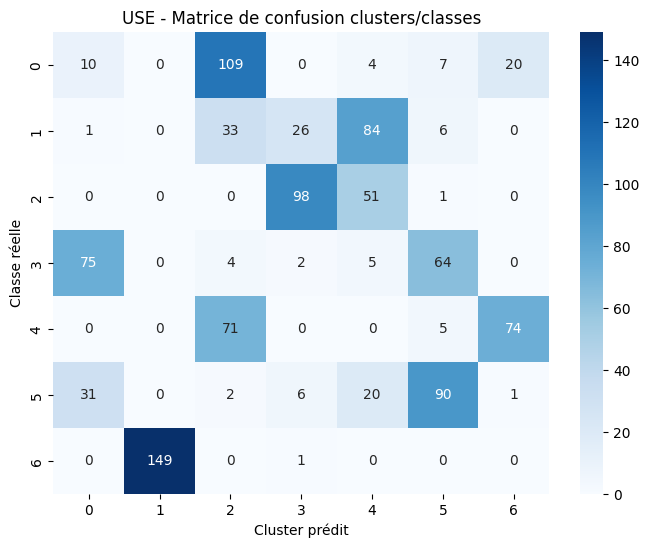

In [155]:
plot_confusion(true_labels_int, cluster_labels_use, "USE")

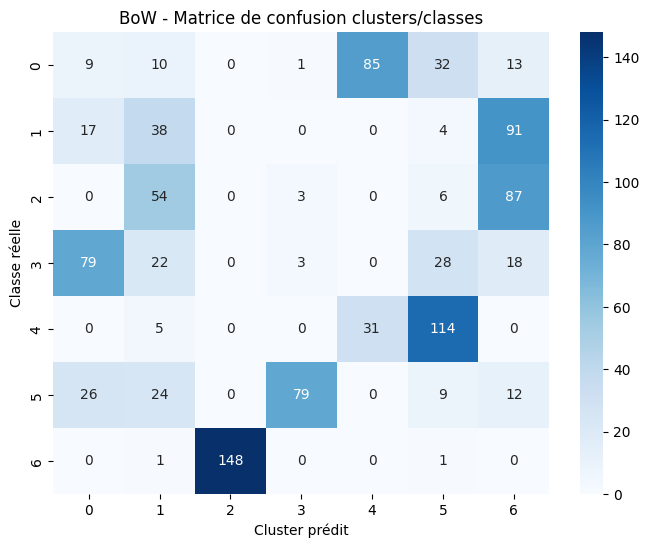

In [147]:
# Matrice de confusion pour BoW
plot_confusion(true_labels_int, cluster_labels_bow, "BoW")

In [156]:
def print_examples(data, true_labels, cluster_labels, method_name, n=5):
    true_labels = np.array(true_labels)
    cluster_labels = np.array(cluster_labels)
    print(f"\n{method_name} - Exemples bien clusterisés :")
    good = np.where(true_labels == cluster_labels)[0]
    for idx in good[:n]:
        print(f"Texte : {data['description'].iloc[idx]}")
        print(f"Catégorie réelle : {le.inverse_transform([true_labels[idx]])[0]}, Cluster prédit : {cluster_labels[idx]}\n")
    print(f"\n{method_name} - Exemples mal clusterisés :")
    bad = np.where(true_labels != cluster_labels)[0]
    for idx in bad[:n]:
        print(f"Texte : {data['description'].iloc[idx]}")
        print(f"Catégorie réelle : {le.inverse_transform([true_labels[idx]])[0]}, Cluster prédit : {cluster_labels[idx]}\n")

# Exemples pour BoW
print_examples(data, true_labels_int, cluster_labels_bow, "BoW")

# Exemples pour TF-IDF
print_examples(data, true_labels_int, cluster_labels_tfidf, "TF-IDF")

# Exemples pour USE
print_examples(data, true_labels_int, cluster_labels_tfidf, "USE")


BoW - Exemples bien clusterisés :
Texte : Key Features of SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet Royal Bedsheet Perfact for Wedding & Gifting,Specifications of SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet (1 Bedsheet,2 Pillow Cover, Multicolor) General Brand SANTOSH ROYAL FASHION Machine Washable Yes Type Flat Material Cotton Model Name Gold Design Royal Cotton Printed Wedding & Gifted Double Bedsheet With 2 Pillow cover Model ID goldbedi-38 Color Multicolor Size King Fabric Care Machine Wash, Do Not Bleach Dimensions Flat Sheet Width 90 inch / 230 cm Fitted Sheet Width 228 cm Pillow Cover Width 16 inch / 43 cm Pillow Cover Length 28 inch / 72 cm Fitted Sheet Depth 280 cm Fitted Sheet Length 278 cm Flat Sheet Depth 282 cm Flat Sheet Length 110 inch / 280 cm In the Box Number of Contents in Sales Package 1 Sales Package 1 Bedsheet,2 Pillow Cover
Catégorie réelle : Home Furnishing, Cluster prédit : 4

Texte : Key Features of Jaipur Print Cotto

Chemin de l'image : /Users/jadesuchaud/Documents/images/55b85ea15a1536d46b7190ad6fff8ce7.jpg


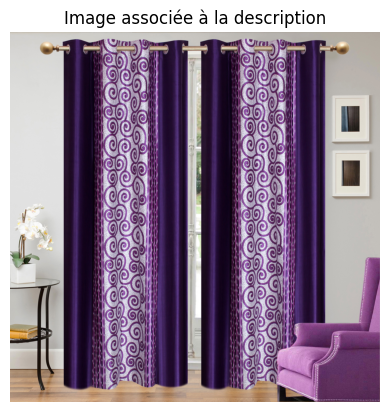

In [162]:
desc = """Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you get the right amount of sunlight.,Specifications of Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) General Brand Elegance Designed For Door Type Eyelet Model Name Abstract Polyester Door Curtain Set Of 2 Model ID Duster25 Color Multicolor Dimensions Length 213 cm In the Box Number of Contents in Sales Package Pack of 2 Sales Package 2 Curtains Body & Design Material Polyester"""

# Recherche exacte (ou utilise .str.contains pour une recherche partielle)
row = data[data['description'] == desc]

if not row.empty:
    img_path = row['image_path'].iloc[0]
    print("Chemin de l'image :", img_path)
    from PIL import Image
    import matplotlib.pyplot as plt
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Image associée à la description")
    plt.show()
else:
    print("Aucune correspondance exacte trouvée.")

Chemin de l'image : /Users/jadesuchaud/Documents/images/64d5d4a258243731dc7bbb1eef49ad74.jpg


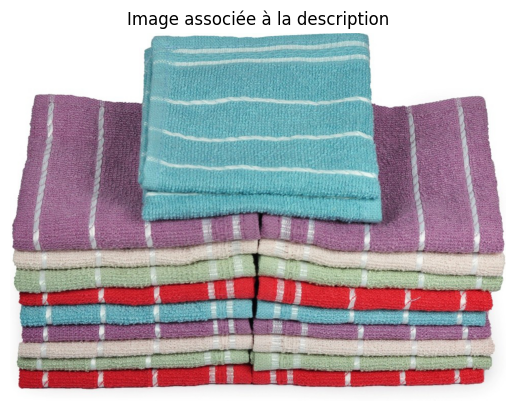

In [165]:
desc = """Key Features of Eurospa Cotton Terry Face Towel Set Size: small Height: 9 inch GSM: 360,Eurospa Cotton Terry Face Towel Set (20 PIECE FACE TOWEL SET, Assorted) Price: Rs. 299 Eurospa brings to you an exclusively designed, 100% soft cotton towels of export quality. All our products have soft texture that takes care of your skin and gives you that enriched feeling you deserve. Eurospa has been exporting its bath towels to lot of renowned brands for last 10 years and is famous for its fine prints, absorbency, softness and durability. NOTE: Our product is 100% cotton, so it is susceptible to shrinkage. Product color may vary from the picture. Size may vary by ±3% WASH CARE: Wash in cold Water, Do not Iron, Do not Bleach, Flat dry, Wash before first use. SIZE- FACE TOWEL - 23 cms X 23 cms.,Specifications of Eurospa Cotton Terry Face Towel Set (20 PIECE FACE TOWEL SET, Assorted) Bath Towel Features Material Cotton Terry Design SHUVAM General Brand Eurospa GSM 360 Type Face Towel Set Model Name SHUVAM20PCFTSETASSORTED Ideal For Boys, Girls, Men, Women Model ID SHUVAM20PCFTSETASSORTED Size small Color Assorted Dimensions Weight 350 g Length 9 inch Width 9 inch In the Box Number of Contents in Sales Package 20 Sales Package 20 PIECE FACE TOWEL SET"""

# Recherche exacte (ou utilise .str.contains pour une recherche partielle)
row = data[data['description'] == desc]

if not row.empty:
    img_path = row['image_path'].iloc[0]
    print("Chemin de l'image :", img_path)
    from PIL import Image
    import matplotlib.pyplot as plt
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Image associée à la description")
    plt.show()
else:
    print("Aucune correspondance exacte trouvée.")

Chemin de l'image : /Users/jadesuchaud/Documents/images/893aa5ed55f7cff2eccea7758d7a86bd.jpg


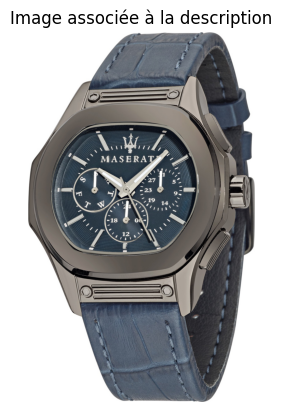

In [151]:
desc = """Maserati Time R8851116001 Analog Watch  - For Boys - Buy Maserati Time R8851116001 Analog Watch  - For Boys  R8851116001 Online at Rs.24400 in India Only at Flipkart.com. - Great Discounts, Only Genuine Products, 30 Day Replacement Guarantee, Free Shipping. Cash On Delivery!"""

row = data[data['description'] == desc]

if not row.empty:
    img_path = row['image_path'].iloc[0]
    print("Chemin de l'image :", img_path)
    from PIL import Image
    import matplotlib.pyplot as plt
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Image associée à la description")
    plt.show()
else:
    print("Aucune correspondance exacte trouvée.")

Chemin de l'image : /Users/jadesuchaud/Documents/images/e9420e9483f16db81c64dddf99f34841.jpg


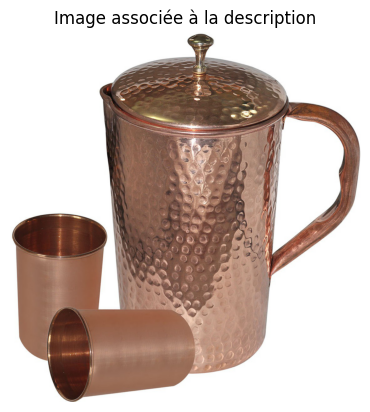

In [153]:
desc = """Key Features of Dungri India Craft Ducjug010-ducgl012-2 Jug Glass Set Jug: Height- 8 inches, Dia - 4.2 inches, Depth 7.5 inches, Width 7 inches,capacity 1744 ml, Weight - 430 Grams,Dungri India Craft Ducjug010-ducgl012-2 Jug Glass Set (Copper) Price: Rs. 1,399 Copper Utensils And Serving Copper Ware Helped To Prevent The Spread Of Diseases. In Many Tests It Showed That 99.9% Of The Bacteria On Copper Alloy Surfaces (With 65% Or Greater Copper Content) Were Eliminated Within 2 Hours Of Exposure. According To Research At Southampton University In The U.K., Mrsa Microbes Remain Alive On Stainless Steel Surfaces For Up To Three Days, Whereas The Same Microbes On A Copper Surface Are Eliminated Within 90 Minutes. These Copper Serving Ware Are Preferred Because It Is Durable And It Has Excellent Characteristics. The Ageless Use Of Copper Bears Testimony To Its Myriad Virtues And Everlasting Appeal. Its Therapeutic Value Has Been Handed Down To Us Through The Ages. In Fact, Water Stored In Copper Ware Is Virtually The Elixir Of Life. Purified, It Helps To Regulate Digestion And Cardiac Orders, The Basis Of Good Health, As Practiced By Ayurveda And Rishits From Old Vedic Times.   Care Tips:  * Clean Your Copperware By Hand And Avoid Dishwasher As The Detergent Can Cause Oxidation Leading To Permanat Damage. * Use A Solution Of Equal Quantities Vinegar Or Lemon Juice And Salt Diluted With Some Water At Such Times But Don'T Use It Regularly. * Avoid Scratchy Cleaners Like Steel Wool. * A Simple, Soft Cleaning Liquid On Soap Base, Hot Water And A Soft Washing Cloth Is Best For Daily Use.,Specifications of Dungri India Craft Ducjug010-ducgl012-2 Jug Glass Set (Copper) General Brand Dungri India Craft Number of Glasses 2 Model Number Ducjug010-ducgl012-2 Type Jug Glass Set Glass Shape Tumblers Material Copper Capacity per Glass 320 ml Jug Capacity 1.7 L Color Gold Dimensions Jug Height 203 mm Glass Diameter 50 mm Jug Depth 190 mm Other Dimensions Glass: Dia - 2", Height - 4", capacity - 320 ml, Weight - 75 grams In the Box 1 Jug 2 Glass Set Additional Features Microwave Safe No Care Instructions For Better Washing Result Wash With Pitambari Cleaning Power"""

row = data[data['description'] == desc]

if not row.empty:
    img_path = row['image_path'].iloc[0]
    print("Chemin de l'image :", img_path)
    from PIL import Image
    import matplotlib.pyplot as plt
    img = Image.open(img_path)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Image associée à la description")
    plt.show()
else:
    print("Aucune correspondance exacte trouvée.")

In [138]:
import pandas as pd
from collections import Counter

def print_cluster_majority(data, true_labels_int, cluster_labels, label_encoder):
    df = pd.DataFrame({
        'true_label': true_labels_int,
        'cluster': cluster_labels
    })
    for cluster_id in np.unique(cluster_labels):
        cluster_true_labels = df[df['cluster'] == cluster_id]['true_label']
        most_common_label, count = Counter(cluster_true_labels).most_common(1)[0]
        cat_name = label_encoder.inverse_transform([most_common_label])[0]
        print(f"Cluster {cluster_id} : catégorie réelle majoritaire = {cat_name} (label {most_common_label}), {count} exemples")

# Utilisation :
print_cluster_majority(data, true_labels_int, cluster_labels_tfidf, le)

Cluster 0 : catégorie réelle majoritaire = Kitchen & Dining (label 5), 74 exemples
Cluster 1 : catégorie réelle majoritaire = Baby Care (label 0), 95 exemples
Cluster 2 : catégorie réelle majoritaire = Home Decor & Festive Needs (label 3), 44 exemples
Cluster 3 : catégorie réelle majoritaire = Beauty and Personal Care (label 1), 90 exemples
Cluster 4 : catégorie réelle majoritaire = Home Furnishing (label 4), 129 exemples
Cluster 5 : catégorie réelle majoritaire = Home Decor & Festive Needs (label 3), 91 exemples
Cluster 6 : catégorie réelle majoritaire = Watches (label 6), 148 exemples


In [135]:
def print_misclustered(data, true_labels, cluster_labels, method_name, n=5):
    errors = np.where(np.array(true_labels) != np.array(cluster_labels))[0]
    print(f"\n{method_name} - Exemples mal clusterisés :")
    for idx in errors[:n]:
        print(f"Texte : {data['description'].iloc[idx]}")
        print(f"Classe réelle : {true_labels[idx]}, Cluster prédit : {cluster_labels[idx]}\n")

# Pour TF-IDF
print_misclustered(data, true_labels_int, cluster_labels_tfidf, "TF-IDF")

# Pour USE
print_misclustered(data, true_labels_int, cluster_labels_use, "USE")


TF-IDF - Exemples mal clusterisés :
Texte : Specifications of Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Yellow, Blue) Bath Towel Features Machine Washable Yes Material Cotton Design Self Design General Brand Sathiyas Type Bath Towel GSM 500 Model Name Sathiyas cotton bath towel Ideal For Men, Women, Boys, Girls Model ID asvtwl322 Color Red, Yellow, Blue Size Mediam Dimensions Length 30 inch Width 60 inch In the Box Number of Contents in Sales Package 3 Sales Package 3 Bath Towel
Classe réelle : 0, Cluster prédit : 4

Texte : Key Features of Eurospa Cotton Terry Face Towel Set Size: small Height: 9 inch GSM: 360,Eurospa Cotton Terry Face Towel Set (20 PIECE FACE TOWEL SET, Assorted) Price: Rs. 299 Eurospa brings to you an exclusively designed, 100% soft cotton towels of export quality. All our products have soft texture that takes care of your skin and gives you that enriched feeling you deserve. Eurospa has been exporting its bath towels to lot of renowned brands for last 10 year

# Etape 3 : Faisabilité classification – Image basiques

In [89]:
import os
print(os.listdir("/Users/jadesuchaud/Documents/images"))

['aa68675f50a0551b8dadb954017a50a1.jpg', '037c2402fee39fbc80433935711d1383.jpg', '42643c1c9403f67921a18654bcf45ead.jpg', '53f4bc7d7321f5c41de6b86e41f13e80.jpg', 'b144a363c107c7bdd91f32d6e28ba6f2.jpg', 'db3e2eeb4fe90d4755f2911d661eae95.jpg', '9a9402ad55d079c86c302521816b7b0e.jpg', '42a8fef62716772c391fbdd148cc9c16.jpg', '503bb08f7bdf6a395ec564dd1dc83619.jpg', '42770faa04bfcf2b62e7ef335e1b1965.jpg', '9c4ab8ab059c912090c83cb0818e7f1c.jpg', 'f2fa99bfaa4aa65a2bd53337e140f949.jpg', 'a618354ba17cff64826558d81afc77ab.jpg', 'c063d07d78a55a21bf6c0e7c8ae46a6d.jpg', 'e99d9abb115a9bd580bcccf9ff4d4881.jpg', '1d829e0eac91d7e85cdd6d581c363360.jpg', '5c7b493625b5fc6689cae49d25e1ae17.jpg', '06749cbff1487f470438823f6952cfd1.jpg', 'ab3f4b2d2ec007b7e0eaec213bfdbffc.jpg', '473b1ab1abe21826c41efa1584a88a63.jpg', '07912328f580cf080d721e6466287896.jpg', 'e47b9f88b773b3fd97ab3b51642ff6fb.jpg', '5cd3d274d71e1e0d6bf075421461b2d5.jpg', '7264f56639c8c54158b94ced769082c8.jpg', '0991e8d8f884003ab18890971191085d.jpg',

In [90]:
image_folder = "/Users/jadesuchaud/Documents/images"

In [91]:
import cv2
import os

def load_image(path):
    if os.path.exists(path):
        img = cv2.imread(path)
        if img is not None:
            return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return None  # ou np.zeros((hauteur, largeur))

##### Vérification et préparation des chemins d’images

Générer une colonne image_path avec le chemin absolu de chaque image.

In [92]:
data['image_path'] = data['image'].apply(lambda x: f"/Users/jadesuchaud/Documents/images/{x}")
missing = data[~data['image_path'].apply(os.path.exists)]
print(f"Images manquantes : {len(missing)}")

Images manquantes : 0


## 6.1 Analyse exploratoire des images

##### Statistiques sur les tailles d’images

In [93]:
from PIL import Image
import os

# Exemple : images stockées dans 'images/' et noms dans data['image_path']
image_shapes = []
for path in data['image_path']:
    img = Image.open(os.path.join('images', path))
    image_shapes.append(img.size)  # (width, height)

import pandas as pd
shapes_df = pd.DataFrame(image_shapes, columns=['width', 'height'])
print(shapes_df.describe())

             width        height
count  1050.000000   1050.000000
mean   1196.570476   1220.038095
std     864.076765    744.841368
min     145.000000    160.000000
25%     747.250000    844.000000
50%    1100.000000   1100.000000
75%    1214.250000   1360.000000
max    8484.000000  11042.000000


/opt/anaconda3/lib/python3.11/site-packages/PIL/Image.py:3186: DecompressionBombWarning: Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
  warnings.warn(


##### Distribution des formats (proportions largeur/hauteur)

In [94]:
shapes_df['ratio'] = shapes_df['width'] / shapes_df['height']
print(shapes_df['ratio'].describe())

count    1050.000000
mean        1.050541
std         0.524489
min         0.117172
25%         0.676975
50%         0.997812
75%         1.303318
max         4.359155
Name: ratio, dtype: float64


##### Distribution des largeurs et hauteurs

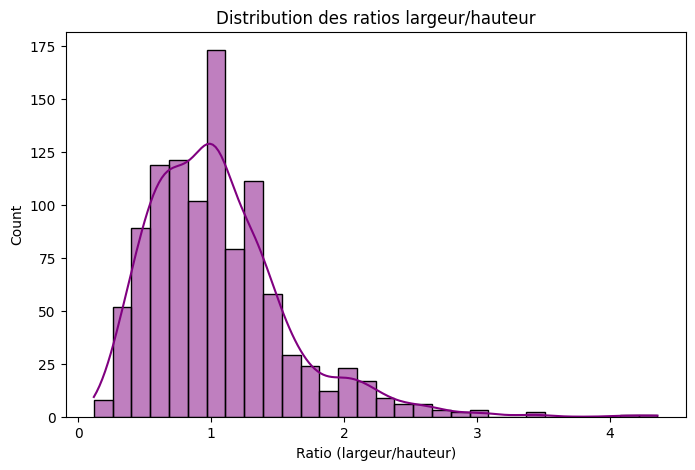

In [95]:
plt.figure(figsize=(8,5))
sns.histplot(shapes_df['ratio'], bins=30, color='purple', kde=True)
plt.title("Distribution des ratios largeur/hauteur")
plt.xlabel("Ratio (largeur/hauteur)")
plt.show()

##### Distribution des ratios largeur/hauteur

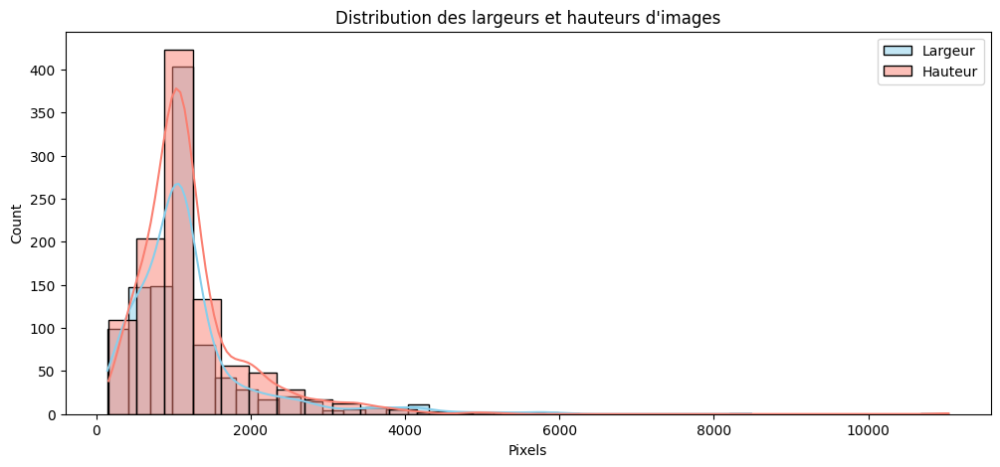

In [96]:
plt.figure(figsize=(12,5))
sns.histplot(shapes_df['width'], bins=30, color='skyblue', label='Largeur', kde=True)
sns.histplot(shapes_df['height'], bins=30, color='salmon', label='Hauteur', kde=True)
plt.legend()
plt.title("Distribution des largeurs et hauteurs d'images")
plt.xlabel("Pixels")
plt.show()

##### Scatter plot largeur vs hauteur

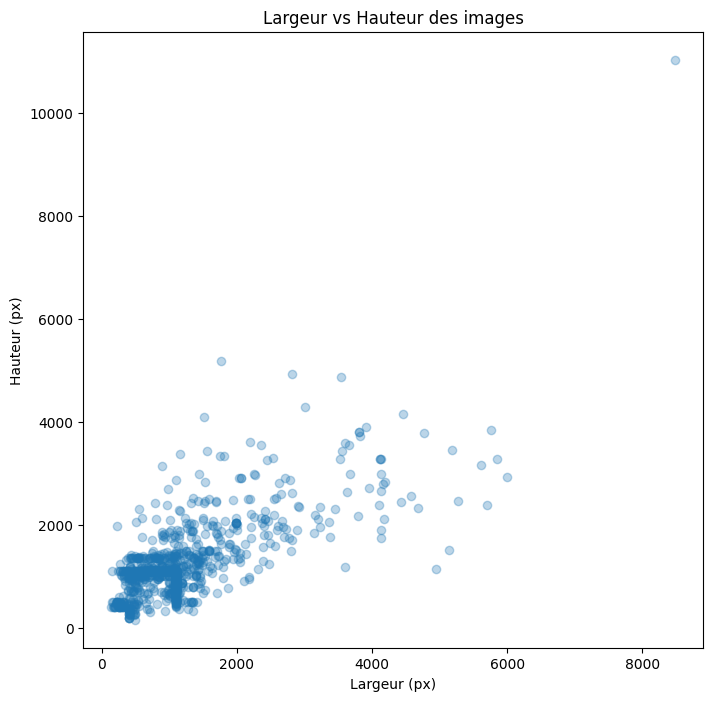

In [97]:
plt.figure(figsize=(8,8))
plt.scatter(shapes_df['width'], shapes_df['height'], alpha=0.3)
plt.xlabel("Largeur (px)")
plt.ylabel("Hauteur (px)")
plt.title("Largeur vs Hauteur des images")
plt.show()

##### Analyse par catégorie

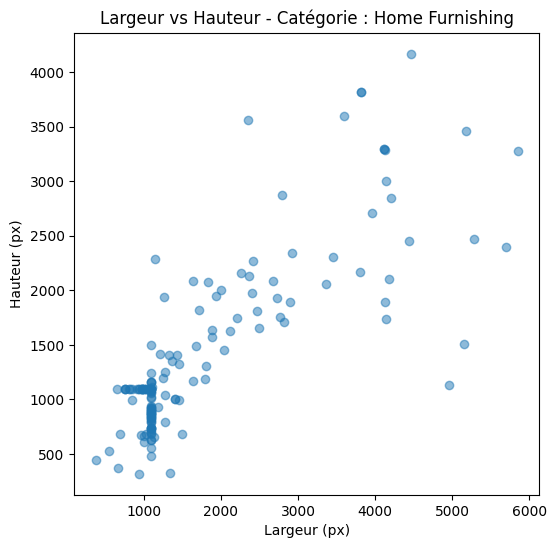

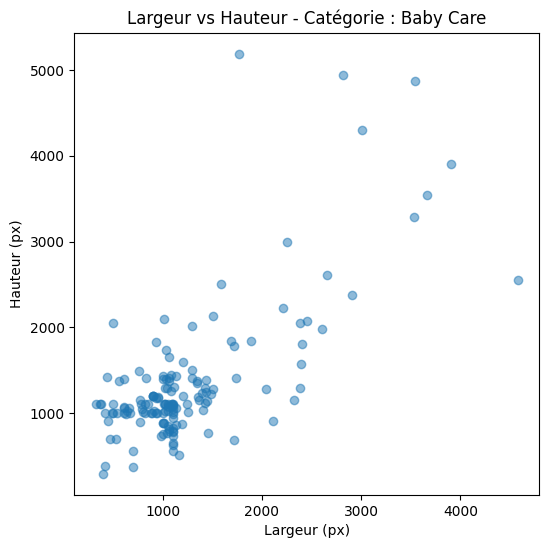

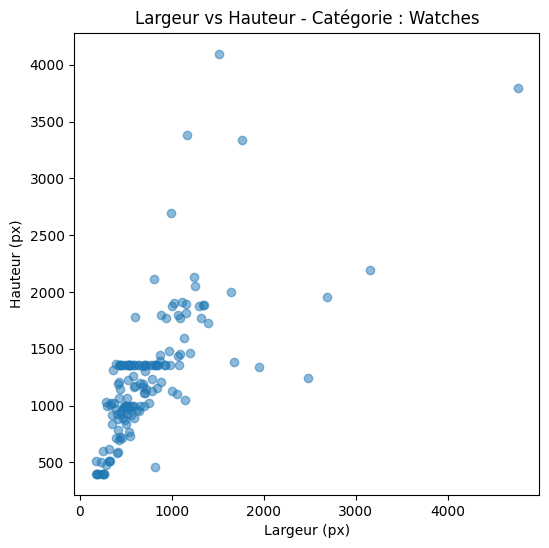

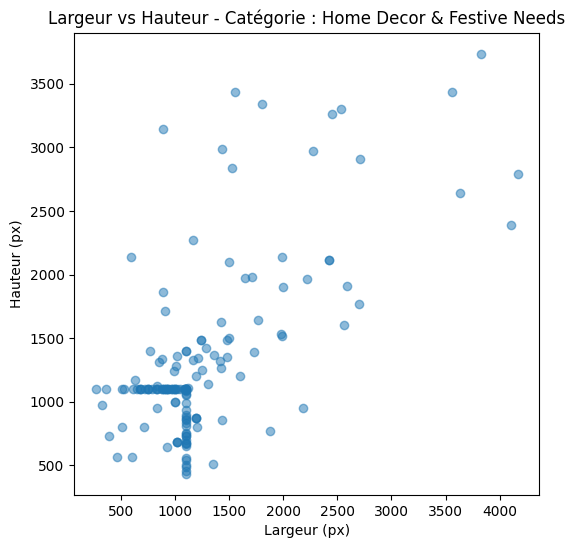

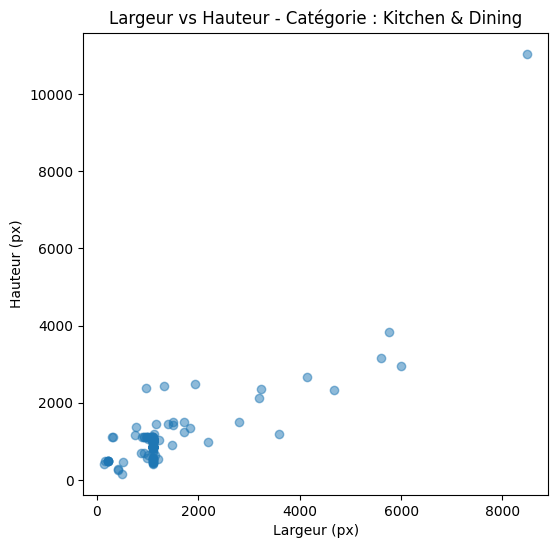

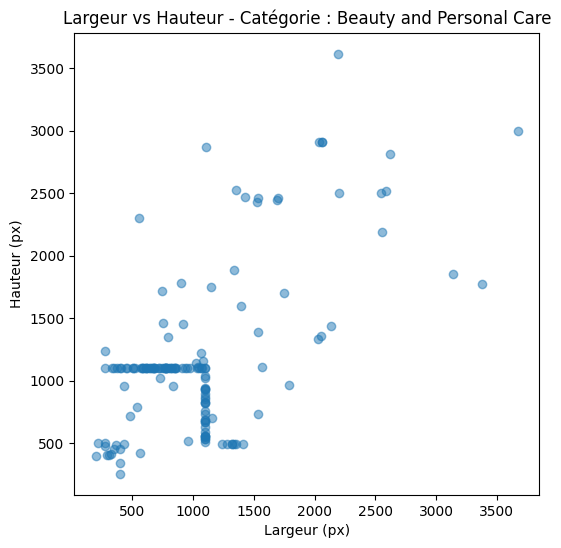

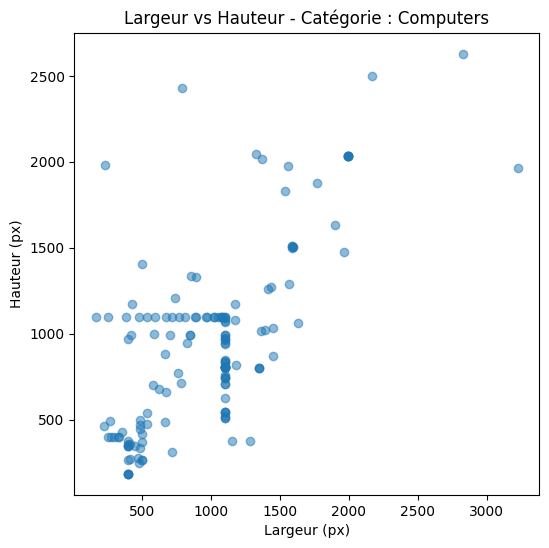

In [98]:
for cat in data['main_category'].unique():
    idx = data['main_category'] == cat
    plt.figure(figsize=(6,6))
    plt.scatter(shapes_df.loc[idx, 'width'], shapes_df.loc[idx, 'height'], alpha=0.5)
    plt.xlabel("Largeur (px)")
    plt.ylabel("Hauteur (px)")
    plt.title(f"Largeur vs Hauteur - Catégorie : {cat}")
    plt.show()

##### Images non standards

In [99]:
small_width = 100
small_height = 100
large_width = 1000
large_height = 1000
elongated_ratio_high = 2
elongated_ratio_low = 0.5

nb_tres_petites = shapes_df[(shapes_df['width'] < small_width) | (shapes_df['height'] < small_height)].shape[0]
nb_tres_grandes = shapes_df[(shapes_df['width'] > large_width) | (shapes_df['height'] > large_height)].shape[0]
nb_tres_allongees = shapes_df[(shapes_df['ratio'] > elongated_ratio_high) | (shapes_df['ratio'] < elongated_ratio_low)].shape[0]

print(f"Nombre d'images très petites (<{small_width}px ou <{small_height}px) : {nb_tres_petites}")
print(f"Nombre d'images très grandes (>{large_width}px ou >{large_height}px) : {nb_tres_grandes}")
print(f"Nombre d'images très allongées (ratio > {elongated_ratio_high} ou < {elongated_ratio_low}) : {nb_tres_allongees}")

Nombre d'images très petites (<100px ou <100px) : 0
Nombre d'images très grandes (>1000px ou >1000px) : 872
Nombre d'images très allongées (ratio > 2 ou < 0.5) : 180


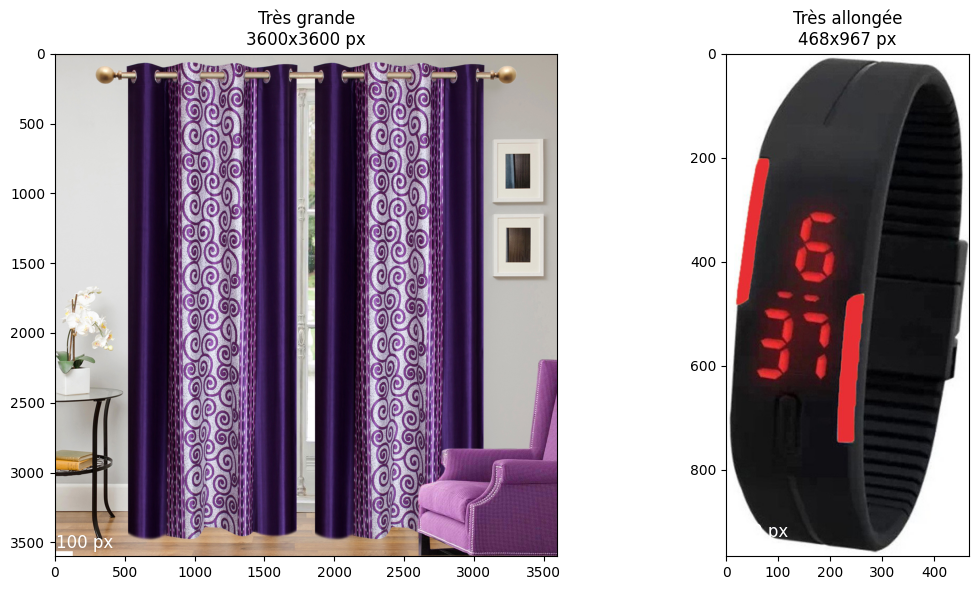

In [100]:
# Exemple d'image très grande
idx_grande = shapes_df[(shapes_df['width'] > 1000) | (shapes_df['height'] > 1000)].index[0]
img_path_grande = data.loc[idx_grande, 'image_path']
img_grande = Image.open(os.path.join('images', img_path_grande))

# Exemple d'image très allongée
idx_allongee = shapes_df[(shapes_df['ratio'] > 2) | (shapes_df['ratio'] < 0.5)].index[0]
img_path_allongee = data.loc[idx_allongee, 'image_path']
img_allongee = Image.open(os.path.join('images', img_path_allongee))

# Affichage côte à côte avec échelle
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

axes[0].imshow(img_grande)
axes[0].set_title(f"Très grande\n{img_grande.size[0]}x{img_grande.size[1]} px")
axes[0].axis('on')

axes[1].imshow(img_allongee)
axes[1].set_title(f"Très allongée\n{img_allongee.size[0]}x{img_allongee.size[1]} px")
axes[1].axis('on')

# Ajout d'une barre d'échelle (exemple : 100px)
for ax, img in zip(axes, [img_grande, img_allongee]):
    width = img.size[0]
    ax.plot([10, 110], [img.size[1] - 20, img.size[1] - 20], color='white', linewidth=4)
    ax.text(10, img.size[1] - 30, '100 px', color='white', fontsize=12, va='bottom')

plt.tight_layout()
plt.show()

##### Nombre d’images par catégorie

In [101]:
print(data['main_category'].value_counts())

main_category
Home Furnishing               150
Baby Care                     150
Watches                       150
Home Decor & Festive Needs    150
Kitchen & Dining              150
Beauty and Personal Care      150
Computers                     150
Name: count, dtype: int64


##### Visualisation d’exemples par catégorie

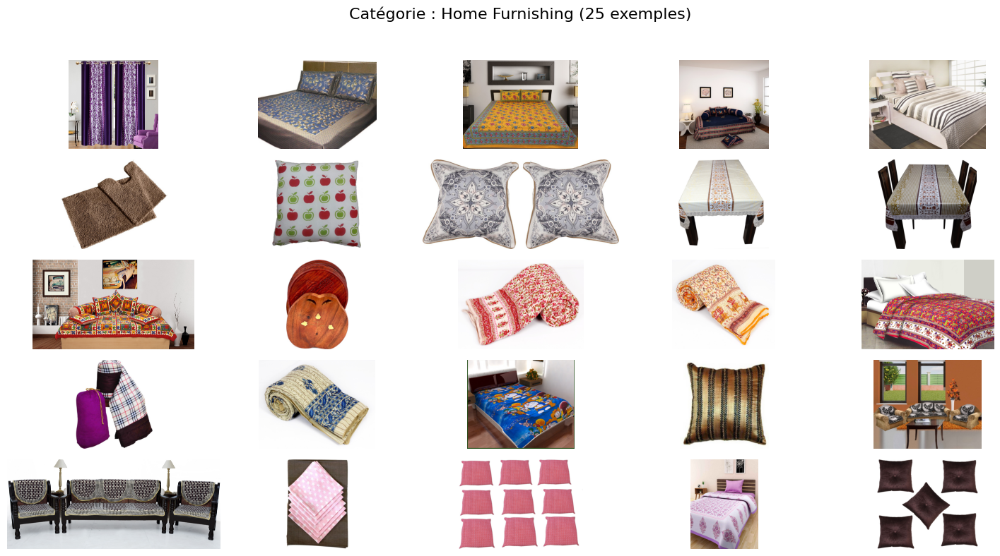

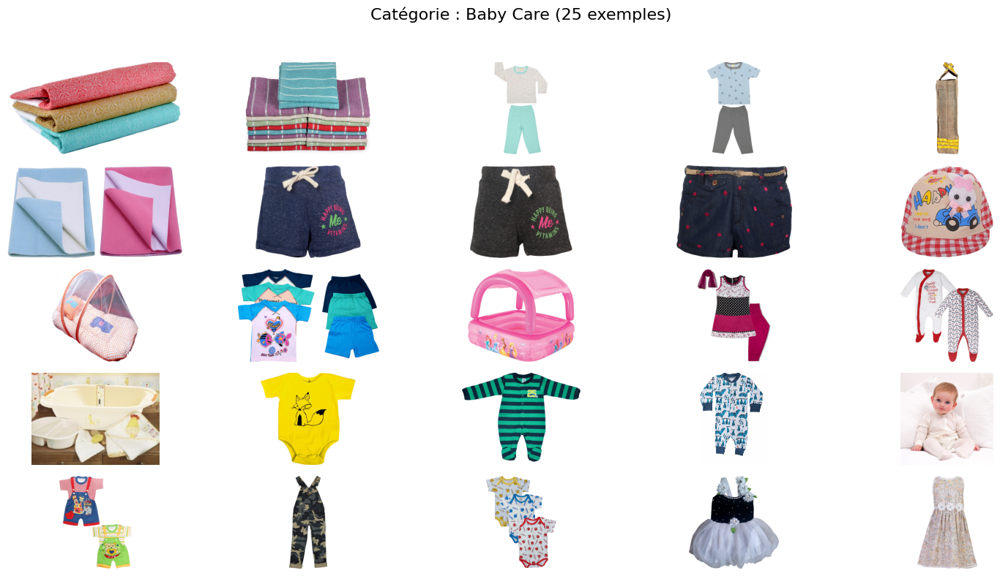

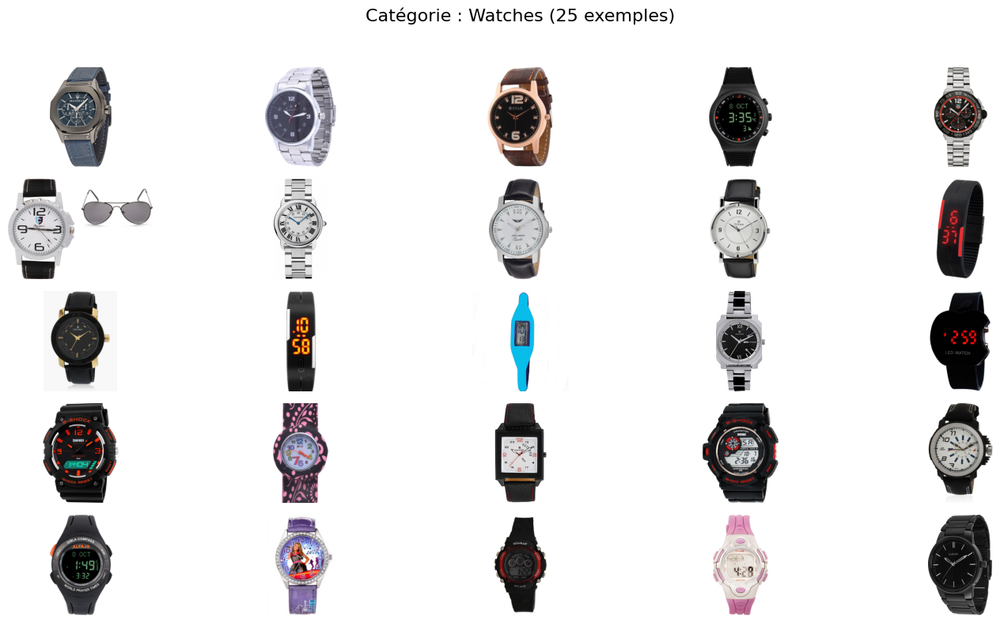

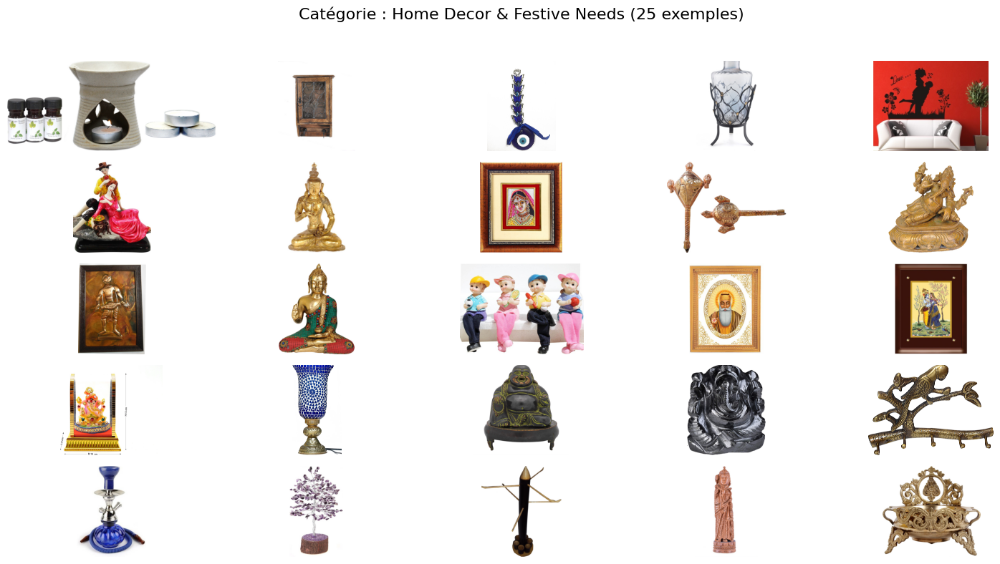

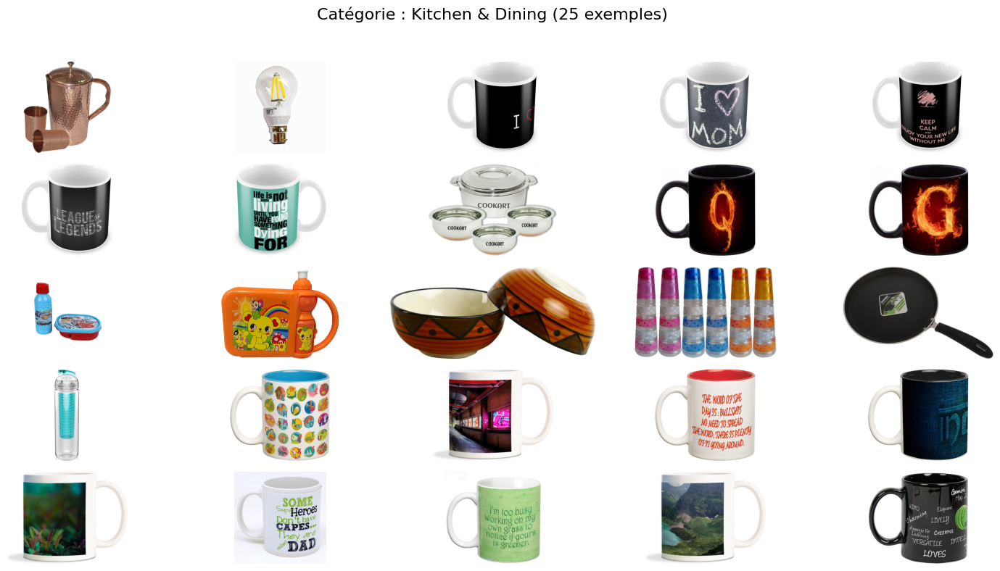

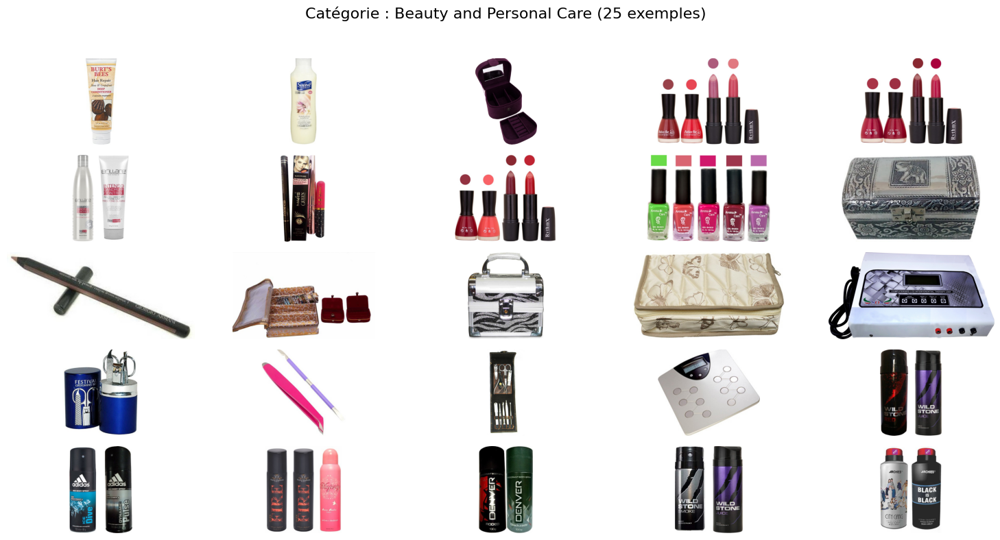

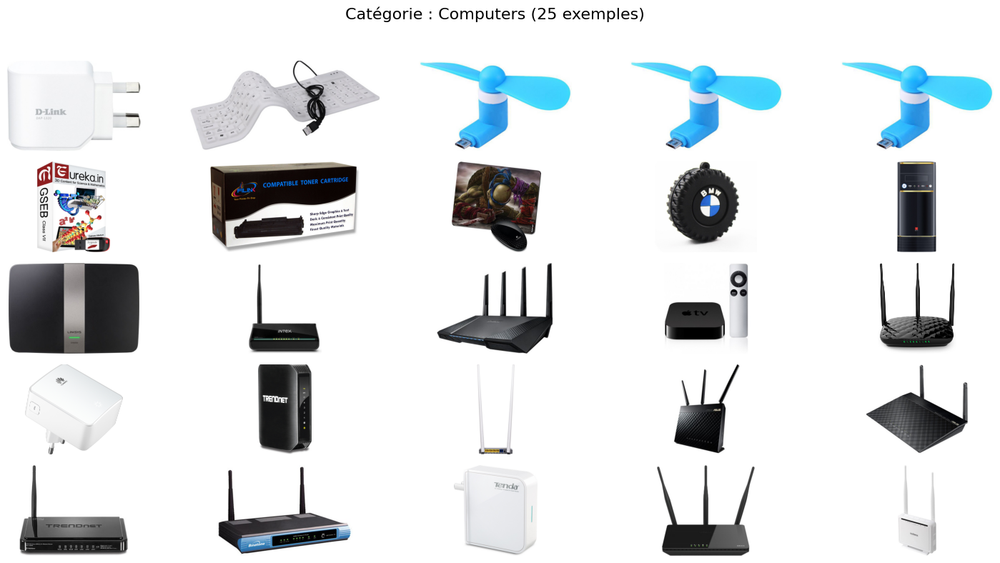

In [102]:
import matplotlib.pyplot as plt
from PIL import Image
import os

categories = data['main_category'].unique()

for cat in categories:
    subset = data[data['main_category'] == cat].head(25)
    plt.figure(figsize=(15, 8))
    plt.suptitle(f"Catégorie : {cat} (25 exemples)", fontsize=16)
    for i, (_, row) in enumerate(subset.iterrows()):
        try:
            img = Image.open(os.path.join('images', row['image_path']))
            plt.subplot(5, 5, i + 1)
            plt.imshow(img)
            plt.axis('off')
        except Exception as e:
            continue
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

## 6.2  Prétraitement des images

In [103]:
# Choisir une image exemple
path_images = "/Users/jadesuchaud/Documents/images/"
list_photos = os.listdir(path_images)
img_path = path_images + list_photos[1]

# 1. Image initiale (couleur)
image1 = cv2.imread(img_path)

# 2. Image convertie en niveaux de gris
image2 = cv2.imread(img_path, 0)  # ou cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)

# 3. Image égalisée (contraste)
image3 = cv2.equalizeHist(image2)

# 4. Image débruitée (filtre gaussien)
image4 = cv2.GaussianBlur(image3, (5, 5), 0)

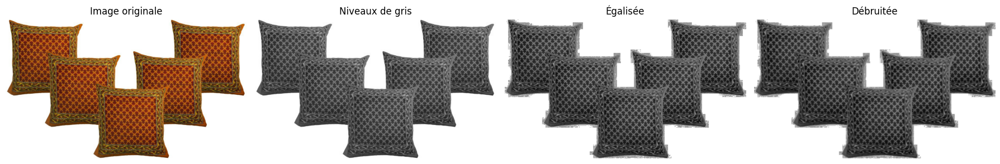

In [104]:
# Affichage comparatif
fig, axs = plt.subplots(1, 4, figsize=(18, 5))
axs[0].imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
axs[0].set_title("Image originale")
axs[1].imshow(image2, cmap='gray')
axs[1].set_title("Niveaux de gris")
axs[2].imshow(image3, cmap='gray')
axs[2].set_title("Égalisée")
axs[3].imshow(image4, cmap='gray')
axs[3].set_title("Débruitée")
for ax in axs:
    ax.axis('off')
plt.tight_layout()
plt.show()

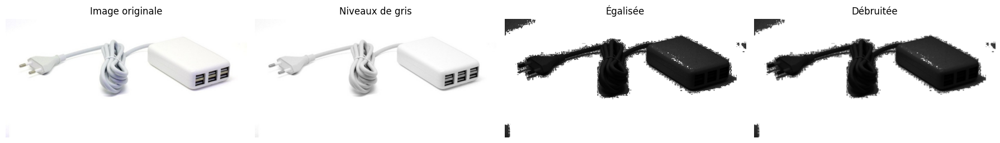

In [105]:
# Choisir une autre image
path_images = "/Users/jadesuchaud/Documents/images/"
list_photos = sorted(os.listdir(path_images))
img_path = path_images + list_photos[6]  

# 1. Image initiale (couleur)
image1 = cv2.imread(img_path)

# 2. Image convertie en niveaux de gris
image2 = cv2.imread(img_path, 0)

# 3. Image égalisée (contraste)
image3 = cv2.equalizeHist(image2)

# 4. Image débruitée (filtre gaussien)
image4 = cv2.GaussianBlur(image3, (5, 5), 0)

# Affichage comparatif
fig, axs = plt.subplots(1, 4, figsize=(18, 5))
axs[0].imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
axs[0].set_title("Image originale")
axs[1].imshow(image2, cmap='gray')
axs[1].set_title("Niveaux de gris")
axs[2].imshow(image3, cmap='gray')
axs[2].set_title("Égalisée")
axs[3].imshow(image4, cmap='gray')
axs[3].set_title("Débruitée")
for ax in axs:
    ax.axis('off')
plt.tight_layout()
plt.show()

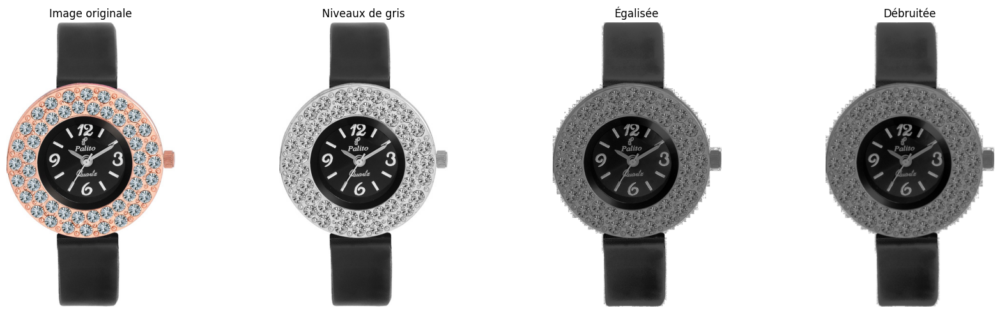

In [141]:
# Choisir une autre image
path_images = "/Users/jadesuchaud/Documents/images/"
list_photos = sorted(os.listdir(path_images))
img_path = path_images + list_photos[0]  

# 1. Image initiale (couleur)
image1 = cv2.imread(img_path)

# 2. Image convertie en niveaux de gris
image2 = cv2.imread(img_path, 0)

# 3. Image égalisée (contraste)
image3 = cv2.equalizeHist(image2)

# 4. Image débruitée (filtre gaussien)
image4 = cv2.GaussianBlur(image3, (5, 5), 0)

# Affichage comparatif
fig, axs = plt.subplots(1, 4, figsize=(18, 5))
axs[0].imshow(cv2.cvtColor(image1, cv2.COLOR_BGR2RGB))
axs[0].set_title("Image originale")
axs[1].imshow(image2, cmap='gray')
axs[1].set_title("Niveaux de gris")
axs[2].imshow(image3, cmap='gray')
axs[2].set_title("Égalisée")
axs[3].imshow(image4, cmap='gray')
axs[3].set_title("Débruitée")
for ax in axs:
    ax.axis('off')
plt.tight_layout()
plt.show()

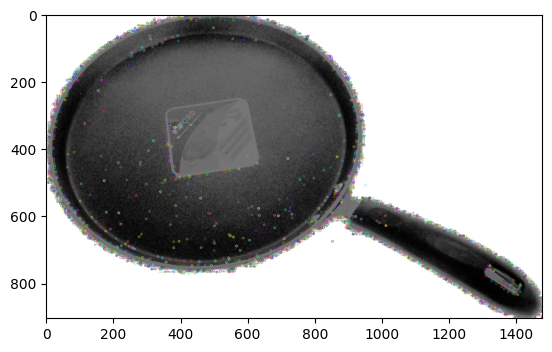

Descripteurs :  (1702, 128)



In [106]:
sift = cv2.SIFT_create()
image = cv2.imread(path_images+list_photos[1],0)
image = cv2.equalizeHist(image)
image = cv2.GaussianBlur(image, (5, 5), 0)
kp, des = sift.detectAndCompute(image, None)
img=cv2.drawKeypoints(image,kp,image)
plt.imshow(img)
plt.show()
print("Descripteurs : ", des.shape)
print()

Nous testons et affichons tout d'abord avec 1 image. On constate que l'image contient 1 702 descripteurs et chaque descripteur est un vecteur de longueur 128.

Nous allons maintenant l'appliquer à chaque image. Nous transformons chacune d'entre elles et créons une liste de descripteurs par image ainsi qu'une liste de descripteur pour l'ensemble des images.

In [107]:
sift_keypoints = []
temps1=time.time()
sift = cv2.SIFT_create()

for image_num in range(len(data['image'])) :
    image = cv2.imread(path_images+data['image'][image_num],0)
    # image = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    image = cv2.equalizeHist(image)
    image = cv2.GaussianBlur(image, (5, 5), 0)
    kp, des = sift.detectAndCompute(image, None)
    sift_keypoints.append(des)

sift_keypoints_img = np.asarray(sift_keypoints, dtype=object)
sift_keypoints_all = np.concatenate(sift_keypoints_img, axis=0)

print("Nombre de descripteurs : ", sift_keypoints_all.shape)

temps2 = np.round(time.time()-temps1, 2)
print("Temps de traitement : {} secondes".format(temps2))

Nombre de descripteurs :  (6679584, 128)
Temps de traitement : 349.28 secondes


Nous obtenons 6 679 584 descripteurs pour 1 050 images

In [108]:
sift_keypoints_img  # liste de tableaux de descripteurs par image (longueur = nb images)
sift_keypoints_all  # tableau concaténé de tous les descripteurs (shape = [nb_total_descripteurs, 128])

array([[  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  3.,   0.,   0., ...,   4.,   1.,  11.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       ...,
       [117., 117.,   5., ...,   0.,   0.,   8.],
       [ 24.,  27.,  31., ...,   0.,   0.,  13.],
       [  0.,   0.,   1., ...,   0.,   0.,   4.]], dtype=float32)

## 6.3 Extraction de features avec SIFT 

La méthode SIFT (Scale-Invariant Feature Transform) est une technique qui permet de détecter des points d'intérêt dans une image et de les décrire de manière robuste et invariante à l'échelle.

Nous allons créer des fonctions de transformation pour préparer tes images avant l’extraction de features (SIFT, etc.).

Cela permet de :
- Appliquer facilement différentes chaînes de prétraitement,
- Comparer l’impact de chaque transformation sur la qualité des features et des clusters,
- Réutiliser le code pour tout notre dataset.

##### Définir les fonctions de prétraitement et d’extraction SIFT

In [109]:
def to_gray(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

def equalize(img_gray):
    return cv2.equalizeHist(img_gray)

def denoise(img_gray):
    return cv2.GaussianBlur(img_gray, (5, 5), 0)

def preprocess_pipeline(img, to_gray_=True, equalize_=False, denoise_=False):
    if to_gray_:
        img = to_gray(img)
    if equalize_:
        img = equalize(img)
    if denoise_:
        img = denoise(img)
    return img

In [110]:
def extract_sift_features(img):
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(img, None)
    return descriptors

In [111]:
# Utilisation de toutes les images du dataset
data_sift = data.reset_index(drop=True)

##### Définir les pipelines de prétraitement

In [112]:
pipelines = {
    "Couleur": dict(to_gray_=False, equalize_=False, denoise_=False),
    "Niveaux de gris": dict(to_gray_=True, equalize_=False, denoise_=False),
    "Gris + contraste": dict(to_gray_=True, equalize_=True, denoise_=False),
    "Gris + contraste + débruitage": dict(to_gray_=True, equalize_=True, denoise_=True),
}

##### Boucle principale de comparaison


=== Pipeline : Couleur ===
Descripteurs extraits : (5977632, 128)
Shape BoVW : (1050, 100)


/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


ARI : 0.073 | Temps : 306.0s | Dim. init : 100 | Dim. PCA : 30


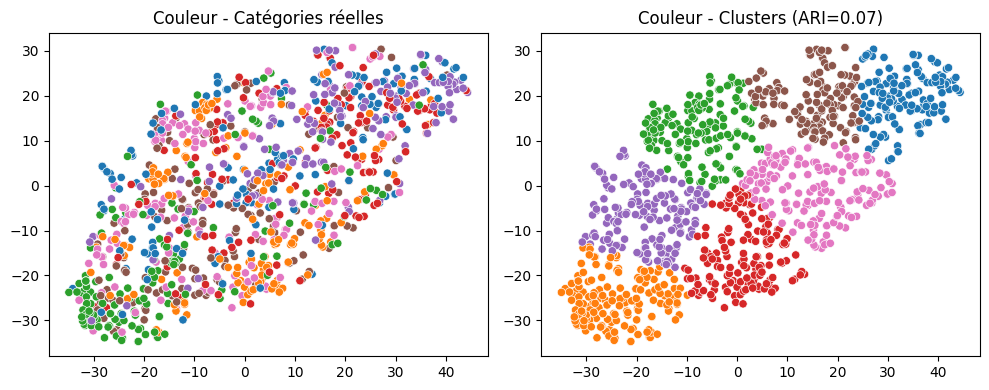


=== Pipeline : Niveaux de gris ===
Descripteurs extraits : (5977632, 128)
Shape BoVW : (1050, 100)


/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


ARI : 0.077 | Temps : 275.5s | Dim. init : 100 | Dim. PCA : 30


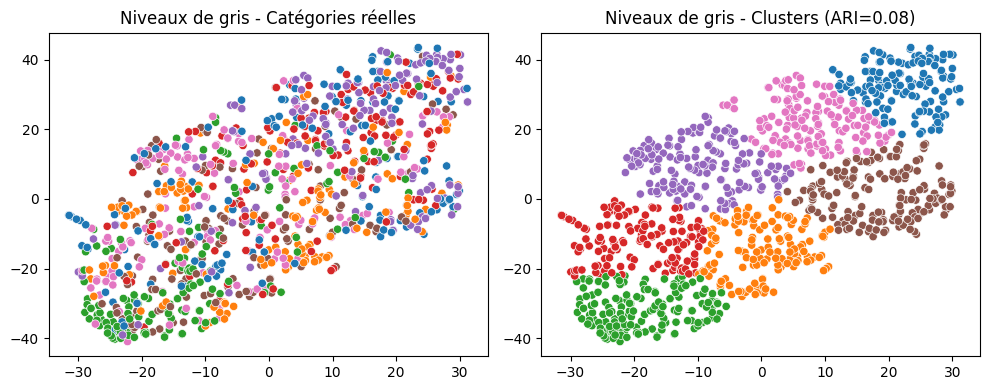


=== Pipeline : Gris + contraste ===
Descripteurs extraits : (9061414, 128)
Shape BoVW : (1050, 100)


/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


ARI : 0.056 | Temps : 342.3s | Dim. init : 100 | Dim. PCA : 30


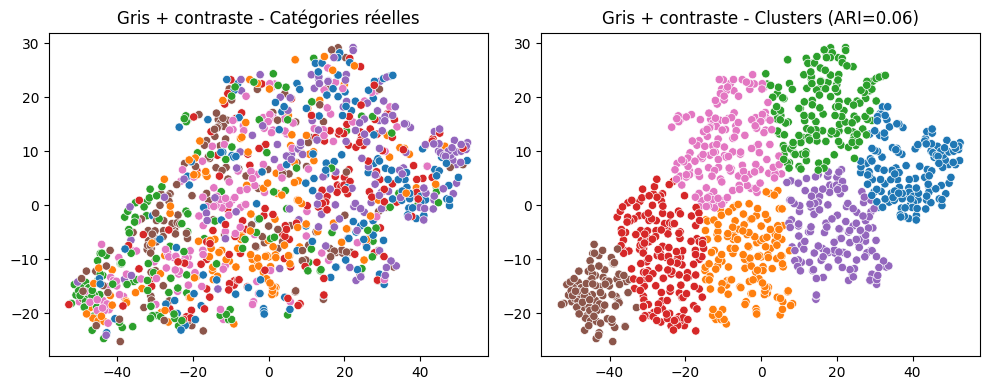


=== Pipeline : Gris + contraste + débruitage ===
Descripteurs extraits : (6592543, 128)
Shape BoVW : (1050, 100)


/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


ARI : 0.072 | Temps : 291.1s | Dim. init : 100 | Dim. PCA : 30


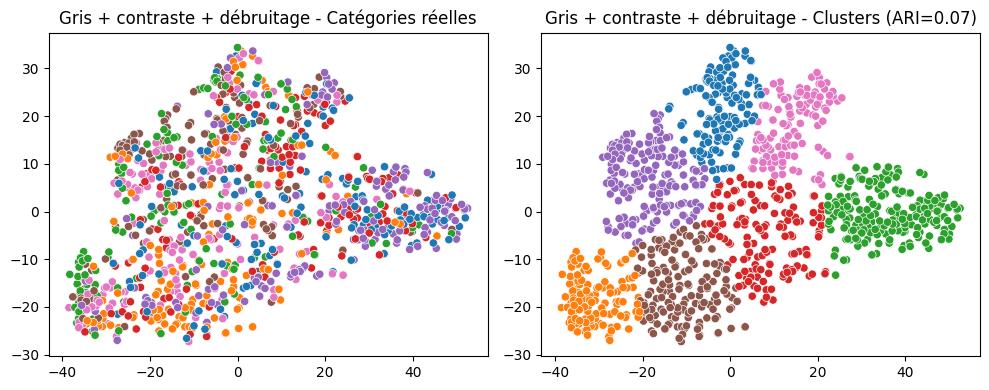

In [113]:
# =========================
# 1. INITIALISATION DES STOCKAGES POUR LES RÉSULTATS SIFT
# =========================
sift_results = {}
embeddings_dict = {}
labels_dict = {}
clusters_dict = {}

# =========================
# 2. PIPELINE DE TRAITEMENT PAR PRETRAITEMENT SIFT
# =========================
for name, params in pipelines.items():
    print(f"\n=== Pipeline : {name} ===")
    import time
    start = time.time()
    
    # 1. Extraction SIFT pour chaque image
    sift_descriptors_list = []
    for img_path in data_sift['image_path']:
        img = cv2.imread(img_path)
        img_prep = preprocess_pipeline(img, **params)
        des = extract_sift_features(img_prep)
        if des is not None:
            sift_descriptors_list.append(des.astype(np.float64))
        else:
            sift_descriptors_list.append(np.zeros((1,128), dtype=np.float64))
    all_descriptors = np.vstack(sift_descriptors_list).astype(np.float64)
    print("Descripteurs extraits :", all_descriptors.shape)
    
    # 2. Sous-échantillonnage pour MiniBatchKMeans
    max_samples = 50_000
    if all_descriptors.shape[0] > max_samples:
        idx = np.random.choice(all_descriptors.shape[0], max_samples, replace=False)
        descriptors_sample = all_descriptors[idx]
    else:
        descriptors_sample = all_descriptors
    
    # 3. Construction du vocabulaire visuel
    n_clusters = 100
    mbk = MiniBatchKMeans(n_clusters=n_clusters, batch_size=1000, random_state=42)
    mbk.fit(descriptors_sample)
    
    # 4. Codage BoVW de chaque image
    bovw_features = []
    for des in sift_descriptors_list:
        if des is not None:
            words = mbk.predict(des.astype(np.float64))
            hist, _ = np.histogram(words, bins=np.arange(n_clusters+1))
        else:
            hist = np.zeros(n_clusters)
        bovw_features.append(hist)
    bovw_features = np.array(bovw_features)
    print("Shape BoVW :", bovw_features.shape)
    dim_init = bovw_features.shape[1]
    
    # 5. Réduction de dimension (PCA puis t-SNE)
    pca = PCA(n_components=30, random_state=42)
    bovw_pca = pca.fit_transform(bovw_features)
    dim_pca = bovw_pca.shape[1]
    tsne = TSNE(n_components=2, perplexity=30, n_iter=1000, random_state=42)
    bovw_tsne = tsne.fit_transform(bovw_pca)
    
    # 6. Clustering et ARI
    kmeans = KMeans(n_clusters=len(data_sift['main_category'].unique()), n_init=20, random_state=42)
    cluster_labels = kmeans.fit_predict(bovw_tsne)
    le = LabelEncoder()
    y_true = le.fit_transform(data_sift['main_category'])
    ari = adjusted_rand_score(y_true, cluster_labels)
    elapsed_time = time.time() - start
    print(f"ARI : {ari:.3f} | Temps : {elapsed_time:.1f}s | Dim. init : {dim_init} | Dim. PCA : {dim_pca}")
    
    # 7. Stockage pour visualisation ultérieure et tableau récapitulatif
    embeddings_dict[name] = bovw_tsne
    labels_dict[name] = y_true
    clusters_dict[name] = cluster_labels
    sift_results[name] = {
        "ARI": ari,
        "Temps (s)": elapsed_time,
        "Dim. initiale": dim_init,
        "Dim. PCA": dim_pca
    }
    
    # 8. Visualisation t-SNE immédiate (optionnel)
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    sns.scatterplot(x=bovw_tsne[:,0], y=bovw_tsne[:,1], hue=y_true, palette='tab10', legend=False)
    plt.title(f'{name} - Catégories réelles')
    plt.subplot(1,2,2)
    sns.scatterplot(x=bovw_tsne[:,0], y=bovw_tsne[:,1], hue=cluster_labels, palette='tab10', legend=False)
    plt.title(f'{name} - Clusters (ARI={ari:.2f})')
    plt.tight_layout()
    plt.show()
    
    # 9. Libération de la mémoire
    del sift_descriptors_list, all_descriptors, descriptors_sample, bovw_features, bovw_pca, bovw_tsne
    gc.collect()

## 6.4 Comparaison et synthèse des traitements d'images basiques

##### Tableau récapitulatif et export

In [114]:
sift_results_df = pd.DataFrame(sift_results).T
sift_results_df.to_csv('results_sift_comparatif.csv')
display(sift_results_df)

,ARI,Temps (s),Dim. initiale,Dim. PCA
Couleur,0.073269,306.042755,100.0,30.0
Niveaux de gris,0.076652,275.456316,100.0,30.0
Gris + contraste,0.056157,342.274237,100.0,30.0
Gris + contraste + débruitage,0.072156,291.080730,100.0,30.0


Les scores ARI sont très faibles dans toutes les pipelines. Le pipeline SIFT/BoVW, même optimisé, ne permet pas de regrouper efficacement les catégories de ton dataset. Il faut envisager des méthodes plus avancées pour améliorer la séparation.

##### Visualisation des métriques

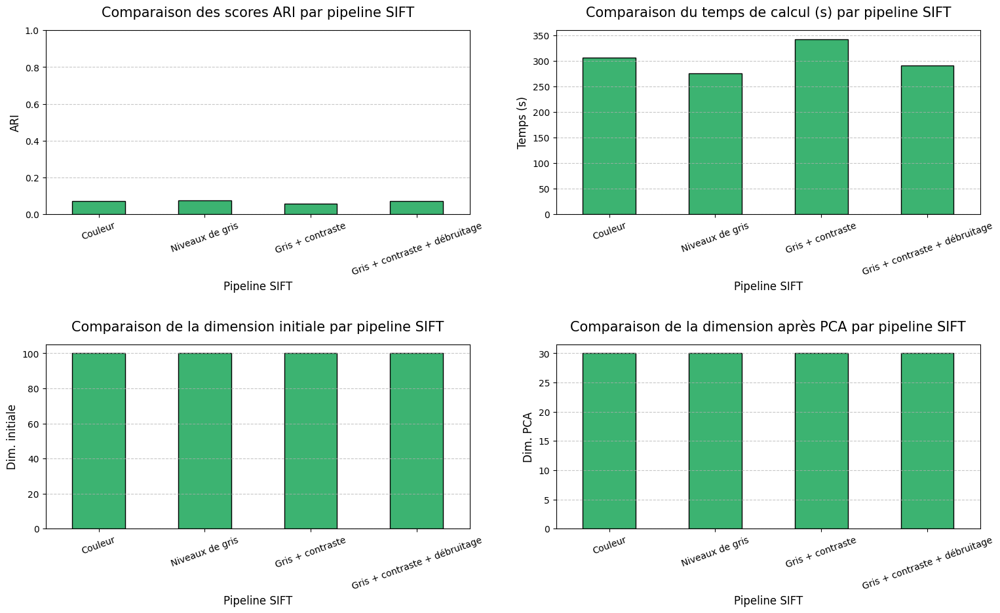

In [115]:
metrics = ['ARI', 'Temps (s)', 'Dim. initiale', 'Dim. PCA']
titles = [
    "Comparaison des scores ARI par pipeline SIFT",
    "Comparaison du temps de calcul (s) par pipeline SIFT",
    "Comparaison de la dimension initiale par pipeline SIFT",
    "Comparaison de la dimension après PCA par pipeline SIFT"
]

main_color = "mediumseagreen"  

fig, axes = plt.subplots(2, 2, figsize=(16, 10))
axes = axes.flatten()

for i, metric in enumerate(metrics):
    sift_results_df[metric].plot(
        kind='bar',
        color=main_color,
        ax=axes[i],
        edgecolor='black'
    )
    axes[i].set_title(titles[i], fontsize=15, pad=15)
    axes[i].set_xlabel("Pipeline SIFT", fontsize=12)
    axes[i].set_ylabel(metric, fontsize=12)
    axes[i].tick_params(axis='x', rotation=20)
    if metric == 'ARI':
        axes[i].set_ylim(0, 1)
    axes[i].grid(axis='y', linestyle='--', alpha=0.7)

plt.tight_layout(pad=3.0)
plt.show()

##### Matrice de confusion clusters vs catégories

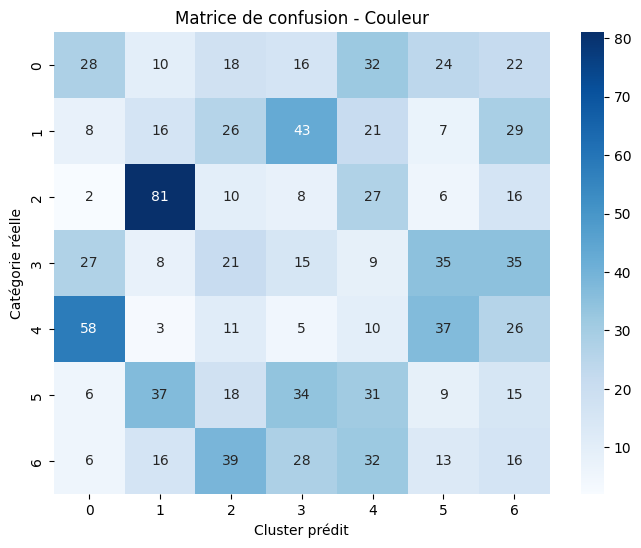

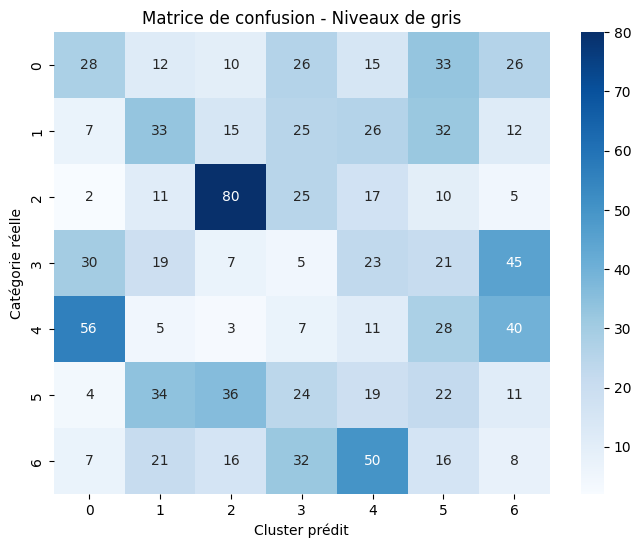

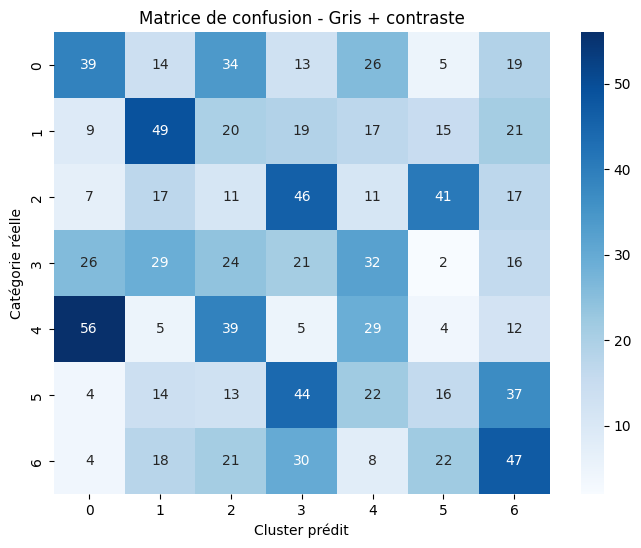

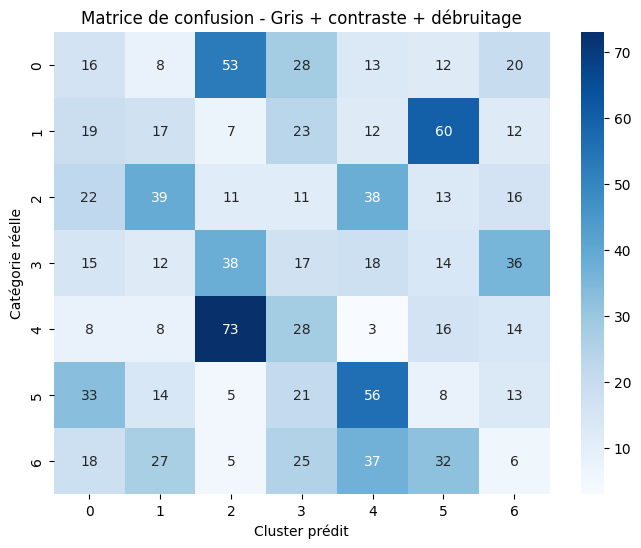

In [116]:
for pipeline_name in embeddings_dict.keys():
    y_true = labels_dict[pipeline_name]
    cluster_labels = clusters_dict[pipeline_name]
    cm = confusion_matrix(y_true, cluster_labels)
    plt.figure(figsize=(8,6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.xlabel("Cluster prédit")
    plt.ylabel("Catégorie réelle")
    plt.title(f"Matrice de confusion - {pipeline_name}")
    plt.show()

In [132]:
def show_misclustered_images(data, y_true, cluster_labels, pipeline_name, n=6):
    # Trouve les indices où la catégorie réelle ≠ cluster prédit
    errors = (y_true != cluster_labels)
    idx_errors = np.where(errors)[0]
    print(f"{pipeline_name} – Nombre d’images mal clusterisées : {len(idx_errors)}")
    if len(idx_errors) == 0:
        print("Aucune image mal clusterisée.")
        return
    # Affiche n exemples
    plt.figure(figsize=(15, 3))
    for i, idx in enumerate(idx_errors[:n]):
        img_path = data.iloc[idx]['image_path']
        img = Image.open(img_path)
        plt.subplot(1, n, i+1)
        plt.imshow(img)
        plt.axis('off')
        plt.title(f"Réel: {y_true[idx]}\nCluster: {cluster_labels[idx]}")
    plt.suptitle(f"Exemples d’images mal clusterisées – {pipeline_name}")
    plt.tight_layout()
    plt.show()

SIFT - Couleur – Nombre d’images mal clusterisées : 946


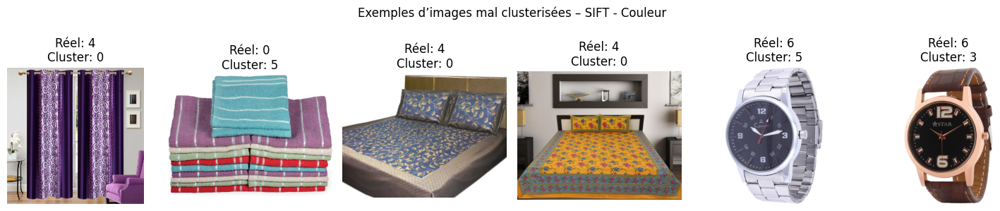

SIFT - Niveaux de gris – Nombre d’images mal clusterisées : 863


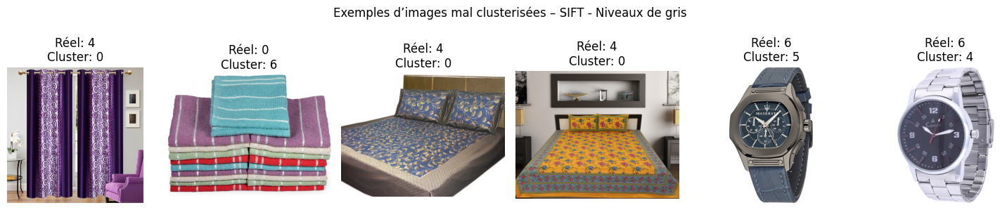

SIFT - Gris + contraste – Nombre d’images mal clusterisées : 838


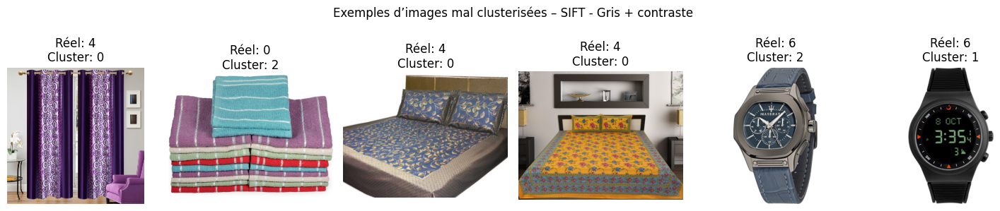

SIFT - Gris + contraste + débruitage – Nombre d’images mal clusterisées : 972


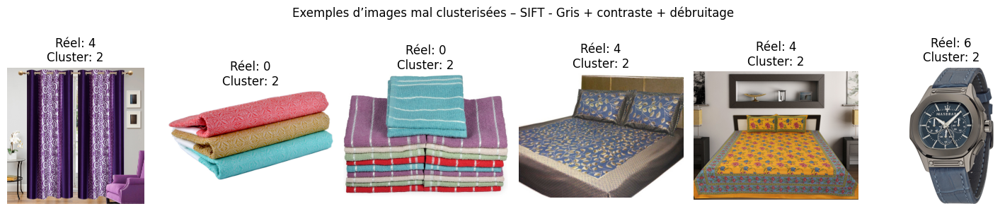

In [133]:
# Appel pour chaque pipeline SIFT
for pipeline_name in embeddings_dict.keys():
    y_true = labels_dict[pipeline_name]
    cluster_labels = clusters_dict[pipeline_name]
    show_misclustered_images(data_sift, y_true, cluster_labels, f"SIFT - {pipeline_name}")

# Étape 4 : Faisabilité classification – Image avancée (CNN Transfer Learning)
Objectif :
- Tester si les features extraits par un réseau de neurones pré-entraîné (CNN, ex : ResNet50) permettent de regrouper automatiquement les articles de même catégorie à partir de leur image.
- Comparer les résultats avec les méthodes basiques (SIFT/BoVW).

## 7.1 Prétraitement d'image pour CNN

In [117]:
def to_gray(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

def equalize(img_gray):
    return cv2.equalizeHist(img_gray)

def denoise(img_gray):
    return cv2.GaussianBlur(img_gray, (5, 5), 0)

def preprocess_pipeline_cnn(img, to_gray_=True, equalize_=False, denoise_=False):
    # Pour CNN, il faut retourner une image 3 canaux (RGB)
    if to_gray_:
        img = to_gray(img)
        if equalize_:
            img = equalize(img)
        if denoise_:
            img = denoise(img)
        img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    else:
        if equalize_ or denoise_:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
            if equalize_:
                img = equalize(img)
            if denoise_:
                img = denoise(img)
            img = cv2.cvtColor(img, cv2.COLOR_GRAY2BGR)
    return img

## 7.2 Définition des pipelines de prétraitement à tester

In [118]:
cnn_pipelines = {
    "Couleur": dict(to_gray_=False, equalize_=False, denoise_=False),
    "Niveaux de gris": dict(to_gray_=True, equalize_=False, denoise_=False),
    "Gris + contraste": dict(to_gray_=True, equalize_=True, denoise_=False),
    "Gris + contraste + débruitage": dict(to_gray_=True, equalize_=True, denoise_=True),
}

In [119]:
# Utilisation de toutes les images du dataset
data_cnn = data.reset_index(drop=True)

## 7.3 Boucle principale sur les pipelines CNN


=== Pipeline CNN : Couleur ===


/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


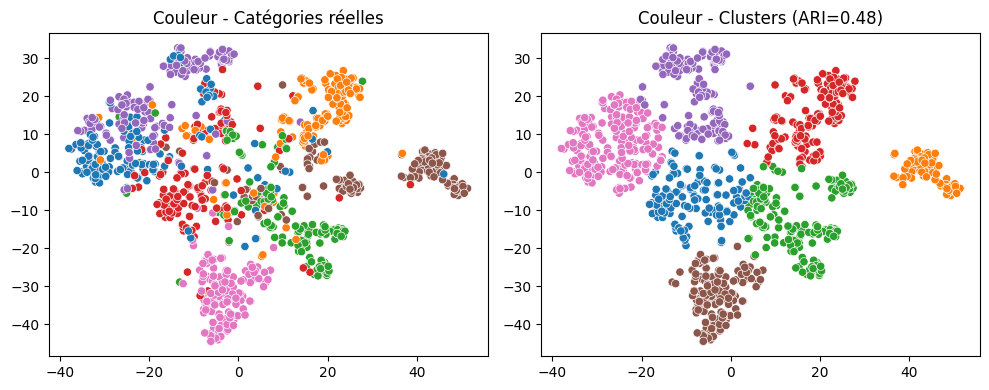

ARI : 0.477304 | Temps : 41.02s | Dim. init : 2048 | Dim. PCA : 30

=== Pipeline CNN : Niveaux de gris ===


/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


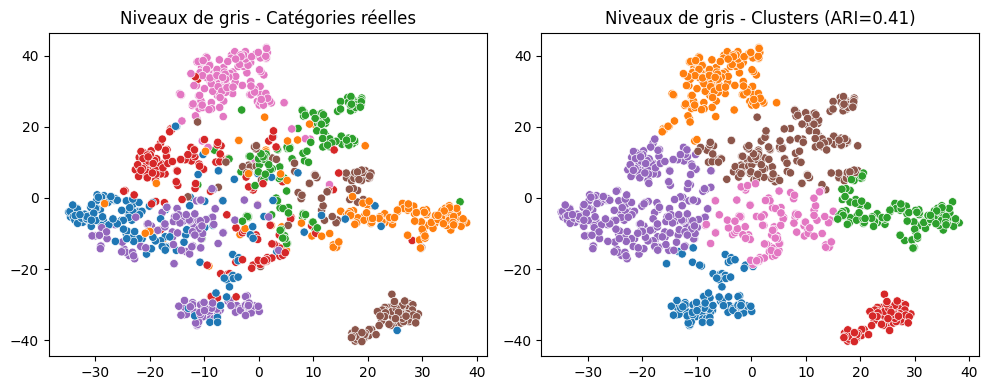

ARI : 0.405238 | Temps : 40.91s | Dim. init : 2048 | Dim. PCA : 30

=== Pipeline CNN : Gris + contraste ===


/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


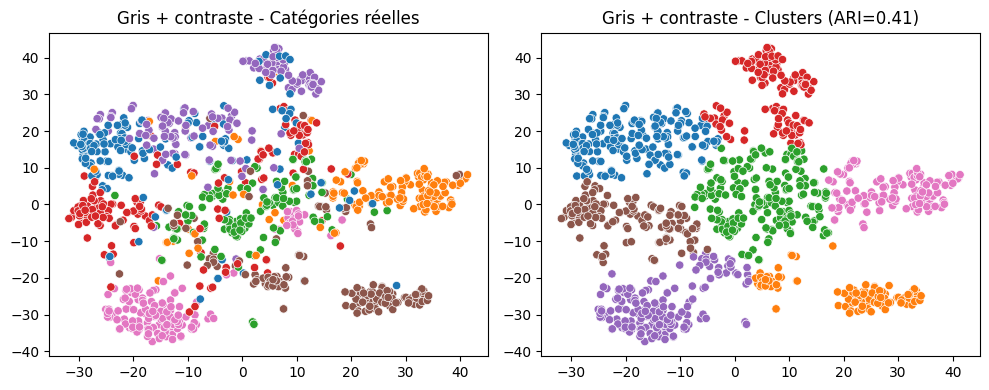

ARI : 0.413574 | Temps : 42.68s | Dim. init : 2048 | Dim. PCA : 30

=== Pipeline CNN : Gris + contraste + débruitage ===


/opt/anaconda3/lib/python3.11/site-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


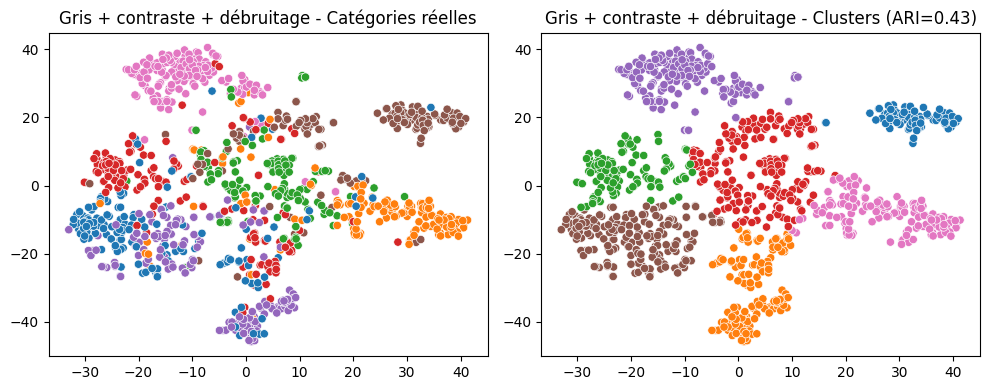

ARI : 0.425331 | Temps : 43.01s | Dim. init : 2048 | Dim. PCA : 30


In [120]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.preprocessing.image import img_to_array
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.preprocessing import LabelEncoder

cnn_results = {}
cnn_embeddings_dict = {}
cnn_labels_dict = {}
cnn_clusters_dict = {}

for name, params in cnn_pipelines.items():
    print(f"\n=== Pipeline CNN : {name} ===")
    start = time.time()
    X_imgs = []
    for img_path in data_cnn['image_path']:
        img = cv2.imread(img_path)
        img = preprocess_pipeline_cnn(img, **params)
        img = cv2.resize(img, (224, 224))
        img = img_to_array(img)
        img = preprocess_input(img)
        X_imgs.append(img)
    X_imgs = np.array(X_imgs)
    
    # Extraction features CNN
    base_model = ResNet50(weights='imagenet', include_top=False, pooling='avg')
    features_cnn = base_model.predict(X_imgs, batch_size=16, verbose=0)
    dim_init = features_cnn.shape[1]
    
    # PCA puis t-SNE
    pca = PCA(n_components=30, random_state=42)
    features_cnn_pca = pca.fit_transform(features_cnn)
    dim_pca = features_cnn_pca.shape[1]
    tsne = TSNE(n_components=2, perplexity=30, n_iter=1000, random_state=42)
    features_cnn_tsne = tsne.fit_transform(features_cnn_pca)
    
    # Clustering et ARI
    le = LabelEncoder()
    y_true = le.fit_transform(data_cnn['main_category'])
    kmeans = KMeans(n_clusters=len(np.unique(y_true)), n_init=20, random_state=42)
    cluster_labels = kmeans.fit_predict(features_cnn_tsne)
    ari = adjusted_rand_score(y_true, cluster_labels)
    elapsed_time = time.time() - start
    
    # Stockage
    cnn_embeddings_dict[name] = features_cnn_tsne
    cnn_labels_dict[name] = y_true
    cnn_clusters_dict[name] = cluster_labels
    cnn_results[name] = {
        "ARI": ari,
        "Temps (s)": elapsed_time,
        "Dim. initiale": dim_init,
        "Dim. PCA": dim_pca
    }
    
    # Visualisation t-SNE 
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)
    sns.scatterplot(x=features_cnn_tsne[:,0], y=features_cnn_tsne[:,1], hue=y_true, palette='tab10', legend=False)
    plt.title(f'{name} - Catégories réelles')
    plt.subplot(1,2,2)
    sns.scatterplot(x=features_cnn_tsne[:,0], y=features_cnn_tsne[:,1], hue=cluster_labels, palette='tab10', legend=False)
    plt.title(f'{name} - Clusters (ARI={ari:.2f})')
    plt.tight_layout()
    plt.show()
    
    print(f"ARI : {ari:.6f} | Temps : {elapsed_time:.2f}s | Dim. init : {dim_init} | Dim. PCA : {dim_pca}")

In [121]:
cnn_results_df = pd.DataFrame(cnn_results).T
cnn_results_df.to_csv('results_cnn_comparatif.csv')
display(cnn_results_df)

,ARI,Temps (s),Dim. initiale,Dim. PCA
Couleur,0.477304,41.018913,2048.0,30.0
Niveaux de gris,0.405238,40.907281,2048.0,30.0
Gris + contraste,0.413574,42.676973,2048.0,30.0
Gris + contraste + débruitage,0.425331,43.010043,2048.0,30.0


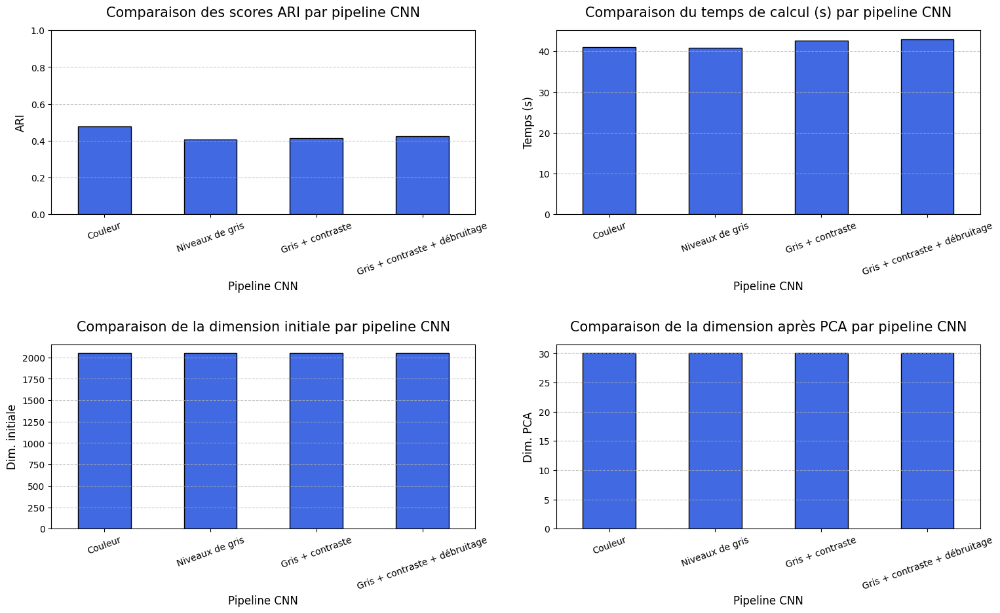

In [122]:
# === Visualisation comparative des pipelines CNN ===

metrics = ['ARI', 'Temps (s)', 'Dim. initiale', 'Dim. PCA']
titles = [
    "Comparaison des scores ARI par pipeline CNN",
    "Comparaison du temps de calcul (s) par pipeline CNN",
    "Comparaison de la dimension initiale par pipeline CNN",
    "Comparaison de la dimension après PCA par pipeline CNN"
]

main_color = "royalblue"
fig, axes = plt.subplots(2, 2, figsize=(16, 10))
axes = axes.flatten()
for i, metric in enumerate(metrics):
    cnn_results_df[metric].plot(
        kind='bar',
        color=main_color,
        ax=axes[i],
        edgecolor='black'
    )
    axes[i].set_title(titles[i], fontsize=15, pad=15)
    axes[i].set_xlabel("Pipeline CNN", fontsize=12)
    axes[i].set_ylabel(metric, fontsize=12)
    axes[i].tick_params(axis='x', rotation=20)
    if metric == 'ARI':
        axes[i].set_ylim(0, 1)
    axes[i].grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout(pad=3.0)
plt.show()

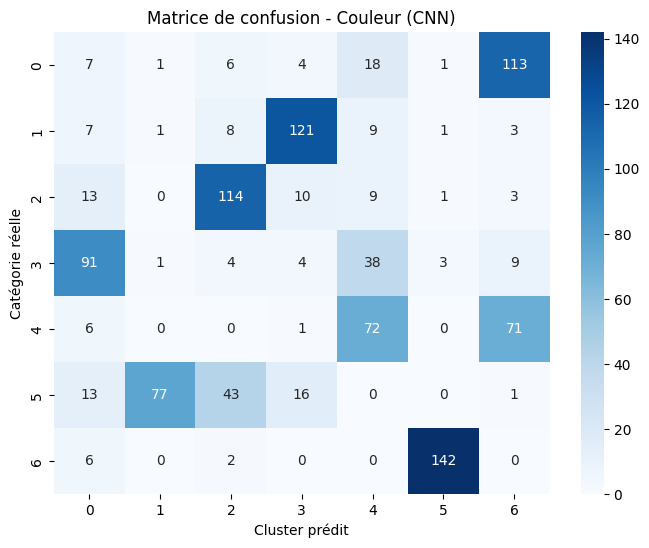

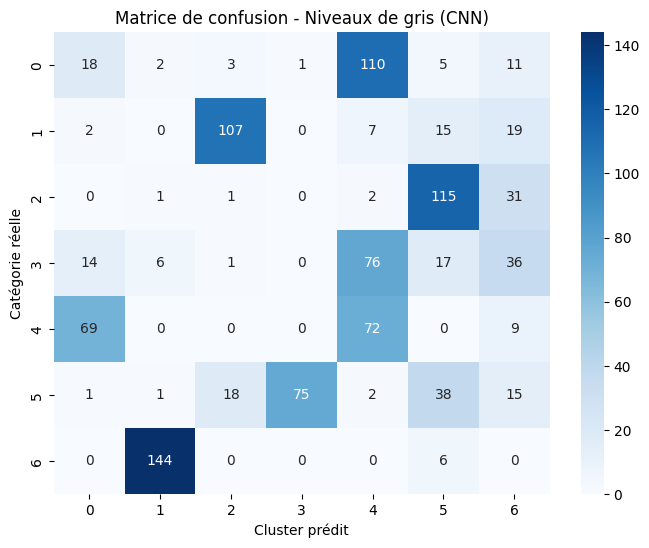

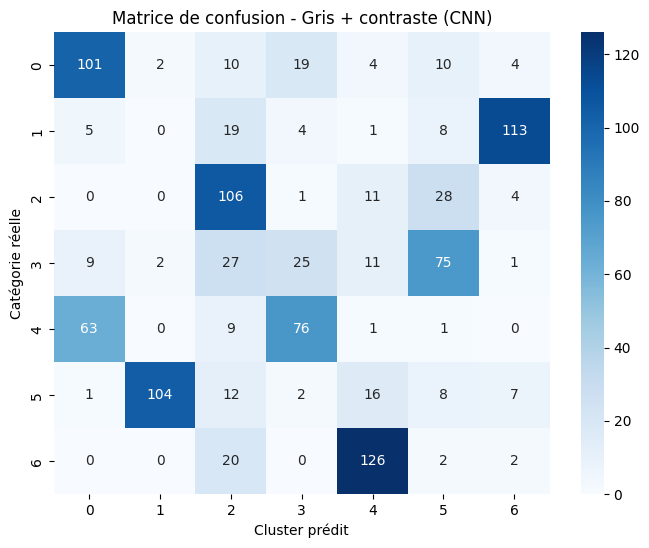

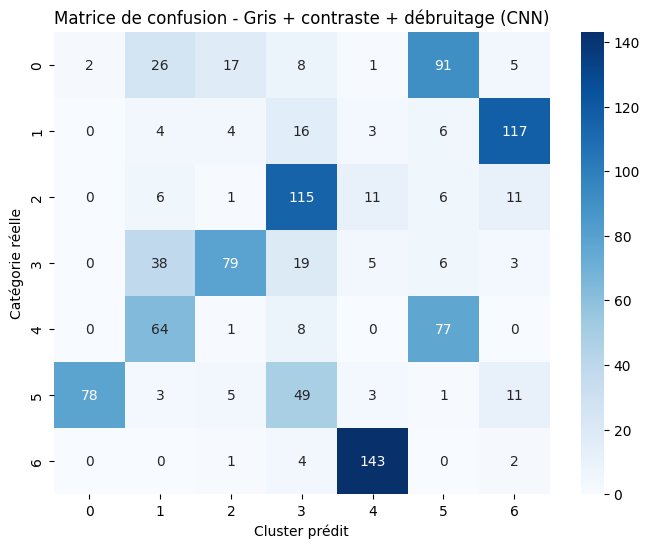

In [123]:
# Matrice de confusion clusters vs catégories pour chaque pipeline CNN 
for pipeline_name in cnn_embeddings_dict.keys():
    y_true = cnn_labels_dict[pipeline_name]
    cluster_labels = cnn_clusters_dict[pipeline_name]
    cm = confusion_matrix(y_true, cluster_labels)
    plt.figure(figsize=(8,6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.xlabel("Cluster prédit")
    plt.ylabel("Catégorie réelle")
    plt.title(f"Matrice de confusion - {pipeline_name} (CNN)")
    plt.show()

CNN - Couleur – Nombre d’images mal clusterisées : 852


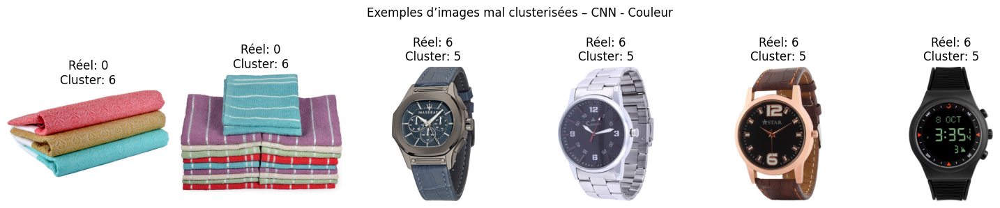

CNN - Niveaux de gris – Nombre d’images mal clusterisées : 921


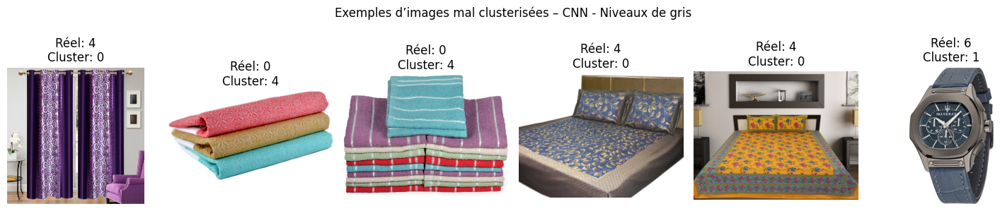

CNN - Gris + contraste – Nombre d’images mal clusterisées : 807


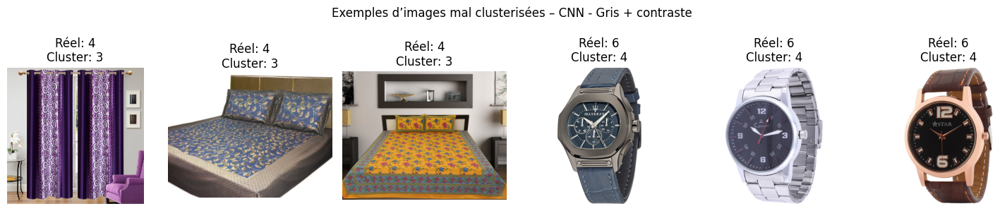

CNN - Gris + contraste + débruitage – Nombre d’images mal clusterisées : 1021


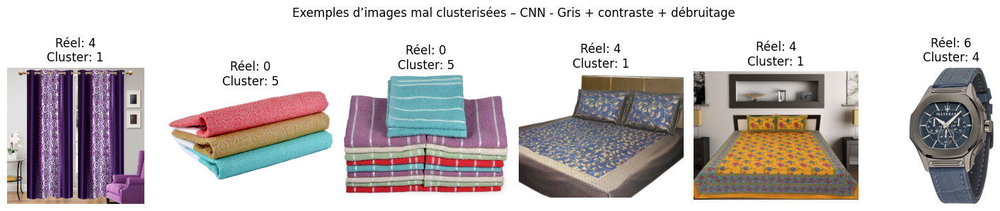

In [134]:
# Appel pour chaque pipeline CNN
for pipeline_name in cnn_embeddings_dict.keys():
    y_true = cnn_labels_dict[pipeline_name]
    cluster_labels = cnn_clusters_dict[pipeline_name]
    show_misclustered_images(data_cnn, y_true, cluster_labels, f"CNN - {pipeline_name}")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step


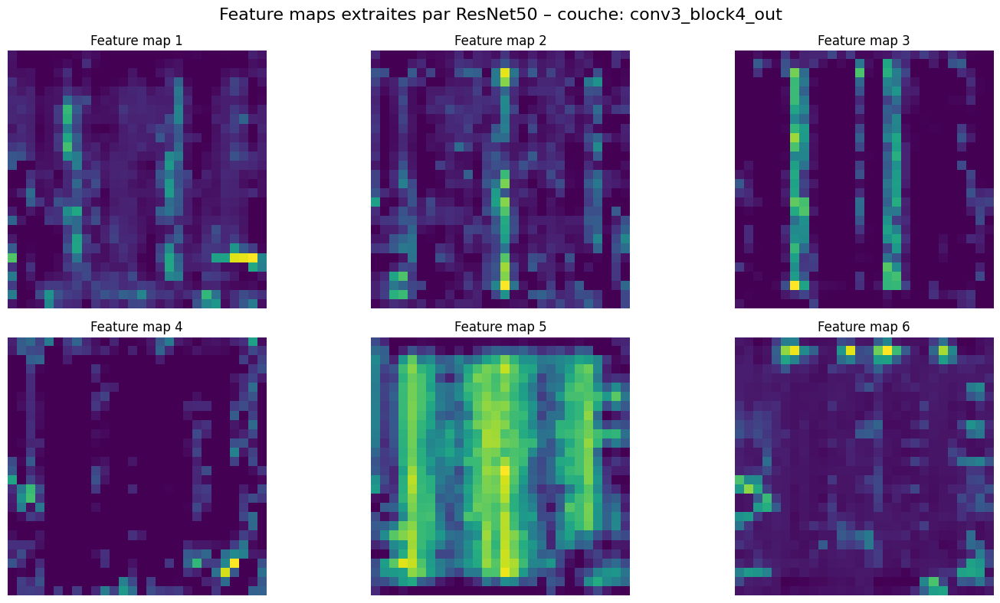

In [126]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt
import numpy as np

# 1. Charge une image d'exemple
img_path = data['image_path'].iloc[0] 
img = load_img(img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

# 2. Modèle ResNet50 jusqu'à une couche intermédiaire (ex: 'conv3_block4_out')
base_model = ResNet50(weights='imagenet', include_top=False)
layer_name = 'conv3_block4_out'  # tu peux changer pour voir d'autres couches
intermediate_layer_model = Model(inputs=base_model.input, outputs=base_model.get_layer(layer_name).output)

# 3. Prédire la feature map
feature_maps = intermediate_layer_model.predict(img_array)

# 4. Afficher quelques feature maps (par exemple les 6 premières)
plt.figure(figsize=(15, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    plt.imshow(feature_maps[0, :, :, i], cmap='viridis')
    plt.axis('off')
    plt.title(f'Feature map {i+1}')
plt.suptitle(f'Feature maps extraites par ResNet50 – couche: {layer_name}', fontsize=16)
plt.tight_layout()
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 288ms/step


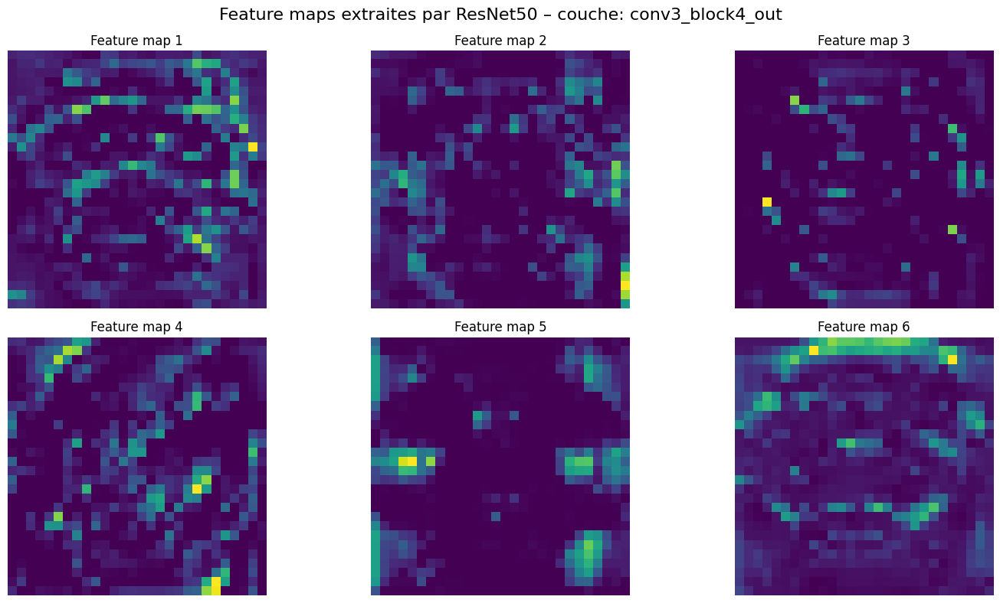

In [129]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.models import Model
import matplotlib.pyplot as plt
import numpy as np

# 1. Charge une image d'exemple
img_path = data['image_path'].iloc[20]  
img = load_img(img_path, target_size=(224, 224))
img_array = img_to_array(img)
img_array = np.expand_dims(img_array, axis=0)
img_array = preprocess_input(img_array)

# 2. Modèle ResNet50 jusqu'à une couche intermédiaire (ex: 'conv3_block4_out')
base_model = ResNet50(weights='imagenet', include_top=False)
layer_name = 'conv3_block4_out'  # tu peux changer pour voir d'autres couches
intermediate_layer_model = Model(inputs=base_model.input, outputs=base_model.get_layer(layer_name).output)

# 3. Prédire la feature map
feature_maps = intermediate_layer_model.predict(img_array)

# 4. Afficher quelques feature maps (par exemple les 6 premières)
plt.figure(figsize=(15, 8))
for i in range(6):
    plt.subplot(2, 3, i+1)
    plt.imshow(feature_maps[0, :, :, i], cmap='viridis')
    plt.axis('off')
    plt.title(f'Feature map {i+1}')
plt.suptitle(f'Feature maps extraites par ResNet50 – couche: {layer_name}', fontsize=16)
plt.tight_layout()
plt.show()


# 8. Comparaison et synthèse des classifications d'images 

In [130]:
sift_results_df = sift_results_df.copy()
sift_results_df['Méthode'] = 'SIFT'
cnn_results_df = cnn_results_df.copy()
cnn_results_df['Méthode'] = 'CNN'

# Index lisible pour l'affichage
sift_results_df['Pipeline complet'] = sift_results_df['Méthode'] + " - " + sift_results_df.index
cnn_results_df['Pipeline complet'] = cnn_results_df['Méthode'] + " - " + cnn_results_df.index

# Concatène
all_img_results_df = pd.concat([sift_results_df, cnn_results_df])

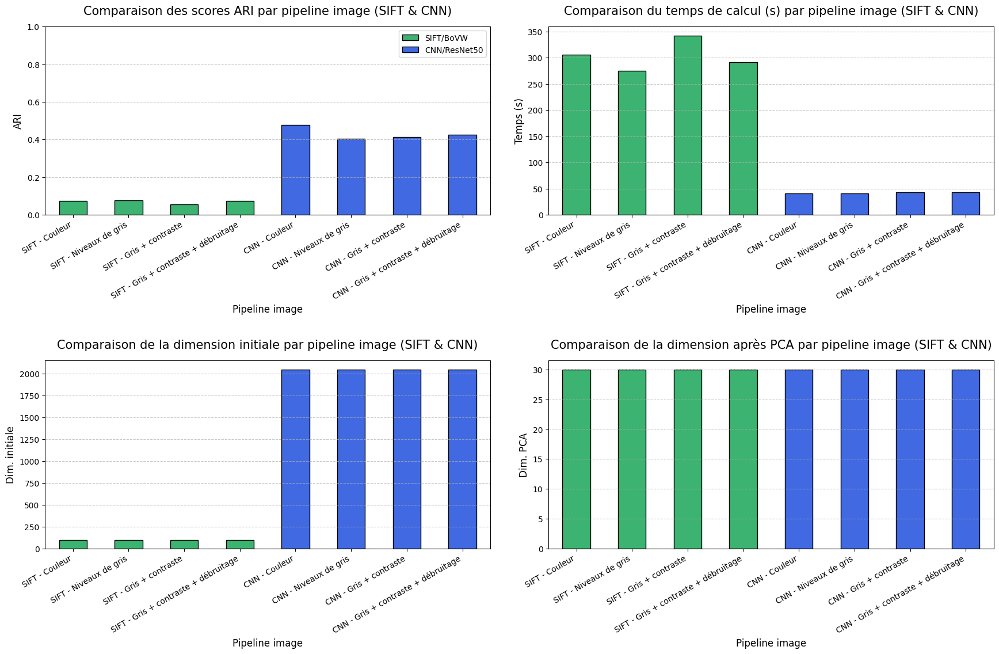

In [131]:
metrics = ['ARI', 'Temps (s)', 'Dim. initiale', 'Dim. PCA']
titles = [
    "Comparaison des scores ARI par pipeline image (SIFT & CNN)",
    "Comparaison du temps de calcul (s) par pipeline image (SIFT & CNN)",
    "Comparaison de la dimension initiale par pipeline image (SIFT & CNN)",
    "Comparaison de la dimension après PCA par pipeline image (SIFT & CNN)"
]

# Couleur différente pour SIFT et CNN
colors = all_img_results_df['Méthode'].map({'SIFT': 'mediumseagreen', 'CNN': 'royalblue'})

fig, axes = plt.subplots(2, 2, figsize=(18, 12))
axes = axes.flatten()

for i, metric in enumerate(metrics):
    all_img_results_df[metric].plot(
        kind='bar',
        color=colors,
        ax=axes[i],
        edgecolor='black'
    )
    axes[i].set_title(titles[i], fontsize=15, pad=15)
    axes[i].set_xlabel("Pipeline image", fontsize=12)
    axes[i].set_ylabel(metric, fontsize=12)
    axes[i].set_xticks(range(len(all_img_results_df)))
    axes[i].set_xticklabels(all_img_results_df['Pipeline complet'], rotation=30, ha='right')
    if metric == 'ARI':
        axes[i].set_ylim(0, 1)
    axes[i].grid(axis='y', linestyle='--', alpha=0.7)

# Légende personnalisée
from matplotlib.patches import Patch
legend_elements = [
    Patch(facecolor='mediumseagreen', edgecolor='black', label='SIFT/BoVW'),
    Patch(facecolor='royalblue', edgecolor='black', label='CNN/ResNet50')
]
axes[0].legend(handles=legend_elements, loc='best')

plt.tight_layout(pad=3.0)
plt.show()

##### Synthèse – Étude de faisabilité d’un moteur de classification d’articles

Dans ce premier livrable, nous avons mené une étude approfondie de la faisabilité d’un moteur de classification automatique d’articles pour la marketplace "Place de marché". L’objectif était d’évaluer, à partir des données disponibles (descriptions textuelles et images), la capacité à regrouper automatiquement les produits selon leur catégorie réelle.

**Résumé des étapes réalisées :**
- **Prétraitement des données texte** : Nettoyage, tokenisation, lemmatisation, stemming, suppression des stopwords et création de plusieurs versions des textes pour différents usages.
- **Extraction de features texte** : Mise en œuvre de méthodes classiques (Bag-of-Words, TF-IDF) puis avancées (Word2Vec, BERT, Universal Sentence Encoder), suivies de réductions de dimension (PCA, t-SNE) et de clustering (KMeans).
- **Analyse de la faisabilité NLP** : Les méthodes avancées d’embedding (BERT, USE) offrent une meilleure séparation des catégories que les approches classiques, mais la confusion subsiste pour certaines classes proches sémantiquement.
- **Prétraitement et analyse des images** : Étude des formats, tailles, ratios, et visualisation d’exemples par catégorie.
- **Extraction de features image** : Application de pipelines de prétraitement (niveaux de gris, égalisation, débruitage), extraction de descripteurs SIFT/BoVW, puis features via CNN (ResNet50, transfer learning).
- **Analyse de la faisabilité image** : Les méthodes CNN surpassent largement les approches classiques SIFT/BoVW pour regrouper les images par catégorie, même si la séparation n’est pas parfaite pour toutes les classes.
- **Synthèse comparative** : Les résultats montrent que l’utilisation de modèles avancés (embeddings pour le texte, CNN pour l’image) améliore significativement la capacité à regrouper les articles par catégorie, mais que la classification automatique reste un défi pour certaines catégories proches ou peu représentées.

**Conclusion**  
L’étude confirme la faisabilité d’un moteur de classification automatique basé sur les descriptions et les images, à condition d’utiliser des méthodes avancées de feature engineering et de réduction de dimension. Les résultats obtenus serviront de base pour la mise en place d’une classification supervisée dans la prochaine étape du projet.

---

##### Transition vers la suite du projet

Après cette étude de faisabilité, la prochaine étape consiste à **mettre en œuvre une classification supervisée d’images** à l’aide de réseaux de neurones (CNN) et de techniques d’augmentation de données, afin d’optimiser la performance du modèle sur notre jeu de données.  